# Ekstraksi Zoning 3 Zona dengan 405 Data

## Import Library 

In [16]:
import os
import cv2
import numpy as np
import math
import pandas as pd
from PIL import Image
from matplotlib import pyplot as plt
from skimage import io, color
import seaborn as sns

## Training

### Preprocessing

#### Load Data Training

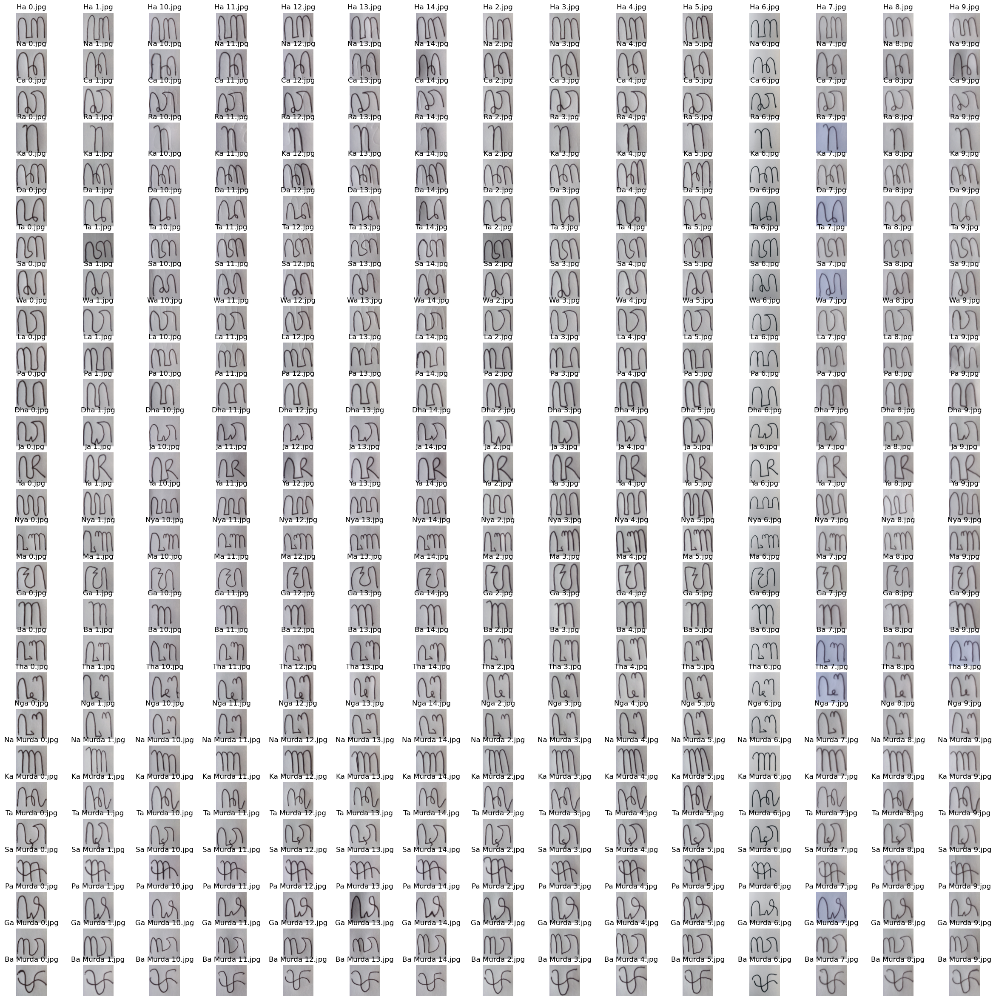

In [2]:
i = 0
k = 0
images = []
name = np.empty(405, dtype=object)
root_folder = 'Data Training 3'
subfolders = ['Ha', 'Na', 'Ca', 'Ra', 'Ka', 'Da', 'Ta', 'Sa', 'Wa', 
              'La', 'Pa', 'Dha', 'Ja','Ya', 'Nya', 'Ma', 'Ga', 'Ba', 
              'Tha', 'Nga', 'Na Murda', 'Ka Murda', 'Ta Murda', 'Sa Murda', 'Pa Murda', 'Ga Murda', 'Ba Murda']
fig, axs = plt.subplots(nrows = 27, ncols = 15, figsize = (30,30))
axs = axs.flatten()

for subfolder in subfolders:
    subfolder_path = os.path.join(root_folder, subfolder)
    
    for file in os.listdir(subfolder_path):
        if file.lower().endswith(('.jpg')):
            image_path = os.path.join(subfolder_path, file)
            image = Image.open(image_path)
            images.append(image)
            axs[i].imshow(image)
            axs[i].axis('off')
            filename = os.path.basename(file)
            name[i] = filename
            axs[i].set_title(filename)
            i += 1
            
plt.show() 

#### Resize Data Training

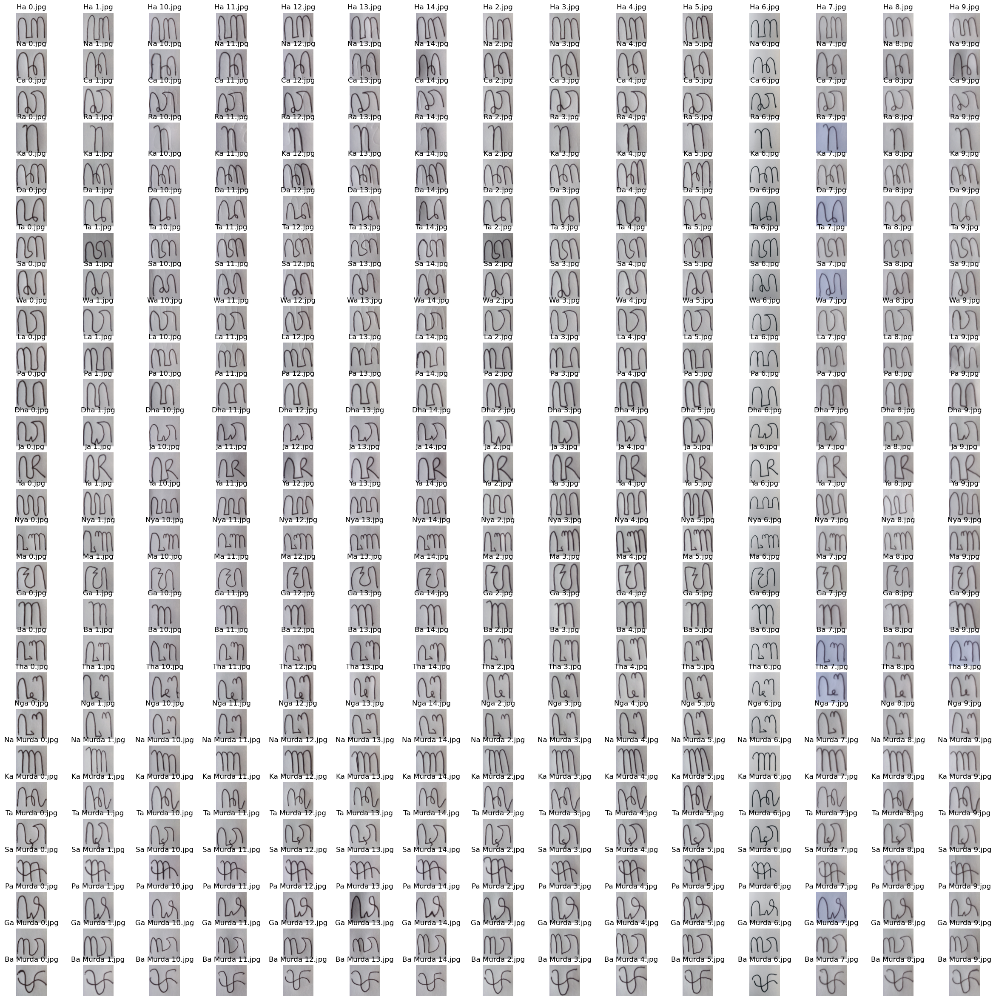

In [3]:
i = 0
resized_images = []
fig, axs = plt.subplots(nrows = 27, ncols = 15, figsize = (30,30))
axs = axs.flatten()

for image in images:
    resized_image = image.resize((120, 120))
    resized_images.append(resized_image)
    axs[i].imshow(image)
    axs[i].axis('off')
    axs[i].set_title(name[i])
    i += 1

plt.show()

#### Grayscale Data Training

In [4]:
grayscale_images = []
for image in resized_images:
    width, height = image.size
    grayscale_img = Image.new("L", (width, height))
        
    for x in range(width):
            
        for y in range(height):
            r, g, b = image.getpixel((x, y))
            brightness = int(0.2989 * r + 0.5870 * g + 0.1140 * b)
            grayscale_img.putpixel((x, y), brightness)
            
    grayscale_images.append(grayscale_img)

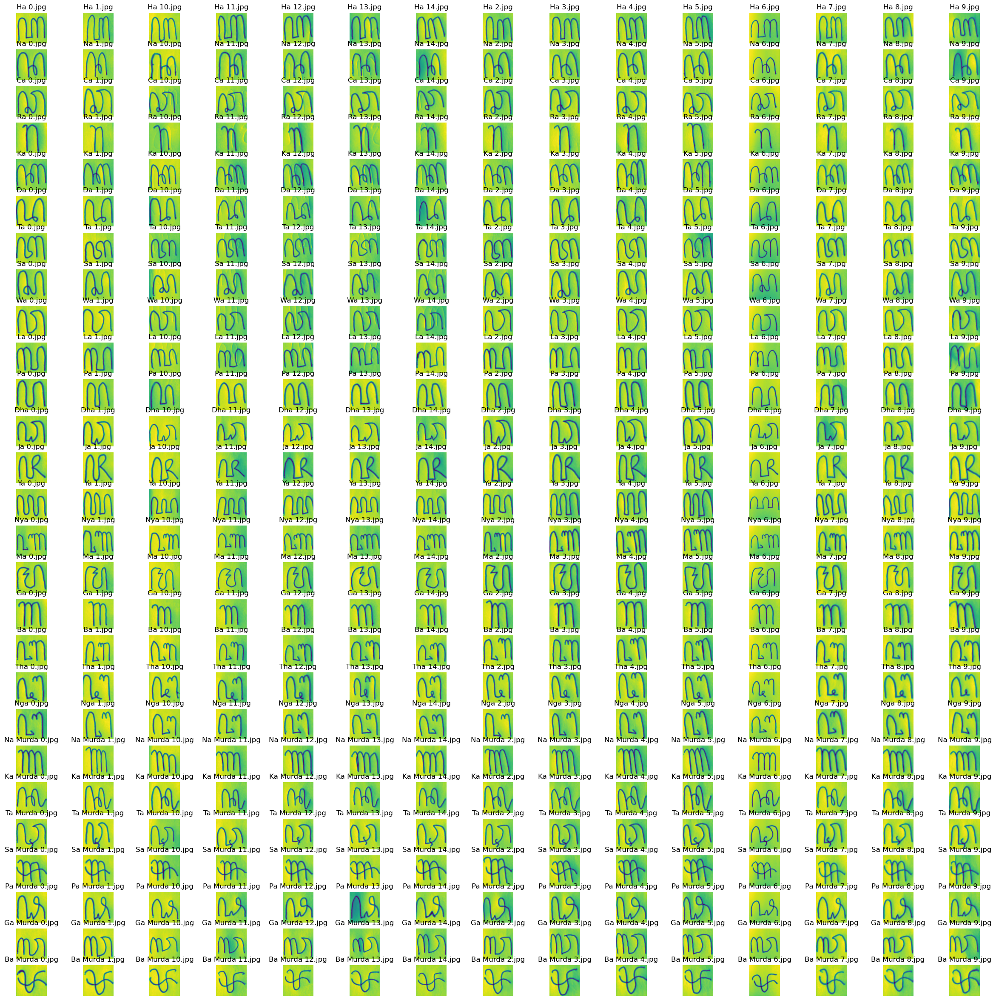

In [5]:
i = 0
fig, axs = plt.subplots(nrows = 27, ncols = 15, figsize = (30,30))
axs = axs.flatten()

for image in grayscale_images:
    axs[i].imshow(image)
    axs[i].axis('off')
    axs[i].set_title(name[i])
    i += 1
    
plt.show()

#### Sauvola Threshold Data Training

In [6]:
k = 0.2
R = 128
threshold_images = []

for image in grayscale_images:
    image = image.rotate(270)
    image = image.transpose(method=Image.FLIP_LEFT_RIGHT)
    img_array = np.array(image)
    width, height = image.size
    binary_img = Image.new("1", (width, height))
        
    for x in range(width):
            
        for y in range(height):
            window = img_array[max(x-15, 0):min(x+15, width), max(y-15, 0):min(y+15, height)]
            mean = np.mean(window)
            stddev = np.std(window)
            threshold = mean * (1 + k * ((stddev / R) - 1))
                
            if img_array[x, y] > threshold:
                binary_img.putpixel((x, y), 0)
            else:
                binary_img.putpixel((x, y), 255)
    
    threshold_images.append(binary_img)

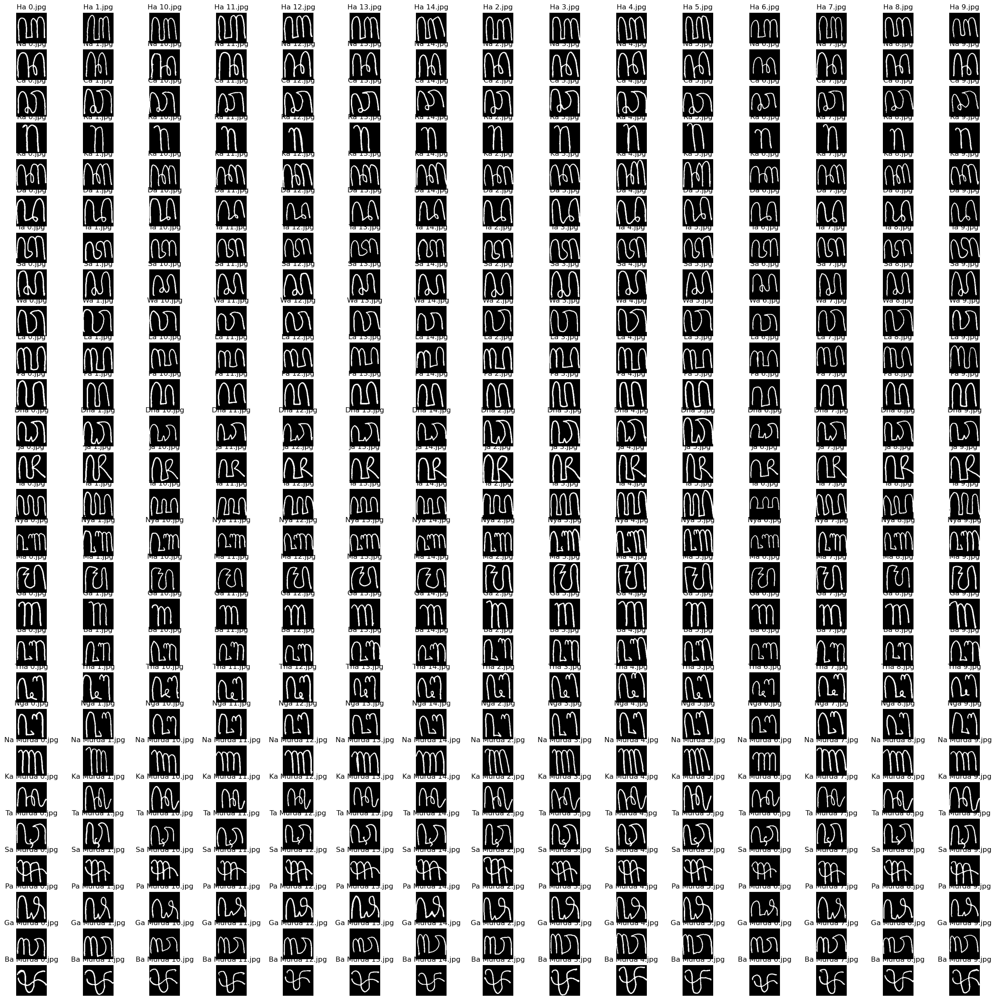

In [7]:
i = 0
fig, axs = plt.subplots(nrows = 27, ncols = 15, figsize = (30,30))
axs = axs.flatten()

for image in threshold_images:
    axs[i].imshow(image)
    axs[i].axis('off')
    axs[i].set_title(name[i])
    i += 1
    
plt.show()

### Ekstraksi Zoning ICZ dan ZCZ 

#### Ekstraksi Zoning

In [8]:
i = 0
k = 0
centroid = np.zeros((len(threshold_images), 8))
array_ekstraksi = np.zeros((len(threshold_images), 6))
array_ngelegena = np.zeros((300, 6))
array_murda =  np.zeros((105, 6))

for image in threshold_images:
    width, height = image.size
    zone_height = height // 3
    zone1 = image.crop((0, 0, width, zone_height))
    zone2 = image.crop((0, zone_height, width, zone_height * 2))
    zone3 = image.crop((0, zone_height * 2, width, height))
    
    img_array = np.array(image)
    img_zone1 = np.array(zone1)
    img_zone2 = np.array(zone2)
    img_zone3 = np.array(zone3)
    total_pixel = np.sum(img_array)
    total_zone1 = np.sum(img_zone1)
    total_zone2 = np.sum(img_zone2)
    total_zone3 = np.sum(img_zone3)
    
    kolom = 0
    baris = 0
    kolom_zone1 = 0
    kolom_zone2 = 0
    kolom_zone3 = 0
    baris_zone1 = 0
    baris_zone2 = 0
    baris_zone3 = 0
    sum_kolom = 0
    sum_baris = 0
    sumkolom_zone1 = 0
    sumkolom_zone2 = 0
    sumkolom_zone3 = 0
    sumbaris_zone1 = 0
    sumbaris_zone2 = 0
    sumbaris_zone3 = 0
    sumiczzone1 = 0
    sumiczzone2 = 0
    sumiczzone3 = 0
    sumzczzone1 = 0
    sumzczzone2 = 0
    sumzczzone3 = 0
    
    for x in range(width):
    
        for y in range(height):
            kolom += img_array[y][x]
            baris += img_array[x][y]
    
        sum_kolom += kolom * (x + 1)  
        sum_baris += baris * (x + 1)
            
        kolom = 0
        baris = 0
        
    for x in range(len(img_zone1)):
            
        for y in range(len(img_zone1[x])):
            baris_zone1 += img_zone1[x][y]
            baris_zone2 += img_zone2[x][y]
            baris_zone3 += img_zone3[x][y]

        sumbaris_zone1 += baris_zone1 * (x + 1)
        sumbaris_zone2 += baris_zone2 * (x + 1)
        sumbaris_zone3 += baris_zone3 * (x + 1)

        baris_zone1 = 0
        baris_zone2 = 0
        baris_zone3 = 0
            
    for x in range(len(img_zone1[0])):
            
        for y in range(len(img_zone1)):
            kolom_zone1 += img_zone1[y][x]
            kolom_zone2 += img_zone2[y][x]    
            kolom_zone3 += img_zone3[y][x]
                
        sumkolom_zone1 += kolom_zone1 * (x + 1)  
        sumkolom_zone2 += kolom_zone2 * (x + 1)  
        sumkolom_zone3 += kolom_zone3 * (x + 1)  
            
        kolom_zone1 = 0
        kolom_zone2 = 0
        kolom_zone3 = 0
            
    centroid_x = sum_kolom / total_pixel
    centroid_y = sum_baris / total_pixel
        
    centroidx_zone1 = sumkolom_zone1 / total_zone1
    centroidx_zone2 = sumkolom_zone2 / total_zone2
    centroidx_zone3 = sumkolom_zone3 / total_zone3
        
    centroidy_zone1 = sumbaris_zone1 / total_zone1
    centroidy_zone2 = sumbaris_zone2 / total_zone2
    centroidy_zone3 = sumbaris_zone3 / total_zone3
    
    centroid[i] = [centroid_x, centroid_y, centroidx_zone1, centroidx_zone2, centroidx_zone3, centroidy_zone1, centroidy_zone2, centroidy_zone3]
    
    if math.isnan(centroidx_zone1) and math.isnan(centroidy_zone1):
        centroidx_zone1 = 0
        centroidy_zone1 = 0
        
    if math.isnan(centroidx_zone2) and math.isnan(centroidy_zone2):
        centroidx_zone2 = 0
        centroidy_zone2 = 0
        
    if math.isnan(centroidx_zone3) and math.isnan(centroidy_zone3):
        centroidx_zone3 = 0
        centroidy_zone3 = 0
    
    for x in range(len(img_zone1)):
            
        for y in range(len(img_zone1[0])):
            if img_zone1[x][y] == True:
                sumiczzone1 += math.sqrt(pow(((y+1) - centroid_x), 2) + pow(((x+1) - centroid_y), 2))
                sumzczzone1 += math.sqrt(pow(((y+1) - centroidx_zone1), 2) + pow(((x+1) - centroidy_zone1), 2))
                
            if img_zone2[x][y] == True:
                sumiczzone2 += math.sqrt(pow(((y+1) - centroid_x), 2) + pow(((x+1) - centroid_y), 2))
                sumzczzone2 += math.sqrt(pow(((y+1) - centroidx_zone2), 2) + pow(((x+1) - centroidy_zone2), 2))
                
            if img_zone3[x][y] == True:
                sumiczzone3 += math.sqrt(pow(((y+1) - centroid_x), 2) + pow(((x+1) - centroid_y), 2))
                sumzczzone3 += math.sqrt(pow(((y+1) - centroidx_zone3), 2) + pow(((x+1) - centroidy_zone3), 2))
                    
    iczzone1 = sumiczzone1 / total_zone1
    iczzone2 = sumiczzone2 / total_zone2
    iczzone3 = sumiczzone3 / total_zone3
        
    zczzone1 = sumzczzone1 / total_zone1
    zczzone2 = sumzczzone2 / total_zone2
    zczzone3 = sumzczzone3 / total_zone3
    
    if math.isnan(iczzone1) and math.isnan(zczzone1):
        iczzone1 = 0
        zczzone1 = 0
        
    if math.isnan(iczzone2) and math.isnan(zczzone2):
        iczzone2 = 0
        zczzone2 = 0    
     
    if math.isnan(iczzone3) and math.isnan(zczzone3):
        iczzone3 = 0
        zczzone3 = 0
    
    array_ekstraksi[i] = [iczzone1, iczzone2, iczzone3, zczzone1, zczzone2, zczzone3]
    
    if i < 300:
        array_ngelegena[i] = [iczzone1, iczzone2, iczzone3, zczzone1, zczzone2, zczzone3]
    else:
        array_murda[k] = [iczzone1, iczzone2, iczzone3, zczzone1, zczzone2, zczzone3]
        k += 1
        
    print("Nama File : ", name[i])
    print("Centroid Citra: ({}, {})".format(centroid_x, centroid_y))
    print("Centroid Zona 1: ({}, {})".format(centroidx_zone1, centroidy_zone1))
    print("Centroid Zona 2: ({}, {})".format(centroidx_zone2, centroidy_zone2))
    print("Centroid Zona 3: ({}, {})".format(centroidx_zone3, centroidy_zone3))
    print("Ekstraksi ICZ: ({}, {}, {})".format(iczzone1, iczzone2, iczzone3))
    print("Ekstraksi ZCZ: ({}, {}, {})".format(zczzone1, zczzone2, zczzone3))
    print("\n")
        
    i += 1
    
df = pd.DataFrame(array_ekstraksi)
df.to_excel('3 Zona(3).xlsx', index=False)

Nama File :  Ha 0.jpg
Centroid Citra: (60.39644693782141, 59.670874240299206)
Centroid Zona 1: (62.64050235478807, 28.4850863422292)
Centroid Zona 2: (60.959606986899566, 20.435589519650655)
Centroid Zona 3: (57.07679180887372, 12.37542662116041)
Ekstraksi ICZ: (44.153161163580066, 51.753110769935546, 57.82012831797812)
Ekstraksi ZCZ: (29.428698778312725, 32.5528362440576, 29.539964597093338)


Nama File :  Ha 1.jpg
Centroid Citra: (60.41507430997877, 60.5291932059448)
Centroid Zona 1: (61.69439728353141, 25.97623089983022)
Centroid Zona 2: (60.06276150627615, 20.552301255230127)
Centroid Zona 3: (59.548442906574394, 15.711072664359861)
Ekstraksi ICZ: (43.08967927352705, 49.06256612192316, 53.289400977355385)
Ekstraksi ZCZ: (24.942256951107, 28.03052736189533, 26.81586948417416)


Nama File :  Ha 10.jpg
Centroid Citra: (55.140608604407134, 63.453305351521514)
Centroid Zona 1: (55.201183431952664, 29.185404339250493)
Centroid Zona 2: (55.45189873417721, 20.577215189873417)
Centroid Zona

Nama File :  Na 2.jpg
Centroid Citra: (57.7474249888043, 60.404836542767576)
Centroid Zona 1: (55.838304552590266, 25.46153846153846)
Centroid Zona 2: (57.83884297520661, 21.857438016528924)
Centroid Zona 3: (59.54299363057325, 13.609872611464969)
Ekstraksi ICZ: (47.008378382309516, 49.38890403713014, 58.24305551806023)
Ekstraksi ZCZ: (30.842267341894075, 29.346978426040977, 31.93457406312839)


Nama File :  Na 3.jpg
Centroid Citra: (62.733118971061096, 62.97841065686725)
Centroid Zona 1: (62.957642725598525, 26.924493554327807)
Centroid Zona 2: (60.74012474012474, 21.841995841995843)
Centroid Zona 3: (65.4047619047619, 13.738095238095237)
Ekstraksi ICZ: (46.71899830421833, 51.24777282801737, 59.85129635994057)
Ekstraksi ZCZ: (28.793358150555388, 29.0695818720279, 31.11589699114607)


Nama File :  Na 4.jpg
Centroid Citra: (59.33210840606339, 57.97657326596234)
Centroid Zona 1: (59.63595166163142, 24.654078549848943)
Centroid Zona 2: (60.07723995880536, 21.627188465499486)
Centroid Zona

Nama File :  Ca 8.jpg
Centroid Citra: (58.432414256893075, 57.80228648285138)
Centroid Zona 1: (61.00657894736842, 26.61842105263158)
Centroid Zona 2: (60.1625386996904, 21.507739938080494)
Centroid Zona 3: (52.48051948051948, 8.519480519480519)
Ekstraksi ICZ: (43.89423791549975, 50.99173069377535, 58.2336835713779)
Ekstraksi ZCZ: (28.980729059740746, 35.41482392370583, 25.026721384488667)


Nama File :  Ca 9.jpg
Centroid Citra: (57.663897280966765, 59.49773413897281)
Centroid Zona 1: (65.13372093023256, 29.802325581395348)
Centroid Zona 2: (56.972740315638454, 22.715925394548062)
Centroid Zona 3: (50.28621908127209, 7.667844522968198)
Ekstraksi ICZ: (40.601870462310856, 48.865979259267924, 60.9714144790916)
Ekstraksi ZCZ: (23.349752192084303, 32.38868354289676, 25.938576974412424)


Nama File :  Ra 0.jpg
Centroid Citra: (60.67513368983957, 55.88435828877005)
Centroid Zona 1: (55.4082332761578, 21.13893653516295)
Centroid Zona 2: (62.61875, 20.352083333333333)
Centroid Zona 3: (65.6120

Nama File :  Ka 13.jpg
Centroid Citra: (59.496360989810775, 59.680737506065014)
Centroid Zona 1: (61.81340579710145, 30.628623188405797)
Centroid Zona 2: (58.142303969022265, 21.196515004840272)
Centroid Zona 3: (59.747899159663866, 10.081932773109244)
Ekstraksi ICZ: (41.348766095777584, 49.86460920101568, 61.14042513758787)
Ekstraksi ZCZ: (26.916439498488227, 30.35808797921187, 32.12136014654784)


Nama File :  Ka 14.jpg
Centroid Citra: (61.49117247623359, 57.370755998189225)
Centroid Zona 1: (62.18486171761281, 28.50655021834061)
Centroid Zona 2: (60.52804642166344, 21.18568665377176)
Centroid Zona 3: (62.55532786885246, 9.922131147540984)
Ekstraksi ICZ: (41.59859024255928, 49.4220242112791, 58.97723699962422)
Ekstraksi ZCZ: (28.150583334204477, 32.303409269204884, 30.801105197434286)


Nama File :  Ka 2.jpg
Centroid Citra: (62.034412955465584, 62.031882591093115)
Centroid Zona 1: (58.937365010799134, 31.77753779697624)
Centroid Zona 2: (62.39581256231306, 21.37088733798604)
Centroid

Nama File :  Da 7.jpg
Centroid Citra: (54.75068493150685, 65.76493150684931)
Centroid Zona 1: (56.29802955665025, 30.02216748768473)
Centroid Zona 2: (51.273209549071616, 20.478779840848805)
Centroid Zona 3: (57.74887218045113, 13.580451127819549)
Ekstraksi ICZ: (48.92759758644306, 57.52964658230607, 60.95290566194152)
Ekstraksi ZCZ: (32.9666379589157, 34.189094874589856, 27.634186483502003)


Nama File :  Da 8.jpg
Centroid Citra: (61.54891922639363, 63.97724687144483)
Centroid Zona 1: (60.98309178743961, 29.6280193236715)
Centroid Zona 2: (60.04993429697766, 21.660972404730618)
Centroid Zona 3: (63.9073756432247, 11.392795883361922)
Ekstraksi ICZ: (48.72013593197885, 54.34609783365014, 60.80715437637031)
Ekstraksi ZCZ: (34.046022394280854, 33.73753905330902, 27.320220612004746)


Nama File :  Da 9.jpg
Centroid Citra: (57.03914590747331, 64.28185053380783)
Centroid Zona 1: (63.31832797427653, 30.138263665594856)
Centroid Zona 2: (53.8128078817734, 20.924466338259442)
Centroid Zona 3: (

Nama File :  Sa 12.jpg
Centroid Citra: (59.40575221238938, 63.14778761061947)
Centroid Zona 1: (60.62767710049423, 28.065897858319605)
Centroid Zona 2: (61.37731481481482, 20.583333333333332)
Centroid Zona 3: (56.30671736375158, 12.94550063371356)
Ekstraksi ICZ: (45.87055253629038, 54.459094121586084, 59.19668531577888)
Ekstraksi ZCZ: (28.566157747792186, 32.282548533360355, 27.134767546707366)


Nama File :  Sa 13.jpg
Centroid Citra: (54.86245772266065, 60.6054114994363)
Centroid Zona 1: (56.881856540084385, 28.434599156118143)
Centroid Zona 2: (55.721472392638034, 21.81963190184049)
Centroid Zona 3: (51.44536082474227, 10.00618556701031)
Ekstraksi ICZ: (42.41260110531846, 48.67072193769814, 57.22615832312949)
Ekstraksi ZCZ: (27.055373863403634, 29.229870645788775, 23.07578659750058)


Nama File :  Sa 14.jpg
Centroid Citra: (60.34435401831129, 65.19226856561546)
Centroid Zona 1: (58.35091743119266, 30.142201834862384)
Centroid Zona 2: (63.64585834333734, 21.255702280912367)
Centroid Z

Nama File :  Wa 6.jpg
Centroid Citra: (63.38223308883455, 64.62754686226569)
Centroid Zona 1: (61.68852459016394, 36.717213114754095)
Centroid Zona 2: (63.192616372391655, 20.149277688603533)
Centroid Zona 3: (64.85833333333333, 11.294444444444444)
Ekstraksi ICZ: (35.39888082415055, 55.872742763169654, 60.36101885266669)
Ekstraksi ZCZ: (19.6586647559606, 33.51290805847271, 25.43618639965839)


Nama File :  Wa 7.jpg
Centroid Citra: (58.76987447698745, 57.868898186889815)
Centroid Zona 1: (58.389380530973455, 26.86725663716814)
Centroid Zona 2: (59.179611650485434, 20.80906148867314)
Centroid Zona 3: (58.5467032967033, 11.373626373626374)
Ekstraksi ICZ: (41.94804956819585, 51.48930688798101, 57.67223097452216)
Ekstraksi ZCZ: (26.25023887403534, 35.01401378353433, 29.824916179609257)


Nama File :  Wa 8.jpg
Centroid Citra: (61.982384823848236, 56.729674796747965)
Centroid Zona 1: (60.99196787148595, 25.54016064257028)
Centroid Zona 2: (62.7702479338843, 21.155371900826445)
Centroid Zona 3

Nama File :  Pa 11.jpg
Centroid Citra: (60.19426406926407, 57.464285714285715)
Centroid Zona 1: (60.23711340206186, 27.080756013745706)
Centroid Zona 2: (61.18204488778055, 20.61346633416459)
Centroid Zona 3: (58.43318965517241, 10.131465517241379)
Ekstraksi ICZ: (43.06614491417247, 50.7013281648405, 57.77749620871106)
Ekstraksi ZCZ: (29.96413333494118, 33.32194673404317, 28.487770693578565)


Nama File :  Pa 12.jpg
Centroid Citra: (56.00293111871031, 60.413776257938444)
Centroid Zona 1: (55.14593698175788, 27.082918739635158)
Centroid Zona 2: (54.85476190476191, 20.46904761904762)
Centroid Zona 3: (58.455298013245034, 13.612582781456954)
Ekstraksi ICZ: (42.703448008044134, 50.784463187067765, 56.512303677015176)
Ekstraksi ZCZ: (25.95458573543707, 30.083825858089888, 28.25251125148288)


Nama File :  Pa 13.jpg
Centroid Citra: (59.23702664796634, 58.18980832164563)
Centroid Zona 1: (60.945103857566764, 26.259643916913948)
Centroid Zona 2: (58.4920993227991, 20.404063205417607)
Centroid 

Nama File :  Dha 5.jpg
Centroid Citra: (58.23375624759708, 59.45021145713187)
Centroid Zona 1: (55.9806598407281, 22.00796359499431)
Centroid Zona 2: (62.032634032634036, 21.694638694638694)
Centroid Zona 3: (56.75347222222222, 15.313657407407407)
Ekstraksi ICZ: (50.75674868985936, 55.219859392680576, 55.61103966429228)
Ekstraksi ZCZ: (32.21529806645536, 39.93308718450688, 30.392559630543214)


Nama File :  Dha 6.jpg
Centroid Citra: (62.905246671887234, 60.69068128425999)
Centroid Zona 1: (67.69675090252707, 34.81588447653429)
Centroid Zona 2: (62.139945652173914, 21.88179347826087)
Centroid Zona 3: (60.01136363636363, 4.518939393939394)
Ekstraksi ICZ: (39.805570650243354, 52.86589202006263, 62.59208626184375)
Ekstraksi ZCZ: (27.751029029974987, 36.03667711167521, 22.20006627783483)


Nama File :  Dha 7.jpg
Centroid Citra: (56.50895614576899, 61.36442248301421)
Centroid Zona 1: (58.2369020501139, 30.763097949886106)
Centroid Zona 2: (58.400862068965516, 21.064655172413794)
Centroid Zon

Nama File :  Ya 1.jpg
Centroid Citra: (54.38836153528683, 60.31820057779612)
Centroid Zona 1: (50.032485875706215, 26.96045197740113)
Centroid Zona 2: (55.40457256461232, 20.756461232604373)
Centroid Zona 3: (57.296191819464035, 13.007052186177715)
Ekstraksi ICZ: (45.77697273712562, 51.959538057933386, 57.99026244638309)
Ekstraksi ZCZ: (28.913723406122273, 32.57374370257985, 30.666680736195513)


Nama File :  Ya 10.jpg
Centroid Citra: (55.59418669647848, 67.68921185019563)
Centroid Zona 1: (48.476190476190474, 36.964285714285715)
Centroid Zona 2: (58.30747126436781, 20.041187739463602)
Centroid Zona 3: (52.75736568457539, 10.473136915077989)
Ekstraksi ICZ: (47.20890615615723, 58.21092281209763, 65.3687988769501)
Ekstraksi ZCZ: (33.34078410637028, 32.20717964762285, 28.305210653651525)


Nama File :  Ya 11.jpg
Centroid Citra: (63.21171836533727, 69.37863121614969)
Centroid Zona 1: (60.06827309236948, 37.04417670682731)
Centroid Zona 2: (64.83776091081594, 20.5123339658444)
Centroid Zona

Nama File :  Nya 2.jpg
Centroid Citra: (60.63084761463641, 62.71607225567392)
Centroid Zona 1: (59.47841726618705, 33.764388489208635)
Centroid Zona 2: (62.37577639751553, 19.74534161490683)
Centroid Zona 3: (58.990580847723706, 12.491365777080063)
Ekstraksi ICZ: (40.491828405025686, 56.054015903781554, 60.15515558329803)
Ekstraksi ZCZ: (25.832439169072046, 34.97430892594568, 31.03684989080893)


Nama File :  Nya 3.jpg
Centroid Citra: (64.6507703595011, 57.98129126925899)
Centroid Zona 1: (67.12674543501612, 28.78625134264232)
Centroid Zona 2: (65.78683966635774, 20.42354031510658)
Centroid Zona 3: (59.71927374301676, 12.262569832402235)
Ekstraksi ICZ: (42.42961786034963, 54.338306650974495, 58.38691823522721)
Ekstraksi ZCZ: (28.194927072842347, 38.245956716928575, 33.3952679995858)


Nama File :  Nya 4.jpg
Centroid Citra: (62.80402867872994, 61.62683509730283)
Centroid Zona 1: (62.16335540838852, 28.84988962472406)
Centroid Zona 2: (63.6478102189781, 20.491788321167885)
Centroid Zona 

Nama File :  Ma 9.jpg
Centroid Citra: (58.27977315689981, 60.76086956521739)
Centroid Zona 1: (57.85924713584288, 26.173486088379704)
Centroid Zona 2: (58.23638470451912, 19.24217844727694)
Centroid Zona 3: (58.73831775700935, 15.719626168224298)
Ekstraksi ICZ: (45.446504077100066, 53.08165710098624, 54.488410858702196)
Ekstraksi ZCZ: (28.61384289685062, 32.36508180967939, 29.504680312083437)


Nama File :  Ga 0.jpg
Centroid Citra: (58.40764647467726, 53.836146971201586)
Centroid Zona 1: (52.13341493268054, 24.244798041615667)
Centroid Zona 2: (62.78181818181818, 20.762237762237763)
Centroid Zona 3: (62.553941908713696, 13.719917012448132)
Ekstraksi ICZ: (38.84066231628278, 41.43681893728942, 47.98139660169868)
Ekstraksi ZCZ: (23.493827209813926, 24.766320540629273, 24.342663485434326)


Nama File :  Ga 1.jpg
Centroid Citra: (62.98944405348346, 56.11611541168192)
Centroid Zona 1: (58.04448742746615, 25.23597678916828)
Centroid Zona 2: (65.59217877094972, 20.452513966480446)
Centroid Zo

Nama File :  Ba 13.jpg
Centroid Citra: (66.03727034120735, 59.29763779527559)
Centroid Zona 1: (68.92529711375212, 31.407470288624786)
Centroid Zona 2: (66.43945068664169, 19.51685393258427)
Centroid Zona 3: (62.10873786407767, 10.854368932038835)
Ekstraksi ICZ: (40.80117343669422, 56.81125696759651, 57.511839362540364)
Ekstraksi ZCZ: (27.218907671686082, 40.055242346230116, 27.45037710682038)


Nama File :  Ba 14.jpg
Centroid Citra: (67.42176470588235, 66.27764705882353)
Centroid Zona 1: (80.5327868852459, 36.11065573770492)
Centroid Zona 2: (64.95870535714286, 18.996651785714285)
Centroid Zona 3: (65.65, 11.071428571428571)
Ekstraksi ICZ: (37.20395994858747, 59.38299368312992, 64.63263270443863)
Ekstraksi ZCZ: (14.796456786757759, 34.89447778866635, 30.532589967657227)


Nama File :  Ba 2.jpg
Centroid Citra: (60.09018435475834, 54.350772296960635)
Centroid Zona 1: (64.19762845849803, 24.18445322793149)
Centroid Zona 2: (60.617218543046356, 20.941721854304635)
Centroid Zona 3: (52.959

Nama File :  Tha 6.jpg
Centroid Citra: (57.849141824751584, 60.908762420957544)
Centroid Zona 1: (71.30952380952381, 34.154761904761905)
Centroid Zona 2: (53.8041237113402, 19.785223367697593)
Centroid Zona 3: (54.04761904761905, 8.0)
Ekstraksi ICZ: (36.16519159113945, 51.93029756831531, 56.86593043749502)
Ekstraksi ZCZ: (17.09417232605729, 31.74062472993485, 16.610730190801046)


Nama File :  Tha 7.jpg
Centroid Citra: (64.904, 56.351)
Centroid Zona 1: (65.40819209039547, 23.00423728813559)
Centroid Zona 2: (59.92286501377411, 22.490358126721762)
Centroid Zona 3: (70.66254416961131, 10.18904593639576)
Ekstraksi ICZ: (47.305854864217864, 50.02370999368187, 56.74788668204086)
Ekstraksi ZCZ: (32.01194556206585, 36.16461767532537, 28.065020312396648)


Nama File :  Tha 8.jpg
Centroid Citra: (63.19052132701422, 58.303791469194316)
Centroid Zona 1: (63.02876712328767, 23.57945205479452)
Centroid Zona 2: (58.89090909090909, 22.332867132867133)
Centroid Zona 3: (67.99097744360903, 12.090225563

Nama File :  Na Murda 11.jpg
Centroid Citra: (56.04651162790697, 60.70686857760952)
Centroid Zona 1: (45.64468864468864, 32.99267399267399)
Centroid Zona 2: (58.447015834348356, 20.278928136419)
Centroid Zona 3: (63.74066390041494, 12.8298755186722)
Ekstraksi ICZ: (38.58914912537157, 47.9266641710839, 55.279215647696624)
Ekstraksi ZCZ: (23.206104924153845, 26.27063575558206, 25.32629136738383)


Nama File :  Na Murda 12.jpg
Centroid Citra: (70.21289789169079, 61.857379082265396)
Centroid Zona 1: (60.38642297650131, 30.131853785900784)
Centroid Zona 2: (72.9240780911063, 20.636659436008678)
Centroid Zona 3: (77.09028727770178, 16.64158686730506)
Ekstraksi ICZ: (43.952314628887116, 49.46452951453317, 53.120819469042836)
Ekstraksi ZCZ: (27.40368255103074, 27.249789468947863, 26.154037010464513)


Nama File :  Na Murda 13.jpg
Centroid Citra: (63.70074349442379, 63.50046468401487)
Centroid Zona 1: (54.26347305389221, 33.471057884231534)
Centroid Zona 2: (63.54985479186834, 19.52371732817037

Nama File :  Ka Murda 4.jpg
Centroid Citra: (57.981808994441636, 65.933299646286)
Centroid Zona 1: (52.002808988764045, 30.252808988764045)
Centroid Zona 2: (57.839530332681015, 22.177103718199607)
Centroid Zona 3: (61.765391014975044, 13.455906821963394)
Ekstraksi ICZ: (44.156852042601415, 53.71839066070077, 62.9817511641818)
Ekstraksi ZCZ: (24.567059028138164, 29.283841227401258, 33.100240540600815)


Nama File :  Ka Murda 5.jpg
Centroid Citra: (53.26111111111111, 62.45213675213675)
Centroid Zona 1: (42.18761061946903, 26.44424778761062)
Centroid Zona 2: (55.00275482093664, 21.060606060606062)
Centroid Zona 3: (59.616618075801746, 14.317784256559767)
Ekstraksi ICZ: (44.187562295316, 50.971673768756176, 58.73270034487217)
Ekstraksi ZCZ: (23.706042999183776, 27.927360346825157, 31.039528998479476)


Nama File :  Ka Murda 6.jpg
Centroid Citra: (61.244897959183675, 64.92789115646258)
Centroid Zona 1: (54.083743842364534, 35.24630541871921)
Centroid Zona 2: (61.78711790393013, 22.62882096

Nama File :  Sa Murda 1.jpg
Centroid Citra: (53.10468042274786, 58.28535480624056)
Centroid Zona 1: (47.91237113402062, 27.596219931271477)
Centroid Zona 2: (54.51070038910506, 22.769455252918288)
Centroid Zona 3: (57.286472148541115, 13.435013262599469)
Ekstraksi ICZ: (37.11017327708349, 44.35860842657803, 49.58225552130645)
Ekstraksi ZCZ: (19.532676791800395, 26.674188924994144, 20.49172622325229)


Nama File :  Sa Murda 10.jpg
Centroid Citra: (52.70040691759919, 55.80366225839268)
Centroid Zona 1: (43.40449438202247, 28.46441947565543)
Centroid Zona 2: (56.67714528462192, 21.155480033984706)
Centroid Zona 3: (53.811764705882354, 8.352941176470589)
Ekstraksi ICZ: (34.4964132315549, 44.851528934272274, 51.38656346289636)
Ekstraksi ZCZ: (18.51676618842192, 27.308090137754256, 17.728880063252255)


Nama File :  Sa Murda 11.jpg
Centroid Citra: (55.63055062166963, 57.54114860864417)
Centroid Zona 1: (48.98795180722892, 30.73253012048193)
Centroid Zona 2: (58.09619047619048, 21.37238095238

Nama File :  Pa Murda 3.jpg
Centroid Citra: (59.47931873479319, 65.72652068126521)
Centroid Zona 1: (50.777056277056275, 28.83116883116883)
Centroid Zona 2: (63.927144535840185, 19.43125734430082)
Centroid Zona 3: (59.796495956873315, 15.919137466307278)
Ekstraksi ICZ: (48.35397276959551, 59.78710822760273, 59.3986575212334)
Ekstraksi ZCZ: (29.74244743585255, 36.7907837370039, 29.43595238833314)


Nama File :  Pa Murda 4.jpg
Centroid Citra: (55.67615106052768, 65.98085876875324)
Centroid Zona 1: (42.583333333333336, 29.514705882352942)
Centroid Zona 2: (59.76646706586826, 20.065868263473053)
Centroid Zona 3: (58.46811594202899, 14.701449275362318)
Ekstraksi ICZ: (48.4763032868967, 59.80742201810142, 60.83075644830869)
Ekstraksi ZCZ: (29.37756806172239, 36.68281522252511, 29.064239226819947)


Nama File :  Pa Murda 5.jpg
Centroid Citra: (53.49735957753241, 66.42678828612578)
Centroid Zona 1: (43.42093023255814, 28.672093023255815)
Centroid Zona 2: (57.34276018099548, 19.217194570135746)

Nama File :  Ba Murda 0.jpg
Centroid Citra: (55.50638080653395, 60.21337417049515)
Centroid Zona 1: (51.23285198555957, 28.613718411552348)
Centroid Zona 2: (58.98842815814851, 24.524590163934427)
Centroid Zona 3: (52.12771739130435, 15.63586956521739)
Ekstraksi ICZ: (48.33294337127196, 46.918260090869445, 46.096978621076616)
Ekstraksi ZCZ: (35.659439125977656, 29.673585121053094, 14.098961995652898)


Nama File :  Ba Murda 1.jpg
Centroid Citra: (61.058347775852106, 63.513575967648755)
Centroid Zona 1: (52.911832946635734, 28.336426914153133)
Centroid Zona 2: (62.650496141124584, 24.492833517089306)
Centroid Zona 3: (66.31806615776081, 19.83206106870229)
Ekstraksi ICZ: (49.69933852007355, 48.10796213997284, 45.799602242838375)
Ekstraksi ZCZ: (32.70553963021306, 27.639051777664445, 16.562148437744476)


Nama File :  Ba Murda 10.jpg
Centroid Citra: (52.60278956943602, 58.67313523347483)
Centroid Zona 1: (53.40406320541761, 24.058690744920995)
Centroid Zona 2: (51.03794642857143, 22.84375

In [9]:
df = pd.read_excel("3 Zona(3).xlsx")
df

,0,1,2,3,4,5
0,44.153161,51.753111,57.820128,29.428699,32.552836,29.539965
1,43.089679,49.062566,53.289401,24.942257,28.030527,26.815869
2,44.224892,52.560849,56.315194,26.703089,29.380627,27.701513
3,46.798062,50.674239,54.343961,30.540813,33.140769,30.111676
4,42.820584,48.490761,55.573530,28.066143,32.150718,29.408943
...,...,...,...,...,...,...
400,44.577987,48.349751,42.189394,30.366648,26.461596,15.601662
401,43.809673,52.478662,56.549667,19.227958,27.524079,13.932210
402,45.923161,47.831644,45.428925,28.654470,26.313067,14.720040
403,43.539981,47.354998,45.203489,31.569302,28.492140,12.095287


#### Kelas Tiap Data 

In [10]:
ngelegena = np.empty(300, dtype=object)
murda = np.empty(105, dtype=object)
k = 0

for i in range(len(name)):
    if i >= 300:
        name[i] = name[i][:8]
        murda[k] = name[i][:8]
        k += 1
    elif 165 <= i <= 179 or 210 <= i <= 224 or 270 <= i <= 299:
        name[i] = name[i][:3]
        ngelegena[i] = name[i][:3]
    else:
        name[i] = name[i][:2]
        ngelegena[i] = name[i][:2]
        
print(name)

['Ha' 'Ha' 'Ha' 'Ha' 'Ha' 'Ha' 'Ha' 'Ha' 'Ha' 'Ha' 'Ha' 'Ha' 'Ha' 'Ha'
 'Ha' 'Na' 'Na' 'Na' 'Na' 'Na' 'Na' 'Na' 'Na' 'Na' 'Na' 'Na' 'Na' 'Na'
 'Na' 'Na' 'Ca' 'Ca' 'Ca' 'Ca' 'Ca' 'Ca' 'Ca' 'Ca' 'Ca' 'Ca' 'Ca' 'Ca'
 'Ca' 'Ca' 'Ca' 'Ra' 'Ra' 'Ra' 'Ra' 'Ra' 'Ra' 'Ra' 'Ra' 'Ra' 'Ra' 'Ra'
 'Ra' 'Ra' 'Ra' 'Ra' 'Ka' 'Ka' 'Ka' 'Ka' 'Ka' 'Ka' 'Ka' 'Ka' 'Ka' 'Ka'
 'Ka' 'Ka' 'Ka' 'Ka' 'Ka' 'Da' 'Da' 'Da' 'Da' 'Da' 'Da' 'Da' 'Da' 'Da'
 'Da' 'Da' 'Da' 'Da' 'Da' 'Da' 'Ta' 'Ta' 'Ta' 'Ta' 'Ta' 'Ta' 'Ta' 'Ta'
 'Ta' 'Ta' 'Ta' 'Ta' 'Ta' 'Ta' 'Ta' 'Sa' 'Sa' 'Sa' 'Sa' 'Sa' 'Sa' 'Sa'
 'Sa' 'Sa' 'Sa' 'Sa' 'Sa' 'Sa' 'Sa' 'Sa' 'Wa' 'Wa' 'Wa' 'Wa' 'Wa' 'Wa'
 'Wa' 'Wa' 'Wa' 'Wa' 'Wa' 'Wa' 'Wa' 'Wa' 'Wa' 'La' 'La' 'La' 'La' 'La'
 'La' 'La' 'La' 'La' 'La' 'La' 'La' 'La' 'La' 'La' 'Pa' 'Pa' 'Pa' 'Pa'
 'Pa' 'Pa' 'Pa' 'Pa' 'Pa' 'Pa' 'Pa' 'Pa' 'Pa' 'Pa' 'Pa' 'Dha' 'Dha' 'Dha'
 'Dha' 'Dha' 'Dha' 'Dha' 'Dha' 'Dha' 'Dha' 'Dha' 'Dha' 'Dha' 'Dha' 'Dha'
 'Ja' 'Ja' 'Ja' 'Ja' 'Ja' 'Ja' 'Ja' 'Ja' 'Ja' 'Ja' 'Ja' 'Ja' 'Ja' 'Ja'
 

### Training SVM 

#### Membangun Model Kelas untuk Binary Class

In [11]:
model = np.column_stack((array_ekstraksi, name))

for i in range (len(model)):
    if i >= 300:
        model[i][6] = -1
    else:
        model[i][6] = 1 

print(model)

[[44.153161163580066 51.753110769935546 57.82012831797812 ...
  32.5528362440576 29.539964597093338 1]
 [43.08967927352705 49.06256612192316 53.289400977355385 ...
  28.03052736189533 26.81586948417416 1]
 [44.22489186256428 52.560849003663066 56.3151942206931 ...
  29.38062746170614 27.701513031510363 1]
 ...
 [45.92316078527927 47.831643559783764 45.428924739326796 ...
  26.31306654166817 14.720040142550227 -1]
 [43.539980914073254 47.354998275835406 45.20348870695699 ...
  28.492139793208228 12.095287462976035 -1]
 [46.28381572984735 47.38495173425849 43.277216076086916 ...
  28.682018634701297 14.58472473666707 -1]]


#### Membangun Model Kelas untuk MultiClass

In [12]:
model_ha = np.column_stack((array_ngelegena, ngelegena))
model_na = np.column_stack((array_ngelegena, ngelegena))
model_ca = np.column_stack((array_ngelegena, ngelegena))
model_ra = np.column_stack((array_ngelegena, ngelegena))
model_ka = np.column_stack((array_ngelegena, ngelegena))
model_da = np.column_stack((array_ngelegena, ngelegena))
model_ta = np.column_stack((array_ngelegena, ngelegena))
model_sa = np.column_stack((array_ngelegena, ngelegena))
model_wa = np.column_stack((array_ngelegena, ngelegena))
model_la = np.column_stack((array_ngelegena, ngelegena))
model_pa = np.column_stack((array_ngelegena, ngelegena))
model_dha = np.column_stack((array_ngelegena, ngelegena))
model_ja = np.column_stack((array_ngelegena, ngelegena))
model_ya = np.column_stack((array_ngelegena, ngelegena))
model_nya = np.column_stack((array_ngelegena, ngelegena))
model_ma = np.column_stack((array_ngelegena, ngelegena))
model_ga = np.column_stack((array_ngelegena, ngelegena))
model_ba = np.column_stack((array_ngelegena, ngelegena))
model_tha = np.column_stack((array_ngelegena, ngelegena))
model_nga = np.column_stack((array_ngelegena, ngelegena))
model_namurda = np.column_stack((array_murda, murda))
model_kamurda = np.column_stack((array_murda, murda))
model_tamurda = np.column_stack((array_murda, murda))
model_samurda = np.column_stack((array_murda, murda))
model_pamurda = np.column_stack((array_murda, murda))
model_gamurda = np.column_stack((array_murda, murda))
model_bamurda = np.column_stack((array_murda, murda))

print("MODEL HA \n", model_ha, "\n")
print("MODEL NA MURDA \n", model_namurda)

MODEL HA 
 [[44.153161163580066 51.753110769935546 57.82012831797812 ...
  32.5528362440576 29.539964597093338 'Ha']
 [43.08967927352705 49.06256612192316 53.289400977355385 ...
  28.03052736189533 26.81586948417416 'Ha']
 [44.22489186256428 52.560849003663066 56.3151942206931 ...
  29.38062746170614 27.701513031510363 'Ha']
 ...
 [41.5111575982018 51.05177421351352 54.8266709571987 ...
  35.39413693459926 27.394246171264008 'Nga']
 [44.14096053775214 54.71261975567604 56.300118920819266 ...
  32.63822666191464 26.288543318535943 'Nga']
 [41.67815148425684 52.00828401669706 55.06835557991941 ...
  34.98077099174364 25.164570699309255 'Nga']] 

MODEL NA MURDA 
 [[41.11449937132952 49.740980712819244 53.7487720122354 22.79718259919341
  27.37230372814341 27.72194505790173 'Na Murda']
 [39.38859260942655 43.2591225431679 47.13459023393123 20.886587332557795
  22.707704499643896 21.476068558509546 'Na Murda']
 [41.52219121465749 50.31900570603886 56.17029901271493 20.73452146748132
  26.01

In [13]:
for i in range (len(model_ha)):
    if model_ha[i][6] == 'Ha':
        model_ha[i][6] = 1
    else:
        model_ha[i][6] = -1

for i in range(len(model_na)):
    if model_na[i][6] == 'Na':
        model_na[i][6] = 1
    else:
        model_na[i][6] = -1
                         
for i in range (len(model_ca)):
    if model_ca[i][6] == 'Ca':
        model_ca[i][6] = 1
    else:
        model_ca[i][6] = -1

for i in range(len(model_ra)):
    if model_ra[i][6] == 'Ra':
        model_ra[i][6] = 1
    else:
        model_ra[i][6] = -1
        
for i in range (len(model_ka)):
    if model_ka[i][6] == 'Ka':
        model_ka[i][6] = 1
    else:
        model_ka[i][6] = -1

for i in range(len(model_da)):
    if model_da[i][6] == 'Da':
        model_da[i][6] = 1
    else:
        model_da[i][6] = -1
        
for i in range (len(model_ta)):
    if model_ta[i][6] == 'Ta':
        model_ta[i][6] = 1
    else:
        model_ta[i][6] = -1

for i in range(len(model_sa)):
    if model_sa[i][6] == 'Sa':
        model_sa[i][6] = 1
    else:
        model_sa[i][6] = -1        
        
for i in range (len(model_wa)):
    if model_wa[i][6] == 'Wa':
        model_wa[i][6] = 1
    else:
        model_wa[i][6] = -1

for i in range(len(model_la)):
    if model_la[i][6] == 'La':
        model_la[i][6] = 1
    else:
        model_la[i][6] = -1
                         
for i in range (len(model_pa)):
    if model_pa[i][6] == 'Pa':
        model_pa[i][6] = 1
    else:
        model_pa[i][6] = -1

for i in range(len(model_dha)):
    if model_dha[i][6] == 'Dha':
        model_dha[i][6] = 1
    else:
        model_dha[i][6] = -1
        
for i in range (len(model_ja)):
    if model_ja[i][6] == 'Ja':
        model_ja[i][6] = 1
    else:
        model_ja[i][6] = -1

for i in range(len(model_ya)):
    if model_ya[i][6] == 'Ya':
        model_ya[i][6] = 1
    else:
        model_ya[i][6] = -1
        
for i in range (len(model_nya)):
    if model_nya[i][6] == 'Nya':
        model_nya[i][6] = 1
    else:
        model_nya[i][6] = -1

for i in range(len(model_ma)):
    if model_ma[i][6] == 'Ma':
        model_ma[i][6] = 1
    else:
        model_ma[i][6] = -1
        
for i in range (len(model_ga)):
    if model_ga[i][6] == 'Ga':
        model_ga[i][6] = 1
    else:
        model_ga[i][6] = -1

for i in range(len(model_ba)):
    if model_ba[i][6] == 'Ba':
        model_ba[i][6] = 1
    else:
        model_ba[i][6] = -1
                         
for i in range (len(model_tha)):
    if model_tha[i][6] == 'Tha':
        model_tha[i][6] = 1
    else:
        model_tha[i][6] = -1

for i in range(len(model_nga)):
    if model_nga[i][6] == 'Nga':
        model_nga[i][6] = 1
    else:
        model_nga[i][6] = -1
        
for i in range (len(model_namurda)):
    if model_namurda[i][6] == 'Na Murda':
        model_namurda[i][6] = 1
    else:
        model_namurda[i][6] = -1

for i in range(len(model_kamurda)):
    if model_kamurda[i][6] == 'Ka Murda':
        model_kamurda[i][6] = 1
    else:
        model_kamurda[i][6] = -1
        
for i in range (len(model_tamurda)):
    if model_tamurda[i][6] == 'Ta Murda':
        model_tamurda[i][6] = 1
    else:
        model_tamurda[i][6] = -1

for i in range(len(model_samurda)):
    if model_samurda[i][6] == 'Sa Murda':
        model_samurda[i][6] = 1
    else:
        model_samurda[i][6] = -1
        
for i in range (len(model_pamurda)):
    if model_pamurda[i][6] == 'Pa Murda':
        model_pamurda[i][6] = 1
    else:
        model_pamurda[i][6] = -1

for i in range(len(model_gamurda)):
    if model_gamurda[i][6] == 'Ga Murda':
        model_gamurda[i][6] = 1
    else:
        model_gamurda[i][6] = -1
                         
for i in range (len(model_bamurda)):
    if model_bamurda[i][6] == 'Ba Murda':
        model_bamurda[i][6] = 1
    else:
        model_bamurda[i][6] = -1     

print("MODEL HA \n", model_ha, "\n")
print("MODEL NA MURDA \n", model_namurda)

MODEL HA 
 [[44.153161163580066 51.753110769935546 57.82012831797812 ...
  32.5528362440576 29.539964597093338 1]
 [43.08967927352705 49.06256612192316 53.289400977355385 ...
  28.03052736189533 26.81586948417416 1]
 [44.22489186256428 52.560849003663066 56.3151942206931 ...
  29.38062746170614 27.701513031510363 1]
 ...
 [41.5111575982018 51.05177421351352 54.8266709571987 ...
  35.39413693459926 27.394246171264008 -1]
 [44.14096053775214 54.71261975567604 56.300118920819266 ...
  32.63822666191464 26.288543318535943 -1]
 [41.67815148425684 52.00828401669706 55.06835557991941 ...
  34.98077099174364 25.164570699309255 -1]] 

MODEL NA MURDA 
 [[41.11449937132952 49.740980712819244 53.7487720122354 22.79718259919341
  27.37230372814341 27.72194505790173 1]
 [39.38859260942655 43.2591225431679 47.13459023393123 20.886587332557795
  22.707704499643896 21.476068558509546 1]
 [41.52219121465749 50.31900570603886 56.17029901271493 20.73452146748132
  26.010300216861644 24.95804145456394 1]
 

#### Kernel RBF untuk Binary Class

In [14]:
sigma = 2.1

def kernel_rbf(array_ekstraksi):
    array_rbf = np.zeros((len(array_ekstraksi), len(array_ekstraksi)))
    for i in range (len(array_rbf)):
        for j in range (len(array_rbf[i])):
            array_rbf[i, j] = math.exp(-(pow((array_ekstraksi[i][0] - array_ekstraksi[j][0]), 2)
                                        + pow((array_ekstraksi[i][1] - array_ekstraksi[j][1]), 2)
                                        + pow((array_ekstraksi[i][2] - array_ekstraksi[j][2]), 2)
                                        + pow((array_ekstraksi[i][3] - array_ekstraksi[j][3]), 2)
                                        + pow((array_ekstraksi[i][4] - array_ekstraksi[j][4]), 2)
                                        + pow((array_ekstraksi[i][5] - array_ekstraksi[j][5]), 2)) / (2 * pow(sigma, 2)))
    return array_rbf

rbf = kernel_rbf(array_ekstraksi)
print(rbf)

[[1.00000000e+00 1.63523470e-04 6.73567270e-02 ... 5.84771189e-22
  1.47581492e-25 1.68085629e-24]
 [1.63523470e-04 1.00000000e+00 4.00032053e-02 ... 2.88187310e-12
  6.08177861e-17 1.85066822e-16]
 [6.73567270e-02 4.00032053e-02 1.00000000e+00 ... 9.38905631e-17
  2.31960042e-21 9.66611404e-21]
 ...
 [5.84771189e-22 2.88187310e-12 9.38905631e-17 ... 1.00000000e+00
  5.19112924e-02 5.92535039e-02]
 [1.47581492e-25 6.08177861e-17 2.31960042e-21 ... 5.19112924e-02
  1.00000000e+00 1.26540846e-01]
 [1.68085629e-24 1.85066822e-16 9.66611404e-21 ... 5.92535039e-02
  1.26540846e-01 1.00000000e+00]]


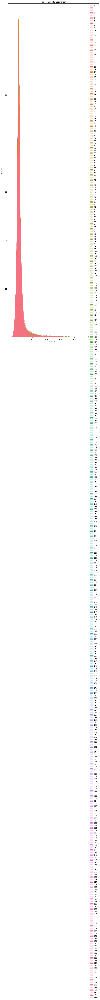

In [17]:
plt.figure(figsize=(10, 37))
sns.kdeplot(rbf, fill=True)
plt.title('Kernel Density Estimation')
plt.xlabel('Data Value')
plt.ylabel('Density')
plt.show()

#### Kernel RBF untuk Multiclass Ngelegena

In [18]:
sigma_ngelegena = 2

def ngelegena(array_ngelegena):
    array_rbf = np.zeros((len(array_ngelegena), len(array_ngelegena)))
    for i in range (len(array_rbf)):
        for j in range (len(array_rbf[i])):
            array_rbf[i, j] = math.exp(-(pow((array_ngelegena[i][0] - array_ngelegena[j][0]), 2)
                                        + pow((array_ngelegena[i][1] - array_ngelegena[j][1]), 2)
                                        + pow((array_ngelegena[i][2] - array_ngelegena[j][2]), 2)
                                        + pow((array_ngelegena[i][3] - array_ngelegena[j][3]), 2)
                                        + pow((array_ngelegena[i][4] - array_ngelegena[j][4]), 2)
                                        + pow((array_ngelegena[i][5] - array_ngelegena[j][5]), 2)) / (2 * pow(sigma_ngelegena, 2)))
    return array_rbf

rbf_ngelegena = ngelegena(array_ngelegena)
print(rbf_ngelegena)

[[1.00000000e+00 6.69070765e-05 5.10846034e-02 ... 1.54493576e-03
  1.20896706e-02 6.71319585e-03]
 [6.69070765e-05 1.00000000e+00 2.87613659e-02 ... 3.59569621e-04
  3.26224996e-04 7.22637748e-05]
 [5.10846034e-02 2.87613659e-02 1.00000000e+00 ... 1.45553163e-03
  1.02908834e-01 2.25398002e-03]
 ...
 [1.54493576e-03 3.59569621e-04 1.45553163e-03 ... 1.00000000e+00
  1.73408658e-02 8.74605854e-02]
 [1.20896706e-02 3.26224996e-04 1.02908834e-01 ... 1.73408658e-02
  1.00000000e+00 2.88855642e-02]
 [6.71319585e-03 7.22637748e-05 2.25398002e-03 ... 8.74605854e-02
  2.88855642e-02 1.00000000e+00]]


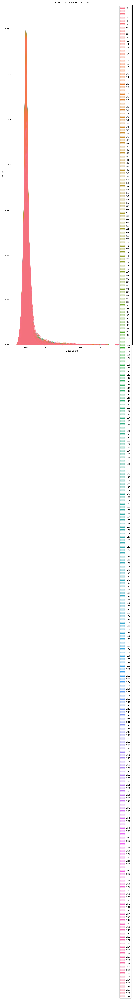

In [19]:
plt.figure(figsize=(10, 28))
sns.kdeplot(rbf_ngelegena, fill=True)
plt.title('Kernel Density Estimation')
plt.xlabel('Data Value')
plt.ylabel('Density')
plt.show()

#### Kernel RBF untuk Multiclass Murda

In [20]:
sigma_huruf = 3

def murda(array_murda):
    array_rbf = np.zeros((len(array_murda), len(array_murda)))
    for i in range (len(array_rbf)):
        for j in range (len(array_rbf[i])):
            array_rbf[i, j] = math.exp(-(pow((array_murda[i][0] - array_murda[j][0]), 2)
                                        + pow((array_murda[i][1] - array_murda[j][1]), 2)
                                        + pow((array_murda[i][2] - array_murda[j][2]), 2)
                                        + pow((array_murda[i][3] - array_murda[j][3]), 2)
                                        + pow((array_murda[i][4] - array_murda[j][4]), 2)
                                        + pow((array_murda[i][5] - array_murda[j][5]), 2)) / (2 * pow(sigma_huruf, 2)))
    return array_rbf

rbf_murda = murda(array_murda)
print(rbf_murda)

[[1.00000000e+00 2.01662470e-04 3.27134566e-01 ... 5.62946774e-08
  1.51445765e-10 1.33799794e-10]
 [2.01662470e-04 1.00000000e+00 1.45043172e-04 ... 3.34460471e-05
  2.54398923e-07 7.16565792e-08]
 [3.27134566e-01 1.45043172e-04 1.00000000e+00 ... 3.58979290e-08
  6.53229919e-11 1.44466252e-11]
 ...
 [5.62946774e-08 3.34460471e-05 3.58979290e-08 ... 1.00000000e+00
  2.34681201e-01 2.50397436e-01]
 [1.51445765e-10 2.54398923e-07 6.53229919e-11 ... 2.34681201e-01
  1.00000000e+00 3.63155863e-01]
 [1.33799794e-10 7.16565792e-08 1.44466252e-11 ... 2.50397436e-01
  3.63155863e-01 1.00000000e+00]]


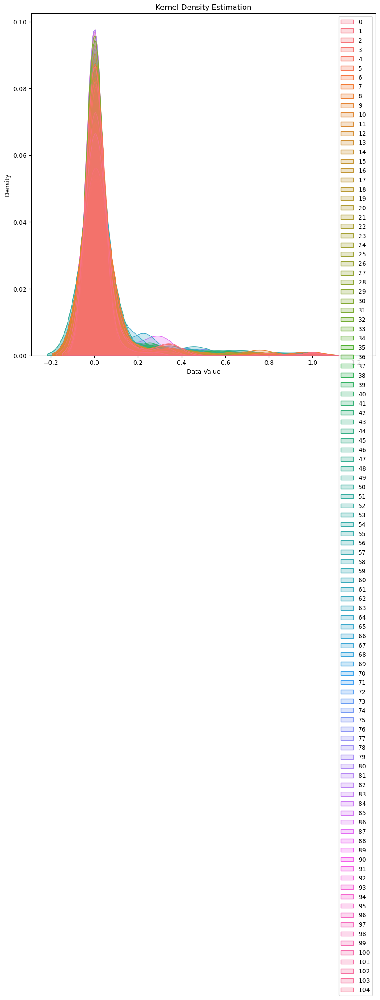

In [21]:
plt.figure(figsize=(10, 10))
sns.kdeplot(rbf_murda, fill=True)
plt.title('Kernel Density Estimation')
plt.xlabel('Data Value')
plt.ylabel('Density')
plt.show()

#### Matriks Hessian

In [22]:
hessian = np.zeros((len(rbf), len(rbf)))
hessian_ha = np.zeros((len(rbf_ngelegena), len(rbf_ngelegena)))
hessian_na = np.zeros((len(rbf_ngelegena), len(rbf_ngelegena)))
hessian_ca = np.zeros((len(rbf_ngelegena), len(rbf_ngelegena)))
hessian_ra = np.zeros((len(rbf_ngelegena), len(rbf_ngelegena)))
hessian_ka = np.zeros((len(rbf_ngelegena), len(rbf_ngelegena)))
hessian_da = np.zeros((len(rbf_ngelegena), len(rbf_ngelegena)))
hessian_ta = np.zeros((len(rbf_ngelegena), len(rbf_ngelegena)))
hessian_sa = np.zeros((len(rbf_ngelegena), len(rbf_ngelegena)))
hessian_wa = np.zeros((len(rbf_ngelegena), len(rbf_ngelegena)))
hessian_la = np.zeros((len(rbf_ngelegena), len(rbf_ngelegena)))
hessian_pa = np.zeros((len(rbf_ngelegena), len(rbf_ngelegena)))
hessian_dha = np.zeros((len(rbf_ngelegena), len(rbf_ngelegena)))
hessian_ja = np.zeros((len(rbf_ngelegena), len(rbf_ngelegena)))
hessian_ya = np.zeros((len(rbf_ngelegena), len(rbf_ngelegena)))
hessian_nya = np.zeros((len(rbf_ngelegena), len(rbf_ngelegena)))
hessian_ma = np.zeros((len(rbf_ngelegena), len(rbf_ngelegena)))
hessian_ga = np.zeros((len(rbf_ngelegena), len(rbf_ngelegena)))
hessian_ba = np.zeros((len(rbf_ngelegena), len(rbf_ngelegena)))
hessian_tha = np.zeros((len(rbf_ngelegena), len(rbf_ngelegena)))
hessian_nga = np.zeros((len(rbf_ngelegena), len(rbf_ngelegena)))
hessian_namurda = np.zeros((len(rbf_murda), len(rbf_murda)))
hessian_kamurda = np.zeros((len(rbf_murda), len(rbf_murda)))
hessian_tamurda = np.zeros((len(rbf_murda), len(rbf_murda)))
hessian_samurda = np.zeros((len(rbf_murda), len(rbf_murda)))
hessian_pamurda = np.zeros((len(rbf_murda), len(rbf_murda)))
hessian_gamurda = np.zeros((len(rbf_murda), len(rbf_murda)))
hessian_bamurda = np.zeros((len(rbf_murda), len(rbf_murda)))

In [23]:
lamda = 28

lamda_murda = 50

lamda_jenis = 20

for i in range(len(rbf)):
    for j in range(len(rbf)):
        hessian[i, j] = model[j][6] * model[i][6] * (rbf[i][j] + (pow(lamda_jenis, 2)))
        
for i in range(len(rbf_ngelegena)):
    for j in range(len(rbf_ngelegena)):
        hessian_ha[i, j] = model_ha[j][6] * model_ha[i][6] * (rbf_ngelegena[i][j] + (pow(lamda, 2)))
        hessian_na[i, j] = model_na[j][6] * model_na[i][6] * (rbf_ngelegena[i][j] + (pow(lamda, 2)))
        hessian_ca[i, j] = model_ca[j][6] * model_ca[i][6] * (rbf_ngelegena[i][j] + (pow(lamda, 2)))
        hessian_ra[i, j] = model_ra[j][6] * model_ra[i][6] * (rbf_ngelegena[i][j] + (pow(lamda, 2)))
        hessian_ka[i, j] = model_ka[j][6] * model_ka[i][6] * (rbf_ngelegena[i][j] + (pow(lamda, 2)))
        hessian_da[i, j] = model_da[j][6] * model_da[i][6] * (rbf_ngelegena[i][j] + (pow(lamda, 2)))
        hessian_ta[i, j] = model_ta[j][6] * model_ta[i][6] * (rbf_ngelegena[i][j] + (pow(lamda, 2)))       
        hessian_sa[i, j] = model_sa[j][6] * model_sa[i][6] * (rbf_ngelegena[i][j] + (pow(lamda, 2)))
        hessian_wa[i, j] = model_wa[j][6] * model_wa[i][6] * (rbf_ngelegena[i][j] + (pow(lamda, 2)))
        hessian_la[i, j] = model_la[j][6] * model_la[i][6] * (rbf_ngelegena[i][j] + (pow(lamda, 2)))
        hessian_pa[i, j] = model_pa[j][6] * model_pa[i][6] * (rbf_ngelegena[i][j] + (pow(lamda, 2)))
        hessian_dha[i, j] = model_dha[j][6] * model_dha[i][6] * (rbf_ngelegena[i][j] + (pow(lamda, 2)))
        hessian_ja[i, j] = model_ja[j][6] * model_ja[i][6] * (rbf_ngelegena[i][j] + (pow(lamda, 2)))
        hessian_ya[i, j] = model_ya[j][6] * model_ya[i][6] * (rbf_ngelegena[i][j] + (pow(lamda, 2)))
        hessian_nya[i, j] = model_nya[j][6] * model_nya[i][6] * (rbf_ngelegena[i][j] + (pow(lamda, 2)))
        hessian_ma[i, j] = model_ma[j][6] * model_ma[i][6] * (rbf_ngelegena[i][j] + (pow(lamda, 2)))
        hessian_ga[i, j] = model_ga[j][6] * model_ga[i][6] * (rbf_ngelegena[i][j] + (pow(lamda, 2)))
        hessian_ba[i, j] = model_ba[j][6] * model_ba[i][6] * (rbf_ngelegena[i][j] + (pow(lamda, 2)))
        hessian_tha[i, j] = model_tha[j][6] * model_tha[i][6] * (rbf_ngelegena[i][j] + (pow(lamda, 2)))
        hessian_nga[i, j] = model_nga[j][6] * model_nga[i][6] * (rbf_ngelegena[i][j] + (pow(lamda, 2)))
        
for i in range(len(rbf_murda)):
    for j in range(len(rbf_murda)):
        hessian_namurda[i, j] = model_namurda[j][6] * model_namurda[i][6] * (rbf_murda[i][j] + (pow(lamda_murda, 2)))
        hessian_kamurda[i, j] = model_kamurda[j][6] * model_kamurda[i][6] * (rbf_murda[i][j] + (pow(lamda_murda, 2)))
        hessian_tamurda[i, j] = model_tamurda[j][6] * model_tamurda[i][6] * (rbf_murda[i][j] + (pow(lamda_murda, 2)))
        hessian_samurda[i, j] = model_samurda[j][6] * model_samurda[i][6] * (rbf_murda[i][j] + (pow(lamda_murda, 2)))  
        hessian_pamurda[i, j] = model_pamurda[j][6] * model_pamurda[i][6] * (rbf_murda[i][j] + (pow(lamda_murda, 2)))
        hessian_gamurda[i, j] = model_gamurda[j][6] * model_gamurda[i][6] * (rbf_murda[i][j] + (pow(lamda_murda, 2)))  
        hessian_bamurda[i, j] = model_bamurda[j][6] * model_bamurda[i][6] * (rbf_murda[i][j] + (pow(lamda_murda, 2)))  

print("MATRIKS HESSIAN \n", hessian, "\n")
print("MATRIKS HESSIAN HA \n", hessian_ha, "\n")
print("MATRIKS HESSIAN NA MURDA \n", hessian_namurda)

MATRIKS HESSIAN 
 [[ 401.          400.00016352  400.06735673 ... -400.
  -400.         -400.        ]
 [ 400.00016352  401.          400.04000321 ... -400.
  -400.         -400.        ]
 [ 400.06735673  400.04000321  401.         ... -400.
  -400.         -400.        ]
 ...
 [-400.         -400.         -400.         ...  401.
   400.05191129  400.0592535 ]
 [-400.         -400.         -400.         ...  400.05191129
   401.          400.12654085]
 [-400.         -400.         -400.         ...  400.0592535
   400.12654085  401.        ]] 

MATRIKS HESSIAN HA 
 [[ 785.          784.00006691  784.0510846  ... -784.00154494
  -784.01208967 -784.0067132 ]
 [ 784.00006691  785.          784.02876137 ... -784.00035957
  -784.00032622 -784.00007226]
 [ 784.0510846   784.02876137  785.         ... -784.00145553
  -784.10290883 -784.00225398]
 ...
 [-784.00154494 -784.00035957 -784.00145553 ...  785.
   784.01734087  784.08746059]
 [-784.01208967 -784.00032622 -784.10290883 ...  784.017340

#### Mencari Nilai Ei, Delta Alpha dan Ai 

In [24]:
C_murda = 1
gamma_murda = 0.0001
epsilon_murda = 0.01

C = 1
gamma = 0.0001
epsilon = 0.01

C_jenis = 2
gamma_jenis = 0.0001
epsilon_jenis = 0.01

alpha = [0] * len(hessian)
delta_alpha = [0] * len(hessian)
temp_alpha = [0] * len(hessian)
ei = np.zeros(len(hessian))

alpha_ha = [0] * len(hessian_ha)
delta_alpha_ha = [0] * len(hessian_ha)
temp_alpha_ha = [0] * len(hessian_ha)
ei_ha = np.zeros(len(hessian_ha))

alpha_na = [0] * len(hessian_ha)
delta_alpha_na = [0] * len(hessian_ha)
temp_alpha_na = [0] * len(hessian_ha)
ei_na = np.zeros(len(hessian_ha))

alpha_ca = [0] * len(hessian_ha)
delta_alpha_ca = [0] * len(hessian_ha)
temp_alpha_ca = [0] * len(hessian_ha)
ei_ca = np.zeros(len(hessian_ha))

alpha_ra = [0] * len(hessian_ha)
delta_alpha_ra = [0] * len(hessian_ha)
temp_alpha_ra = [0] * len(hessian_ha)
ei_ra = np.zeros(len(hessian_ha))

alpha_ka = [0] * len(hessian_ha)
delta_alpha_ka = [0] * len(hessian_ha)
temp_alpha_ka = [0] * len(hessian_ha)
ei_ka = np.zeros(len(hessian_ha))

alpha_da = [0] * len(hessian_ha)
delta_alpha_da = [0] * len(hessian_ha)
temp_alpha_da = [0] * len(hessian_ha)
ei_da = np.zeros(len(hessian_ha))

alpha_ta = [0] * len(hessian_ha)
delta_alpha_ta = [0] * len(hessian_ha)
temp_alpha_ta = [0] * len(hessian_ha)
ei_ta = np.zeros(len(hessian_ha))

alpha_sa = [0] * len(hessian_ha)
delta_alpha_sa = [0] * len(hessian_ha)
temp_alpha_sa = [0] * len(hessian_ha)
ei_sa = np.zeros(len(hessian_ha))

alpha_wa = [0] * len(hessian_ha)
delta_alpha_wa = [0] * len(hessian_ha)
temp_alpha_wa = [0] * len(hessian_ha)
ei_wa = np.zeros(len(hessian_ha))

alpha_la = [0] * len(hessian_ha)
delta_alpha_la = [0] * len(hessian_ha)
temp_alpha_la = [0] * len(hessian_ha)
ei_la = np.zeros(len(hessian_ha))

alpha_pa = [0] * len(hessian_ha)
delta_alpha_pa = [0] * len(hessian_ha)
temp_alpha_pa = [0] * len(hessian_ha)
ei_pa = np.zeros(len(hessian_ha))

alpha_dha = [0] * len(hessian_ha)
delta_alpha_dha = [0] * len(hessian_ha)
temp_alpha_dha = [0] * len(hessian_ha)
ei_dha = np.zeros(len(hessian_ha))

alpha_ja = [0] * len(hessian_ha)
delta_alpha_ja = [0] * len(hessian_ha)
temp_alpha_ja = [0] * len(hessian_ha)
ei_ja = np.zeros(len(hessian_ha))

alpha_ya = [0] * len(hessian_ha)
delta_alpha_ya = [0] * len(hessian_ha)
temp_alpha_ya = [0] * len(hessian_ha)
ei_ya = np.zeros(len(hessian_ha))

alpha_nya = [0] * len(hessian_ha)
delta_alpha_nya = [0] * len(hessian_ha)
temp_alpha_nya = [0] * len(hessian_ha)
ei_nya = np.zeros(len(hessian_ha))

alpha_ma = [0] * len(hessian_ha)
delta_alpha_ma = [0] * len(hessian_ha)
temp_alpha_ma = [0] * len(hessian_ha)
ei_ma = np.zeros(len(hessian_ha))

alpha_ga = [0] * len(hessian_ha)
delta_alpha_ga = [0] * len(hessian_ha)
temp_alpha_ga = [0] * len(hessian_ha)
ei_ga = np.zeros(len(hessian_ha))

alpha_ba = [0] * len(hessian_ha)
delta_alpha_ba = [0] * len(hessian_ha)
temp_alpha_ba = [0] * len(hessian_ha)
ei_ba = np.zeros(len(hessian_ha))

alpha_tha = [0] * len(hessian_ha)
delta_alpha_tha = [0] * len(hessian_ha)
temp_alpha_tha = [0] * len(hessian_ha)
ei_tha = np.zeros(len(hessian_ha))

alpha_nga = [0] * len(hessian_ha)
delta_alpha_nga = [0] * len(hessian_ha)
temp_alpha_nga = [0] * len(hessian_ha)
ei_nga = np.zeros(len(hessian_ha))

alpha_namurda = [0] * len(hessian_namurda)
delta_alpha_namurda = [0] * len(hessian_namurda)
temp_alpha_namurda = [0] * len(hessian_namurda)
ei_namurda = np.zeros(len(hessian_namurda))

alpha_kamurda = [0] * len(hessian_namurda)
delta_alpha_kamurda = [0] * len(hessian_namurda)
temp_alpha_kamurda = [0] * len(hessian_namurda)
ei_kamurda = np.zeros(len(hessian_namurda))

alpha_tamurda = [0] * len(hessian_namurda)
delta_alpha_tamurda = [0] * len(hessian_namurda)
temp_alpha_tamurda = [0] * len(hessian_namurda)
ei_tamurda = np.zeros(len(hessian_namurda))

alpha_samurda = [0] * len(hessian_namurda)
delta_alpha_samurda = [0] * len(hessian_namurda)
temp_alpha_samurda = [0] * len(hessian_namurda)
ei_samurda = np.zeros(len(hessian_namurda))

alpha_pamurda = [0] * len(hessian_namurda)
delta_alpha_pamurda = [0] * len(hessian_namurda)
temp_alpha_pamurda = [0] * len(hessian_namurda)
ei_pamurda = np.zeros(len(hessian_namurda))

alpha_gamurda = [0] * len(hessian_namurda)
delta_alpha_gamurda = [0] * len(hessian_namurda)
temp_alpha_gamurda = [0] * len(hessian_namurda)
ei_gamurda = np.zeros(len(hessian_namurda))

alpha_bamurda = [0] * len(hessian_namurda)
delta_alpha_bamurda = [0] * len(hessian_namurda)
temp_alpha_bamurda = [0] * len(hessian_namurda)
ei_bamurda = np.zeros(len(hessian_namurda))

In [25]:
iterasi = 0

while iterasi < 20:
    if delta_alpha[iterasi] <= epsilon_jenis:
        for i in range(len(hessian)):
            for j in range(len(hessian)):
                ei[i] += (temp_alpha[j] * hessian[i][j])

            delta_alpha[i] = min(max((gamma_jenis * (1 - ei[i])), alpha[i]), C_jenis - alpha[i])
            alpha[i] = alpha[i] + delta_alpha[i]

        for i in range(len(alpha)):
            temp_alpha[i] = alpha[i]
        iterasi += 1
    else:
        break
        
while iterasi < 20:
    if delta_alpha_ha[iterasi] <= epsilon:
        for i in range(len(hessian_ha)):
            for j in range(len(hessian_ha)):
                ei_ha[i] += (temp_alpha_ha[j] * hessian_ha[i][j])

            delta_alpha_ha[i] = min(max((gamma * (1 - ei_ha[i])), alpha_ha[i]), C - alpha_ha[i])
            alpha_ha[i] = alpha_ha[i] + delta_alpha_ha[i]

        for i in range(len(alpha_ha)):
            temp_alpha_ha[i] = alpha_ha[i]
        iterasi += 1
    else:
        break

iterasi = 0
while iterasi < 20:
    if delta_alpha_na[iterasi] <= epsilon:
        for i in range(len(hessian_na)):
            for j in range(len(hessian_na)):
                ei_na[i] += (temp_alpha_na[j] * hessian_na[i][j])

            delta_alpha_na[i] = min(max((gamma * (1 - ei_na[i])), alpha_na[i]), C - alpha_na[i])
            alpha_na[i] = alpha_na[i] + delta_alpha_na[i]
        
        for i in range(len(alpha_na)):
            temp_alpha_na[i] = alpha_na[i]
        iterasi += 1
    else:
        break
    
iterasi = 0
while iterasi < 20:
    if delta_alpha_ca[iterasi] <= epsilon:
        for i in range(len(hessian_ca)):
            for j in range(len(hessian_ca)):
                ei_ca[i] += (temp_alpha_ca[j] * hessian_ca[i][j])

            delta_alpha_ca[i] = min(max((gamma * (1 - ei_ca[i])), alpha_ca[i]), C - alpha_ca[i])
            alpha_ca[i] = alpha_ca[i] + delta_alpha_ca[i]
        
        for i in range(len(alpha_ca)):
            temp_alpha_ca[i] = alpha_ca[i]
        iterasi += 1
    else:
        break

iterasi = 0
while iterasi < 20:
    if delta_alpha_ra[iterasi] <= epsilon:
        for i in range(len(hessian_ra)):
            for j in range(len(hessian_ra)):
                ei_ra[i] += (temp_alpha_ra[j] * hessian_ra[i][j])

            delta_alpha_ra[i] = min(max((gamma * (1 - ei_ra[i])), alpha_ra[i]), C - alpha_ra[i])
            alpha_ra[i] = alpha_ra[i] + delta_alpha_ra[i]

        for i in range(len(alpha_ra)):
            temp_alpha_ra[i] = alpha_ra[i]
        iterasi += 1
    else:
        break
        
iterasi = 0
while iterasi < 20:
    if delta_alpha_ka[iterasi] <= epsilon:
        for i in range(len(hessian_ka)):
            for j in range(len(hessian_ka)):
                ei_ka[i] += (temp_alpha_ka[j] * hessian_ka[i][j])

            delta_alpha_ka[i] = min(max((gamma * (1 - ei_ka[i])), alpha_ka[i]), C - alpha_ka[i])
            alpha_ka[i] = alpha_ka[i] + delta_alpha_ka[i]

        for i in range(len(alpha_ka)):
            temp_alpha_ka[i] = alpha_ka[i]
        iterasi += 1
    else:
        break
        
iterasi = 0
while iterasi < 20:
    if delta_alpha_da[iterasi] <= epsilon:
        for i in range(len(hessian_da)):
            for j in range(len(hessian_da)):
                ei_da[i] += (temp_alpha_da[j] * hessian_da[i][j])

            delta_alpha_da[i] = min(max((gamma * (1 - ei_da[i])), alpha_da[i]), C - alpha_da[i])
            alpha_da[i] = alpha_da[i] + delta_alpha_da[i]

        for i in range(len(alpha_da)):
            temp_alpha_da[i] = alpha_da[i]
        iterasi += 1
    else:
        break

iterasi = 0
while iterasi < 20:
    if delta_alpha_ta[iterasi] <= epsilon:
        for i in range(len(hessian_ta)):
            for j in range(len(hessian_ta)):
                ei_ta[i] += (temp_alpha_ta[j] * hessian_ta[i][j])

            delta_alpha_ta[i] = min(max((gamma * (1 - ei_ta[i])), alpha_ta[i]), C - alpha_ta[i])
            alpha_ta[i] = alpha_ta[i] + delta_alpha_ta[i]

        for i in range(len(alpha_ta)):
            temp_alpha_ta[i] = alpha_ta[i]
        iterasi += 1
    else:
        break
        
iterasi = 0
while iterasi < 20:
    if delta_alpha_sa[iterasi] <= epsilon:
        for i in range(len(hessian_sa)):
            for j in range(len(hessian_sa)):
                ei_sa[i] += (temp_alpha_sa[j] * hessian_sa[i][j])

            delta_alpha_sa[i] = min(max((gamma * (1 - ei_sa[i])), alpha_sa[i]), C - alpha_sa[i])
            alpha_sa[i] = alpha_sa[i] + delta_alpha_sa[i]

        for i in range(len(alpha_sa)):
            temp_alpha_sa[i] = alpha_sa[i]
        iterasi += 1
    else:
        break
        
iterasi = 0
while iterasi < 20:
    if delta_alpha_wa[iterasi] <= epsilon:
        for i in range(len(hessian_wa)):
            for j in range(len(hessian_wa)):
                ei_wa[i] += (temp_alpha_wa[j] * hessian_wa[i][j])

            delta_alpha_wa[i] = min(max((gamma * (1 - ei_wa[i])), alpha_wa[i]), C - alpha_wa[i])
            alpha_wa[i] = alpha_wa[i] + delta_alpha_wa[i]

        for i in range(len(alpha_wa)):
            temp_alpha_wa[i] = alpha_wa[i]
        iterasi += 1
    else:
        break
        
iterasi = 0
while iterasi < 20:
    if delta_alpha_la[iterasi] <= epsilon:
        for i in range(len(hessian_la)):
            for j in range(len(hessian_la)):
                ei_la[i] += (temp_alpha_la[j] * hessian_la[i][j])

            delta_alpha_la[i] = min(max((gamma * (1 - ei_la[i])), alpha_la[i]), C - alpha_la[i])
            alpha_la[i] = alpha_la[i] + delta_alpha_la[i]

        for i in range(len(alpha_la)):
            temp_alpha_la[i] = alpha_la[i]
        iterasi += 1
    else:
        break
        
iterasi = 0
while iterasi < 20:
    if delta_alpha_pa[iterasi] <= epsilon:
        for i in range(len(hessian_pa)):
            for j in range(len(hessian_pa)):
                ei_pa[i] += (temp_alpha_pa[j] * hessian_pa[i][j])

            delta_alpha_pa[i] = min(max((gamma * (1 - ei_pa[i])), alpha_pa[i]), C - alpha_pa[i])
            alpha_pa[i] = alpha_pa[i] + delta_alpha_pa[i]

        for i in range(len(alpha_pa)):
            temp_alpha_pa[i] = alpha_pa[i]
        iterasi += 1
    else:
        break
        
iterasi = 0
while iterasi < 20:
    if delta_alpha_dha[iterasi] <= epsilon:
        for i in range(len(hessian_dha)):
            for j in range(len(hessian_dha)):
                ei_dha[i] += (temp_alpha_dha[j] * hessian_dha[i][j])

            delta_alpha_dha[i] = min(max((gamma * (1 - ei_dha[i])), alpha_dha[i]), C - alpha_dha[i])
            alpha_dha[i] = alpha_dha[i] + delta_alpha_dha[i]

        for i in range(len(alpha_dha)):
            temp_alpha_dha[i] = alpha_dha[i]
        iterasi += 1
    else:
        break
        
iterasi = 0
while iterasi < 20:
    if delta_alpha_ja[iterasi] <= epsilon:
        for i in range(len(hessian_ja)):
            for j in range(len(hessian_ja)):
                ei_ja[i] += (temp_alpha_ja[j] * hessian_ja[i][j])

            delta_alpha_ja[i] = min(max((gamma * (1 - ei_ja[i])), alpha_ja[i]), C - alpha_ja[i])
            alpha_ja[i] = alpha_ja[i] + delta_alpha_ja[i]

        for i in range(len(alpha_ja)):
            temp_alpha_ja[i] = alpha_ja[i]
        iterasi += 1
    else:
        break

iterasi = 0
while iterasi < 20:
    if delta_alpha_ya[iterasi] <= epsilon:
        for i in range(len(hessian_ya)):
            for j in range(len(hessian_ya)):
                ei_ya[i] += (temp_alpha_ya[j] * hessian_ya[i][j])

            delta_alpha_ya[i] = min(max((gamma * (1 - ei_ya[i])), alpha_ya[i]), C - alpha_ya[i])
            alpha_ya[i] = alpha_ya[i] + delta_alpha_ya[i]

        for i in range(len(alpha_ya)):
            temp_alpha_ya[i] = alpha_ya[i]
        iterasi += 1
    else:
        break
        
iterasi = 0
while iterasi < 20:
    if delta_alpha_nya[iterasi] <= epsilon:
        for i in range(len(hessian_nya)):
            for j in range(len(hessian_nya)):
                ei_nya[i] += (temp_alpha_nya[j] * hessian_nya[i][j])

            delta_alpha_nya[i] = min(max((gamma * (1 - ei_nya[i])), alpha_nya[i]), C - alpha_nya[i])
            alpha_nya[i] = alpha_nya[i] + delta_alpha_nya[i]

        for i in range(len(alpha_nya)):
            temp_alpha_nya[i] = alpha_nya[i]
        iterasi += 1
    else:
        break
        
iterasi = 0
while iterasi < 20:
    if delta_alpha_ma[iterasi] <= epsilon:
        for i in range(len(hessian_ma)):
            for j in range(len(hessian_ma)):
                ei_ma[i] += (temp_alpha_ma[j] * hessian_ma[i][j])

            delta_alpha_ma[i] = min(max((gamma * (1 - ei_ma[i])), alpha_ma[i]), C - alpha_ma[i])
            alpha_ma[i] = alpha_ma[i] + delta_alpha_ma[i]

        for i in range(len(alpha_ma)):
            temp_alpha_ma[i] = alpha_ma[i]
        iterasi += 1
    else:
        break
        
iterasi = 0
while iterasi < 20:
    if delta_alpha_ga[iterasi] <= epsilon:
        for i in range(len(hessian_ga)):
            for j in range(len(hessian_ga)):
                ei_ga[i] += (temp_alpha_ga[j] * hessian_ga[i][j])

            delta_alpha_ga[i] = min(max((gamma * (1 - ei_ga[i])), alpha_ga[i]), C - alpha_ga[i])
            alpha_ga[i] = alpha_ga[i] + delta_alpha_ga[i]

        for i in range(len(alpha_ga)):
            temp_alpha_ga[i] = alpha_ga[i]
        iterasi += 1
    else:
        break
    
        
iterasi = 0
while iterasi < 20:
    if delta_alpha_ba[iterasi] <= epsilon:
        for i in range(len(hessian_ba)):
            for j in range(len(hessian_ba)):
                ei_ba[i] += (temp_alpha_ba[j] * hessian_ba[i][j])

            delta_alpha_ba[i] = min(max((gamma * (1 - ei_ba[i])), alpha_ba[i]), C - alpha_ba[i])
            alpha_ba[i] = alpha_ba[i] + delta_alpha_ba[i]

        for i in range(len(alpha_ba)):
            temp_alpha_ba[i] = alpha_ba[i]
        iterasi += 1
    else:
        break
        
iterasi = 0
while iterasi < 20:
    if delta_alpha_tha[iterasi] <= epsilon:
        for i in range(len(hessian_tha)):
            for j in range(len(hessian_tha)):
                ei_tha[i] += (temp_alpha_tha[j] * hessian_tha[i][j])

            delta_alpha_tha[i] = min(max((gamma * (1 - ei_tha[i])), alpha_tha[i]), C - alpha_tha[i])
            alpha_tha[i] = alpha_tha[i] + delta_alpha_tha[i]

        for i in range(len(alpha_tha)):
            temp_alpha_tha[i] = alpha_tha[i]
        iterasi += 1
    else:
        break
        
iterasi = 0
while iterasi < 20:
    if delta_alpha_nga[iterasi] <= epsilon:
        for i in range(len(hessian_nga)):
            for j in range(len(hessian_nga)):
                ei_nga[i] += (temp_alpha_nga[j] * hessian_nga[i][j])

            delta_alpha_nga[i] = min(max((gamma * (1 - ei_nga[i])), alpha_nga[i]), C - alpha_nga[i])
            alpha_nga[i] = alpha_nga[i] + delta_alpha_nga[i]

        for i in range(len(alpha_nga)):
            temp_alpha_nga[i] = alpha_nga[i]
        iterasi += 1
    else:
        break
        
iterasi = 0
while iterasi < 20:
    if delta_alpha_namurda[iterasi] <= epsilon_murda:
        for i in range(len(hessian_namurda)):
            for j in range(len(hessian_namurda)):
                ei_namurda[i] += (temp_alpha_namurda[j] * hessian_namurda[i][j])

            delta_alpha_namurda[i] = min(max((gamma_murda * (1 - ei_namurda[i])), alpha_namurda[i]), C_murda - alpha_namurda[i])
            alpha_namurda[i] = alpha_namurda[i] + delta_alpha_namurda[i]

        for i in range(len(alpha_namurda)):
            temp_alpha_namurda[i] = alpha_namurda[i]
        iterasi += 1
    else:
        break
        
iterasi = 0
while iterasi < 20:
    if delta_alpha_kamurda[iterasi] <= epsilon_murda:
        for i in range(len(hessian_kamurda)):
            for j in range(len(hessian_kamurda)):
                ei_kamurda[i] += (temp_alpha_kamurda[j] * hessian_kamurda[i][j])

            delta_alpha_kamurda[i] = min(max((gamma_murda * (1 - ei_kamurda[i])), alpha_kamurda[i]), C_murda - alpha_kamurda[i])
            alpha_kamurda[i] = alpha_kamurda[i] + delta_alpha_kamurda[i]

        for i in range(len(alpha_kamurda)):
            temp_alpha_kamurda[i] = alpha_kamurda[i]
        iterasi += 1
    else:
        break
    
iterasi = 0
while iterasi < 20:
    if delta_alpha_tamurda[iterasi] <= epsilon_murda:
        for i in range(len(hessian_tamurda)):
            for j in range(len(hessian_tamurda)):
                ei_tamurda[i] += (temp_alpha_tamurda[j] * hessian_tamurda[i][j])

            delta_alpha_tamurda[i] = min(max((gamma_murda * (1 - ei_tamurda[i])), alpha_tamurda[i]), C_murda - alpha_tamurda[i])
            alpha_tamurda[i] = alpha_tamurda[i] + delta_alpha_tamurda[i]

        for i in range(len(alpha_tamurda)):
            temp_alpha_tamurda[i] = alpha_tamurda[i]
        iterasi += 1
    else:
        break
        
iterasi = 0
while iterasi < 20:
    if delta_alpha_samurda[iterasi] <= epsilon_murda:
        for i in range(len(hessian_samurda)):
            for j in range(len(hessian_samurda)):
                ei_samurda[i] += (temp_alpha_samurda[j] * hessian_samurda[i][j])

            delta_alpha_samurda[i] = min(max((gamma_murda * (1 - ei_samurda[i])), alpha_samurda[i]), C_murda - alpha_samurda[i])
            alpha_samurda[i] = alpha_samurda[i] + delta_alpha_samurda[i]

        for i in range(len(alpha_samurda)):
            temp_alpha_samurda[i] = alpha_samurda[i]
        iterasi += 1
    else:
        break
        
iterasi = 0
while iterasi < 20:
    if delta_alpha_pamurda[iterasi] <= epsilon_murda:
        for i in range(len(hessian_pamurda)):
            for j in range(len(hessian_pamurda)):
                ei_pamurda[i] += (temp_alpha_pamurda[j] * hessian_pamurda[i][j])

            delta_alpha_pamurda[i] = min(max((gamma_murda * (1 - ei_pamurda[i])), alpha_pamurda[i]), C_murda - alpha_pamurda[i])
            alpha_pamurda[i] = alpha_pamurda[i] + delta_alpha_pamurda[i]

        for i in range(len(alpha_pamurda)):
            temp_alpha_pamurda[i] = alpha_pamurda[i]
        iterasi += 1
    else:
        break
        
iterasi = 0
while iterasi < 20:
    if delta_alpha_gamurda[iterasi] <= epsilon_murda:
        for i in range(len(hessian_gamurda)):
            for j in range(len(hessian_gamurda)):
                ei_gamurda[i] += (temp_alpha_gamurda[j] * hessian_gamurda[i][j])

            delta_alpha_gamurda[i] = min(max((gamma_murda * (1 - ei_gamurda[i])), alpha_gamurda[i]), C_murda - alpha_gamurda[i])
            alpha_gamurda[i]  = alpha_gamurda[i] + delta_alpha_gamurda[i]

        for i in range(len(alpha_gamurda)):
            temp_alpha_gamurda[i] = alpha_gamurda[i]
        iterasi += 1
    else:
        break
        
iterasi = 0
while iterasi < 20:
    if delta_alpha_bamurda[iterasi] <= epsilon_murda:
        for i in range(len(hessian_bamurda)):
            for j in range(len(hessian_bamurda)):
                ei_bamurda[i] += (temp_alpha_bamurda[j] * hessian_bamurda[i][j])

            delta_alpha_bamurda[i] = min(max((gamma_murda * (1 - ei_bamurda[i])), alpha_bamurda[i]), C_murda - alpha_bamurda[i])
            alpha_bamurda[i] = alpha_bamurda[i] + delta_alpha_bamurda[i]

        for i in range(len(alpha_bamurda)):
            temp_alpha_bamurda[i] = alpha_bamurda[i]
        iterasi += 1
    else:
        break

print("Ei BINARY \n", ei, "\n")
print("Ai BINARY \n", alpha, "\n")
print("DELTA ALPHA BINARY \n", delta_alpha, "\n")
print("Ei HA \n", ei_ha, "\n")
print("Ai HA \n", alpha_ha, "\n")
print("DELTA ALPHA HA \n", delta_alpha_ha, "\n")
print("Ei NA MURDA \n", ei_namurda, "\n")
print("Ai NA MURDA \n", alpha_namurda, "\n")
print("DELTA ALPHA NA MURDA \n", delta_alpha_namurda)

Ei BINARY 
 [-137.22807781 -137.40055634 -137.31850327 -137.31981847 -137.34606754
 -137.22336442 -137.25528655 -137.25790775 -137.2945324  -137.25620302
 -137.35490937 -137.27621688 -137.38003286 -137.38983843 -137.41781666
 -137.37861884 -137.44569863 -137.36732639 -137.33852703 -137.3762074
 -137.37382966 -137.41212554 -137.32685191 -137.3173016  -137.33960018
 -137.32041264 -137.42765604 -137.28336936 -137.37025974 -137.32493742
 -137.47322689 -137.38658082 -137.33951855 -137.34986365 -137.43111908
 -137.44336944 -137.41070345 -137.30452851 -137.40203082 -137.40242055
 -137.4227908  -137.40259577 -137.31469588 -137.40113962 -137.39281118
 -137.41137939 -137.39736697 -137.37560119 -137.37613683 -137.4053241
 -137.38147244 -137.39052117 -137.36568863 -137.39879038 -137.38904702
 -137.41019556 -137.39350657 -137.37712691 -137.40024604 -137.3892664
 -137.33620822 -137.32015612 -137.34630596 -137.40238454 -137.31960246
 -137.36797854 -137.31469603 -137.35872235 -137.32206387 -137.350268

#### Mencari Nilai Bobot Max Positif dan Max Negatif dari Array Ai

In [26]:
positif = [0] * len(model)
negatif = [0] * len(model)

positif_ha = [0] * len(model_ha)
negatif_ha = [0] * len(model_ha)
positif_na = [0] * len(model_ha)
negatif_na = [0] * len(model_ha)
positif_ca = [0] * len(model_ha)
negatif_ca = [0] * len(model_ha)
positif_ra = [0] * len(model_ha)
negatif_ra = [0] * len(model_ha)
positif_ka = [0] * len(model_ha)
negatif_ka = [0] * len(model_ha)
positif_da = [0] * len(model_ha)
negatif_da = [0] * len(model_ha)
positif_ta = [0] * len(model_ha)
negatif_ta = [0] * len(model_ha)
positif_sa = [0] * len(model_ha)
negatif_sa = [0] * len(model_ha)
positif_wa = [0] * len(model_ha)
negatif_wa = [0] * len(model_ha)
positif_la = [0] * len(model_ha)
negatif_la = [0] * len(model_ha)
positif_pa = [0] * len(model_ha)
negatif_pa = [0] * len(model_ha)
positif_dha = [0] * len(model_ha)
negatif_dha = [0] * len(model_ha)
positif_ja = [0] * len(model_ha)
negatif_ja = [0] * len(model_ha)
positif_ya = [0] * len(model_ha)
negatif_ya = [0] * len(model_ha)
positif_nya = [0] * len(model_ha)
negatif_nya = [0] * len(model_ha)
positif_ma = [0] * len(model_ha)
negatif_ma = [0] * len(model_ha)
positif_ga = [0] * len(model_ha)
negatif_ga = [0] * len(model_ha)
positif_ba = [0] * len(model_ha)
negatif_ba = [0] * len(model_ha)
positif_tha = [0] * len(model_ha)
negatif_tha = [0] * len(model_ha)
positif_nga = [0] * len(model_ha)
negatif_nga = [0] * len(model_ha)

positif_namurda = [0] * len(model_namurda)
negatif_namurda = [0] * len(model_namurda)
positif_kamurda = [0] * len(model_namurda)
negatif_kamurda = [0] * len(model_namurda)
positif_tamurda = [0] * len(model_namurda)
negatif_tamurda = [0] * len(model_namurda)
positif_samurda = [0] * len(model_namurda)
negatif_samurda = [0] * len(model_namurda)
positif_pamurda = [0] * len(model_namurda)
negatif_pamurda = [0] * len(model_namurda)
positif_gamurda = [0] * len(model_namurda)
negatif_gamurda = [0] * len(model_namurda)
positif_bamurda = [0] * len(model_namurda)
negatif_bamurda = [0] * len(model_namurda)

In [27]:
for i in range(len(model)):
    if model[i][6] == 1:
        positif[i] = alpha[i]
    else :
        negatif[i] = alpha[i]
        
for i in range(len(model_ha)):
    if model_ha[i][6] == 1:
        positif_ha[i] = alpha_ha[i]
    else :
        negatif_ha[i] = alpha_ha[i]
        
for i in range(len(model_ha)):
    if model_na[i][6] == 1:
        positif_na[i] = alpha_na[i]
    else :
        negatif_na[i] = alpha_na[i]
        
for i in range(len(model_ha)):
    if model_ca[i][6] == 1:
        positif_ca[i] = alpha_ca[i]
    else :
        negatif_ca[i] = alpha_ca[i]
        
for i in range(len(model_ha)):
    if model_ra[i][6] == 1:
        positif_ra[i] = alpha_ra[i]
    else :
        negatif_ra[i] = alpha_ra[i]
        
for i in range(len(model_ha)):
    if model_ka[i][6] == 1:
        positif_ka[i] = alpha_ka[i]
    else :
        negatif_ka[i] = alpha_ka[i]
        
for i in range(len(model_ha)):
    if model_da[i][6] == 1:
        positif_da[i] = alpha_da[i]
    else :
        negatif_da[i] = alpha_da[i]
        
for i in range(len(model_ha)):
    if model_ta[i][6] == 1:
        positif_ta[i] = alpha_ta[i]
    else :
        negatif_ta[i] = alpha_ta[i]
        
for i in range(len(model_ha)):
    if model_sa[i][6] == 1:
        positif_sa[i] = alpha_sa[i]
    else :
        negatif_sa[i] = alpha_sa[i]   
        
for i in range(len(model_ha)):
    if model_wa[i][6] == 1:
        positif_wa[i] = alpha_wa[i]
    else :
        negatif_wa[i] = alpha_wa[i]
        
for i in range(len(model_ha)):
    if model_la[i][6] == 1:
        positif_la[i] = alpha_la[i]
    else :
        negatif_la[i] = alpha_la[i]
        
for i in range(len(model_ha)):
    if model_pa[i][6] == 1:
        positif_pa[i] = alpha_pa[i]
    else :
        negatif_pa[i] = alpha_pa[i]
        
for i in range(len(model_ha)):
    if model_dha[i][6] == 1:
        positif_dha[i] = alpha_dha[i]
    else :
        negatif_dha[i] = alpha_dha[i]
        
for i in range(len(model_ha)):
    if model_ja[i][6] == 1:
        positif_ja[i] = alpha_ja[i]
    else :
        negatif_ja[i] = alpha_ja[i]
        
for i in range(len(model_ha)):
    if model_ya[i][6] == 1:
        positif_ya[i] = alpha_ya[i]
    else :
        negatif_ya[i] = alpha_ya[i]
        
for i in range(len(model_ha)):
    if model_nya[i][6] == 1:
        positif_nya[i] = alpha_nya[i]
    else :
        negatif_nya[i] = alpha_nya[i]
        
for i in range(len(model_ha)):
    if model_ma[i][6] == 1:
        positif_ma[i] = alpha_ma[i]
    else :
        negatif_ma[i] = alpha_ma[i]
        
for i in range(len(model_ha)):
    if model_ga[i][6] == 1:
        positif_ga[i] = alpha_ga[i]
    else :
        negatif_ga[i] = alpha_ga[i]
        
for i in range(len(model_ha)):
    if model_ba[i][6] == 1:
        positif_ba[i] = alpha_ba[i]
    else :
        negatif_ba[i] = alpha_ba[i]
        
for i in range(len(model_ha)):
    if model_tha[i][6] == 1:
        positif_tha[i] = alpha_tha[i]
    else :
        negatif_tha[i] = alpha_tha[i]
        
for i in range(len(model_ha)):
    if model_nga[i][6] == 1:
        positif_nga[i] = alpha_nga[i]
    else :
        negatif_nga[i] = alpha_nga[i]
        
for i in range(len(model_namurda)):
    if model_namurda[i][6] == 1:
        positif_namurda[i] = alpha_namurda[i]
    else :
        negatif_namurda[i] = alpha_namurda[i]
        
for i in range(len(model_namurda)):
    if model_kamurda[i][6] == 1:
        positif_kamurda[i] = alpha_kamurda[i]
    else :
        negatif_kamurda[i] = alpha_kamurda[i]
        
for i in range(len(model_namurda)):
    if model_tamurda[i][6] == 1:
        positif_tamurda[i] = alpha_tamurda[i]
    else :
        negatif_tamurda[i] = alpha_tamurda[i]
        
for i in range(len(model_namurda)):
    if model_samurda[i][6] == 1:
        positif_samurda[i] = alpha_samurda[i]
    else :
        negatif_samurda[i] = alpha_samurda[i]   
        
for i in range(len(model_namurda)):
    if model_pamurda[i][6] == 1:
        positif_pamurda[i] = alpha_pamurda[i]
    else :
        negatif_pamurda[i] = alpha_pamurda[i]
        
for i in range(len(model_namurda)):
    if model_gamurda[i][6] == 1:
        positif_gamurda[i] = alpha_gamurda[i]
    else :
        negatif_gamurda[i] = alpha_gamurda[i]
        
for i in range(len(model_namurda)):
    if model_bamurda[i][6] == 1:
        positif_bamurda[i] = alpha_bamurda[i]
    else :
        negatif_bamurda[i] = alpha_bamurda[i]
        
print("POSITIF \n", positif, "\n")
print("NEGATIF \n", negatif, "\n")
print("POSITIF HA \n", positif_ha, "\n")
print("NEGATIF HA \n", negatif_ha, "\n")
print("POSITIF NA MURDA \n", positif_namurda, "\n")
print("NEGATIF NA MURDA \n", negatif_namurda)

POSITIF 
 [0.023707989388620586, 0.023727556093330417, 0.02371823733055284, 0.02371829396460504, 0.023721316554841443, 0.023707455075136392, 0.023711070973811983, 0.02371135638849188, 0.023715461217210902, 0.023711184249957565, 0.02372237616948929, 0.02371343198533816, 0.023725242522978314, 0.02372623217715367, 0.023729374659423992, 0.02372491893386934, 0.023732577926790323, 0.02372367356208316, 0.023720432080694107, 0.02372464698922241, 0.02372438085617607, 0.02372877283496331, 0.023719084573302674, 0.02371802555863298, 0.02372052023975065, 0.023718362709785796, 0.023730501837772727, 0.023714195213171137, 0.0237240075709725, 0.023718904118720116, 0.023735849551695845, 0.023725845164221084, 0.02372063184661828, 0.023721726779999557, 0.023731006496099875, 0.02373240826128515, 0.023728537610477423, 0.02371660657748082, 0.023727610543170602, 0.023727612062093555, 0.02372995468420553, 0.023727622920048833, 0.0237177377791013, 0.023727551356052444, 0.02372652836986122, 0.023728628245042904,

In [28]:
wxplus = max(positif)
wxmin = max(negatif)
indwxplus = positif.index(wxplus)
indwxmin = negatif.index(wxmin)

wxplus_ha = max(positif_ha)
wxmin_ha = max(negatif_ha)
indwxplus_ha = positif_ha.index(wxplus_ha)
indwxmin_ha = negatif_ha.index(wxmin_ha)

wxplus_na = max(positif_na)
wxmin_na = max(negatif_na)
indwxplus_na = positif_na.index(wxplus_na)
indwxmin_na = negatif_na.index(wxmin_na)

wxplus_ca = max(positif_ca)
wxmin_ca = max(negatif_ca)
indwxplus_ca = positif_ca.index(wxplus_ca)
indwxmin_ca = negatif_ca.index(wxmin_ca)

wxplus_ra = max(positif_ra)
wxmin_ra = max(negatif_ra)
indwxplus_ra = positif_ra.index(wxplus_ra)
indwxmin_ra = negatif_ra.index(wxmin_ra)

wxplus_ka = max(positif_ka)
wxmin_ka = max(negatif_ka)
indwxplus_ka = positif_ka.index(wxplus_ka)
indwxmin_ka = negatif_ka.index(wxmin_ka)

wxplus_da = max(positif_da)
wxmin_da = max(negatif_da)
indwxplus_da = positif_da.index(wxplus_da)
indwxmin_da = negatif_da.index(wxmin_da)

wxplus_ta = max(positif_ta)
wxmin_ta = max(negatif_ta)
indwxplus_ta = positif_ta.index(wxplus_ta)
indwxmin_ta = negatif_ta.index(wxmin_ta)

wxplus_sa = max(positif_sa)
wxmin_sa = max(negatif_sa)
indwxplus_sa = positif_sa.index(wxplus_sa)
indwxmin_sa = negatif_sa.index(wxmin_sa)

wxplus_wa = max(positif_wa)
wxmin_wa = max(negatif_wa)
indwxplus_wa = positif_wa.index(wxplus_wa)
indwxmin_wa = negatif_wa.index(wxmin_wa)

wxplus_la = max(positif_la)
wxmin_la = max(negatif_la)
indwxplus_la = positif_la.index(wxplus_la)
indwxmin_la = negatif_la.index(wxmin_la)

wxplus_pa = max(positif_pa)
wxmin_pa = max(negatif_pa)
indwxplus_pa = positif_pa.index(wxplus_pa)
indwxmin_pa = negatif_pa.index(wxmin_pa)

wxplus_dha = max(positif_dha)
wxmin_dha = max(negatif_dha)
indwxplus_dha = positif_dha.index(wxplus_dha)
indwxmin_dha = negatif_dha.index(wxmin_dha)

wxplus_ja = max(positif_ja)
wxmin_ja = max(negatif_ja)
indwxplus_ja = positif_ja.index(wxplus_ja)
indwxmin_ja = negatif_ja.index(wxmin_ja)

wxplus_ya = max(positif_ya)
wxmin_ya = max(negatif_ya)
indwxplus_ya = positif_ya.index(wxplus_ya)
indwxmin_ya = negatif_ya.index(wxmin_ya)

wxplus_nya = max(positif_nya)
wxmin_nya = max(negatif_nya)
indwxplus_nya = positif_nya.index(wxplus_nya)
indwxmin_nya = negatif_nya.index(wxmin_nya)

wxplus_ma = max(positif_ma)
wxmin_ma = max(negatif_ma)
indwxplus_ma = positif_ma.index(wxplus_ma)
indwxmin_ma = negatif_ma.index(wxmin_ma)

wxplus_ga = max(positif_ga)
wxmin_ga = max(negatif_ga)
indwxplus_ga = positif_ga.index(wxplus_ga)
indwxmin_ga = negatif_ga.index(wxmin_ga)

wxplus_ba = max(positif_ba)
wxmin_ba = max(negatif_ba)
indwxplus_ba = positif_ba.index(wxplus_ba)
indwxmin_ba = negatif_ba.index(wxmin_ba)

wxplus_tha = max(positif_tha)
wxmin_tha = max(negatif_tha)
indwxplus_tha = positif_tha.index(wxplus_tha)
indwxmin_tha = negatif_tha.index(wxmin_tha)

wxplus_nga = max(positif_nga)
wxmin_nga = max(negatif_nga)
indwxplus_nga = positif_nga.index(wxplus_nga)
indwxmin_nga = negatif_nga.index(wxmin_nga)

wxplus_namurda = max(positif_namurda)
wxmin_namurda = max(negatif_namurda)
indwxplus_namurda = positif_namurda.index(wxplus_namurda)
indwxmin_namurda = negatif_namurda.index(wxmin_namurda)

wxplus_kamurda = max(positif_kamurda)
wxmin_kamurda = max(negatif_kamurda)
indwxplus_kamurda = positif_kamurda.index(wxplus_kamurda)
indwxmin_kamurda = negatif_kamurda.index(wxmin_kamurda)

wxplus_tamurda = max(positif_tamurda)
wxmin_tamurda = max(negatif_tamurda)
indwxplus_tamurda = positif_tamurda.index(wxplus_tamurda)
indwxmin_tamurda = negatif_tamurda.index(wxmin_tamurda)

wxplus_samurda = max(positif_samurda)
wxmin_samurda = max(negatif_samurda)
indwxplus_samurda = positif_samurda.index(wxplus_samurda)
indwxmin_samurda = negatif_samurda.index(wxmin_samurda)

wxplus_pamurda = max(positif_pamurda)
wxmin_pamurda = max(negatif_pamurda)
indwxplus_pamurda = positif_pamurda.index(wxplus_pamurda)
indwxmin_pamurda = negatif_pamurda.index(wxmin_pamurda)

wxplus_gamurda = max(positif_gamurda)
wxmin_gamurda = max(negatif_gamurda)
indwxplus_gamurda = positif_gamurda.index(wxplus_gamurda)
indwxmin_gamurda = negatif_gamurda.index(wxmin_gamurda)

wxplus_bamurda = max(positif_bamurda)
wxmin_bamurda = max(negatif_bamurda)
indwxplus_bamurda = positif_bamurda.index(wxplus_bamurda)
indwxmin_bamurda = negatif_bamurda.index(wxmin_bamurda)

print("Index : ", indwxplus, " , Bobot Max Positif : ", wxplus, "\n")
print("Index : ", indwxmin, " , Bobot Max Negatif : ", wxmin, "\n")
print("Index Ha : ", indwxplus_ha, " , Bobot Max Positif Ha : ", wxplus_ha, "\n")
print("Index Ha : ", indwxmin_ha, " , Bobot Max Negatif Ha : ", wxmin_ha, "\n")
print("Index Na Murda : ", indwxplus_namurda, " , Bobot Max Positif Na Murda : ", wxplus_namurda, "\n")
print("Index Na Murda : ", indwxmin_namurda, " , Bobot Max Negatif Na Murda : ", wxmin_namurda)

Index :  254  , Bobot Max Positif :  0.023738551155125357 

Index :  383  , Bobot Max Negatif :  0.0617862016965401 

Index Ha :  11  , Bobot Max Positif Ha :  0.025111331297180284 

Index Ha :  15  , Bobot Max Negatif Ha :  0.0016 

Index Na Murda :  1  , Bobot Max Positif Na Murda :  0.02566773035478411 

Index Na Murda :  45  , Bobot Max Negatif Na Murda :  0.0034129458030504978


#### Mencari Nilai Kernel Positif dan Negatif berdasarkan Index

In [29]:
indrbfplus = rbf[indwxplus]
indrbfmin = rbf[indwxmin]

indrbfplus_ha = rbf_ngelegena[indwxplus_ha]
indrbfmin_ha = rbf_ngelegena[indwxmin_ha]

indrbfplus_na = rbf_ngelegena[indwxplus_na]
indrbfmin_na = rbf_ngelegena[indwxmin_na]

indrbfplus_ca = rbf_ngelegena[indwxplus_ca]
indrbfmin_ca = rbf_ngelegena[indwxmin_ca]

indrbfplus_ra = rbf_ngelegena[indwxplus_ra]
indrbfmin_ra = rbf_ngelegena[indwxmin_ra]

indrbfplus_ka = rbf_ngelegena[indwxplus_ka]
indrbfmin_ka = rbf_ngelegena[indwxmin_ka]

indrbfplus_da = rbf_ngelegena[indwxplus_da]
indrbfmin_da = rbf_ngelegena[indwxmin_da]

indrbfplus_ta = rbf_ngelegena[indwxplus_ta]
indrbfmin_ta = rbf_ngelegena[indwxmin_ta]

indrbfplus_sa = rbf_ngelegena[indwxplus_sa]
indrbfmin_sa = rbf_ngelegena[indwxmin_sa]

indrbfplus_wa = rbf_ngelegena[indwxplus_wa]
indrbfmin_wa = rbf_ngelegena[indwxmin_wa]

indrbfplus_la = rbf_ngelegena[indwxplus_la]
indrbfmin_la = rbf_ngelegena[indwxmin_la]

indrbfplus_pa = rbf_ngelegena[indwxplus_pa]
indrbfmin_pa = rbf_ngelegena[indwxmin_pa]

indrbfplus_dha = rbf_ngelegena[indwxplus_dha]
indrbfmin_dha = rbf_ngelegena[indwxmin_dha]

indrbfplus_ja = rbf_ngelegena[indwxplus_ja]
indrbfmin_ja = rbf_ngelegena[indwxmin_ja]

indrbfplus_ya = rbf_ngelegena[indwxplus_ya]
indrbfmin_ya = rbf_ngelegena[indwxmin_ya]

indrbfplus_nya = rbf_ngelegena[indwxplus_nya]
indrbfmin_nya = rbf_ngelegena[indwxmin_nya]

indrbfplus_ma = rbf_ngelegena[indwxplus_ma]
indrbfmin_ma = rbf_ngelegena[indwxmin_ma]

indrbfplus_ga = rbf_ngelegena[indwxplus_ga]
indrbfmin_ga = rbf_ngelegena[indwxmin_ga]

indrbfplus_ba = rbf_ngelegena[indwxplus_ba]
indrbfmin_ba = rbf_ngelegena[indwxmin_ba]

indrbfplus_tha = rbf_ngelegena[indwxplus_tha]
indrbfmin_tha = rbf_ngelegena[indwxmin_tha]

indrbfplus_nga = rbf_ngelegena[indwxplus_nga]
indrbfmin_nga = rbf_ngelegena[indwxmin_nga]

indrbfplus_namurda = rbf_murda[indwxplus_namurda]
indrbfmin_namurda = rbf_murda[indwxmin_namurda]

indrbfplus_kamurda = rbf_murda[indwxplus_kamurda]
indrbfmin_kamurda = rbf_murda[indwxmin_kamurda]

indrbfplus_tamurda = rbf_murda[indwxplus_tamurda]
indrbfmin_tamurda = rbf_murda[indwxmin_tamurda]

indrbfplus_samurda = rbf_murda[indwxplus_samurda]
indrbfmin_samurda = rbf_murda[indwxmin_samurda]

indrbfplus_pamurda = rbf_murda[indwxplus_pamurda]
indrbfmin_pamurda = rbf_murda[indwxmin_pamurda]

indrbfplus_gamurda = rbf_murda[indwxplus_gamurda]
indrbfmin_gamurda = rbf_murda[indwxmin_gamurda]

indrbfplus_bamurda = rbf_murda[indwxplus_bamurda]
indrbfmin_bamurda = rbf_murda[indwxmin_bamurda]

print(indrbfplus_nga)
print(indrbfmin_nga)

[1.11959981e-01 4.40028696e-07 2.86466497e-03 4.04615243e-03
 2.36515726e-03 1.60041972e-01 3.49957020e-02 5.35900598e-02
 1.17996653e-01 3.19292973e-02 3.18651488e-04 5.15879143e-03
 3.03681904e-06 2.47146128e-06 2.03429079e-09 2.47853740e-05
 4.07719027e-16 2.40932566e-03 2.32932634e-04 2.18550192e-06
 1.84460242e-06 6.90422526e-08 4.24105306e-05 4.45682664e-04
 1.64584167e-05 4.01310476e-04 1.37598211e-13 5.53399708e-04
 3.37214847e-06 1.23888371e-04 1.82440702e-02 1.11966628e-02
 7.85351745e-02 3.52822854e-03 2.31392308e-02 1.14336564e-02
 1.53100472e-15 6.36885545e-01 1.70513681e-03 2.74998098e-08
 4.03953328e-05 5.93309453e-11 1.24975020e-02 5.12742625e-03
 5.06618593e-06 3.43924599e-33 2.35654846e-49 7.23516867e-63
 7.55967300e-57 1.26414400e-53 1.77670975e-56 3.93114525e-63
 7.09404614e-56 5.75020515e-39 2.32523656e-44 2.44277198e-59
 2.78754319e-45 3.35863295e-53 7.00826004e-44 2.79123270e-43
 7.47580656e-03 9.92881378e-05 2.46976105e-04 1.91218243e-07
 3.20725381e-02 2.851279

#### Mencari Total Nilai Bobot Positif dan Negatif

In [30]:
h_wxplus = [0] * len(model)
h_wxmin = [0] * len(model)

h_wxplus_ha = [0] * len(model_ha)
h_wxmin_ha = [0] * len(model_ha)
h_wxplus_na = [0] * len(model_ha)
h_wxmin_na = [0] * len(model_ha)
h_wxplus_ca = [0] * len(model_ha)
h_wxmin_ca = [0] * len(model_ha)
h_wxplus_ra = [0] * len(model_ha)
h_wxmin_ra = [0] * len(model_ha)
h_wxplus_ka = [0] * len(model_ha)
h_wxmin_ka = [0] * len(model_ha)
h_wxplus_da = [0] * len(model_ha)
h_wxmin_da = [0] * len(model_ha)
h_wxplus_ta = [0] * len(model_ha)
h_wxmin_ta = [0] * len(model_ha)
h_wxplus_sa = [0] * len(model_ha)
h_wxmin_sa = [0] * len(model_ha)
h_wxplus_wa = [0] * len(model_ha)
h_wxmin_wa = [0] * len(model_ha)
h_wxplus_la = [0] * len(model_ha)
h_wxmin_la = [0] * len(model_ha)
h_wxplus_pa = [0] * len(model_ha)
h_wxmin_pa = [0] * len(model_ha)
h_wxplus_dha = [0] * len(model_ha)
h_wxmin_dha = [0] * len(model_ha)
h_wxplus_ja = [0] * len(model_ha)
h_wxmin_ja = [0] * len(model_ha)
h_wxplus_ya = [0] * len(model_ha)
h_wxmin_ya = [0] * len(model_ha)
h_wxplus_nya = [0] * len(model_ha)
h_wxmin_nya = [0] * len(model_ha)
h_wxplus_ma = [0] * len(model_ha)
h_wxmin_ma = [0] * len(model_ha)
h_wxplus_ga = [0] * len(model_ha)
h_wxmin_ga = [0] * len(model_ha)
h_wxplus_ba = [0] * len(model_ha)
h_wxmin_ba = [0] * len(model_ha)
h_wxplus_tha = [0] * len(model_ha)
h_wxmin_tha = [0] * len(model_ha)
h_wxplus_nga = [0] * len(model_ha)
h_wxmin_nga = [0] * len(model_ha)

h_wxplus_namurda = [0] * len(model_namurda)
h_wxmin_namurda = [0] * len(model_namurda)
h_wxplus_kamurda = [0] * len(model_namurda)
h_wxmin_kamurda = [0] * len(model_namurda)
h_wxplus_tamurda = [0] * len(model_namurda)
h_wxmin_tamurda = [0] * len(model_namurda)
h_wxplus_samurda = [0] * len(model_namurda)
h_wxmin_samurda = [0] * len(model_namurda)
h_wxplus_pamurda = [0] * len(model_namurda)
h_wxmin_pamurda = [0] * len(model_namurda)
h_wxplus_gamurda = [0] * len(model_namurda)
h_wxmin_gamurda = [0] * len(model_namurda)
h_wxplus_bamurda = [0] * len(model_namurda)
h_wxmin_bamurda = [0] * len(model_namurda)

In [31]:
for i in range(len(model)):
    h_wxplus[i] = alpha[i] * model[i][6] * indrbfplus[i]
    h_wxmin[i] = alpha[i] * model[i][6] * indrbfmin[i]
    
for i in range(len(model_ha)):
    h_wxplus_ha[i] = alpha_ha[i] * model_ha[i][6] * indrbfplus_ha[i]
    h_wxmin_ha[i] = alpha_ha[i] * model_ha[i][6] * indrbfmin_ha[i]
    
    h_wxplus_na[i] = alpha_na[i] * model_na[i][6] * indrbfplus_na[i]
    h_wxmin_na[i] = alpha_na[i] * model_na[i][6] * indrbfmin_na[i]
    
    h_wxplus_ca[i] = alpha_ca[i] * model_ca[i][6] * indrbfplus_ca[i]
    h_wxmin_ca[i] = alpha_ca[i] * model_ca[i][6] * indrbfmin_ca[i]
    
    h_wxplus_ra[i] = alpha_ra[i] * model_ra[i][6] * indrbfplus_ra[i]
    h_wxmin_ra[i] = alpha_ra[i] * model_ra[i][6] * indrbfmin_ra[i]
    
    h_wxplus_ka[i] = alpha_ka[i] * model_ka[i][6] * indrbfplus_ka[i]
    h_wxmin_ka[i] = alpha_ka[i] * model_ka[i][6] * indrbfmin_ka[i]
    
    h_wxplus_da[i] = alpha_da[i] * model_da[i][6] * indrbfplus_da[i]
    h_wxmin_da[i] = alpha_da[i] * model_da[i][6] * indrbfmin_da[i]
    
    h_wxplus_ta[i] = alpha_ta[i] * model_ta[i][6] * indrbfplus_ta[i]
    h_wxmin_ta[i] = alpha_ta[i] * model_ta[i][6] * indrbfmin_ta[i]
    
    h_wxplus_sa[i] = alpha_sa[i] * model_sa[i][6] * indrbfplus_sa[i]
    h_wxmin_sa[i] = alpha_sa[i] * model_sa[i][6] * indrbfmin_sa[i]
    
    h_wxplus_wa[i] = alpha_wa[i] * model_wa[i][6] * indrbfplus_wa[i]
    h_wxmin_wa[i] = alpha_wa[i] * model_wa[i][6] * indrbfmin_wa[i]
    
    h_wxplus_la[i] = alpha_la[i] * model_la[i][6] * indrbfplus_la[i]
    h_wxmin_la[i] = alpha_la[i] * model_la[i][6] * indrbfmin_la[i]
    
    h_wxplus_pa[i] = alpha_pa[i] * model_pa[i][6] * indrbfplus_pa[i]
    h_wxmin_pa[i] = alpha_pa[i] * model_pa[i][6] * indrbfmin_pa[i]
    
    h_wxplus_dha[i] = alpha_dha[i] * model_dha[i][6] * indrbfplus_dha[i]
    h_wxmin_dha[i] = alpha_dha[i] * model_dha[i][6] * indrbfmin_dha[i]
    
    h_wxplus_ja[i] = alpha_ja[i] * model_ja[i][6] * indrbfplus_ja[i]
    h_wxmin_ja[i] = alpha_ja[i] * model_ja[i][6] * indrbfmin_ja[i]
    
    h_wxplus_ya[i] = alpha_ya[i] * model_ya[i][6] * indrbfplus_ya[i]
    h_wxmin_ya[i] = alpha_ya[i] * model_ya[i][6] * indrbfmin_ya[i]
    
    h_wxplus_nya[i] = alpha_nya[i] * model_nya[i][6] * indrbfplus_nya[i]
    h_wxmin_nya[i] = alpha_nya[i] * model_nya[i][6] * indrbfmin_nya[i]
    
    h_wxplus_ma[i] = alpha_ma[i] * model_ma[i][6] * indrbfplus_ma[i]
    h_wxmin_ma[i] = alpha_ma[i] * model_ma[i][6] * indrbfmin_ma[i]
    
    h_wxplus_ga[i] = alpha_ga[i] * model_ga[i][6] * indrbfplus_ga[i]
    h_wxmin_ga[i] = alpha_ga[i] * model_ga[i][6] * indrbfmin_ga[i]
    
    h_wxplus_ba[i] = alpha_ba[i] * model_ba[i][6] * indrbfplus_ba[i]
    h_wxmin_ba[i] = alpha_ba[i] * model_ba[i][6] * indrbfmin_ba[i]
    
    h_wxplus_tha[i] = alpha_tha[i] * model_tha[i][6] * indrbfplus_tha[i]
    h_wxmin_tha[i] = alpha_tha[i] * model_tha[i][6] * indrbfmin_tha[i]
    
    h_wxplus_nga[i] = alpha_nga[i] * model_nga[i][6] * indrbfplus_nga[i]
    h_wxmin_nga[i] = alpha_nga[i] * model_nga[i][6] * indrbfmin_nga[i]
    
for i in range(len(model_namurda)):
    h_wxplus_namurda[i] = alpha_namurda[i] * model_namurda[i][6] * indrbfplus_namurda[i]
    h_wxmin_namurda[i] = alpha_namurda[i] * model_namurda[i][6] * indrbfmin_namurda[i]
    
    h_wxplus_kamurda[i] = alpha_kamurda[i] * model_kamurda[i][6] * indrbfplus_kamurda[i]
    h_wxmin_kamurda[i] = alpha_kamurda[i] * model_kamurda[i][6] * indrbfmin_kamurda[i]
    
    h_wxplus_tamurda[i] = alpha_tamurda[i] * model_tamurda[i][6] * indrbfplus_tamurda[i]
    h_wxmin_tamurda[i] = alpha_tamurda[i] * model_tamurda[i][6] * indrbfmin_tamurda[i]
    
    h_wxplus_samurda[i] = alpha_samurda[i] * model_samurda[i][6] * indrbfplus_samurda[i]
    h_wxmin_samurda[i] = alpha_samurda[i] * model_samurda[i][6] * indrbfmin_samurda[i]
    
    h_wxplus_pamurda[i] = alpha_pamurda[i] * model_pamurda[i][6] * indrbfplus_pamurda[i]
    h_wxmin_pamurda[i] = alpha_pamurda[i] * model_pamurda[i][6] * indrbfmin_pamurda[i]
    
    h_wxplus_gamurda[i] = alpha_gamurda[i] * model_gamurda[i][6] * indrbfplus_gamurda[i]
    h_wxmin_gamurda[i] = alpha_gamurda[i] * model_gamurda[i][6] * indrbfmin_gamurda[i]
    
    h_wxplus_bamurda[i] = alpha_bamurda[i] * model_bamurda[i][6] * indrbfplus_bamurda[i]
    h_wxmin_bamurda[i] = alpha_bamurda[i] * model_bamurda[i][6] * indrbfmin_bamurda[i]
    
print("BOBOT POSITIF BINARY \n", h_wxplus, "\n")
print("BOBOT NEGATIF BINARY \n", h_wxmin, "\n")
print("BOBOT POSITIF HA \n", h_wxplus_ha, "\n")
print("BOBOT NEGATIF HA \n", h_wxmin_ha, "\n")
print("BOBOT POSITIF NA MURDA \n", h_wxplus_namurda, "\n")
print("BOBOT NEGATIF NA MURDA \n", h_wxmin_namurda)

BOBOT POSITIF BINARY 
 [5.983667385793715e-13, 0.00036859633643718617, 1.5423000915544888e-08, 9.993819855242574e-13, 6.980751600495646e-09, 4.0565915444502816e-12, 2.8314035685717556e-09, 1.0824087905464577e-11, 1.8370773182527287e-15, 1.5243609064531312e-09, 8.453043888038486e-07, 5.996327464171748e-13, 4.04067785139762e-05, 1.2672360505203227e-07, 7.102339983335999e-09, 2.1391302403568367e-18, 0.002692570265358844, 9.253160954999099e-14, 6.31473643032419e-11, 1.3069350958556531e-17, 1.0415864773288236e-11, 1.013410865617266e-06, 2.0561292165044358e-13, 1.7266898580815734e-13, 3.7256676432655505e-14, 3.6971469464649745e-14, 2.118548100718934e-12, 4.007704792319587e-12, 2.0199182078153804e-08, 2.1358070845048443e-09, 7.317652237433234e-24, 4.0223771337029555e-18, 4.363496879641633e-15, 2.3131177938308053e-16, 3.046663369124521e-24, 2.2429573379229992e-17, 1.7845274443464344e-08, 5.848765381054795e-15, 3.2686937892164302e-24, 2.209750246606241e-40, 5.439439853206005e-29, 4.901715877309

In [32]:
total_wxplus = sum(h_wxplus)
total_wxmin  = sum(h_wxmin)

total_wxplus_ha = sum(h_wxplus_ha)
total_wxmin_ha  = sum(h_wxmin_ha)
total_wxplus_na = sum(h_wxplus_na)
total_wxmin_na  = sum(h_wxmin_na)
total_wxplus_ca = sum(h_wxplus_ca)
total_wxmin_ca  = sum(h_wxmin_ca)
total_wxplus_ra = sum(h_wxplus_ra)
total_wxmin_ra  = sum(h_wxmin_ra)
total_wxplus_ka = sum(h_wxplus_ka)
total_wxmin_ka  = sum(h_wxmin_ka)
total_wxplus_da = sum(h_wxplus_da)
total_wxmin_da  = sum(h_wxmin_da)
total_wxplus_ta = sum(h_wxplus_ta)
total_wxmin_ta  = sum(h_wxmin_ta)
total_wxplus_sa = sum(h_wxplus_sa)
total_wxmin_sa  = sum(h_wxmin_sa)
total_wxplus_wa = sum(h_wxplus_wa)
total_wxmin_wa  = sum(h_wxmin_wa)
total_wxplus_la = sum(h_wxplus_la)
total_wxmin_la  = sum(h_wxmin_la)
total_wxplus_pa = sum(h_wxplus_pa)
total_wxmin_pa  = sum(h_wxmin_pa)
total_wxplus_dha = sum(h_wxplus_dha)
total_wxmin_dha  = sum(h_wxmin_dha)
total_wxplus_ja = sum(h_wxplus_ja)
total_wxmin_ja  = sum(h_wxmin_ja)
total_wxplus_ya = sum(h_wxplus_ya)
total_wxmin_ya  = sum(h_wxmin_ya)
total_wxplus_nya = sum(h_wxplus_nya)
total_wxmin_nya  = sum(h_wxmin_nya)
total_wxplus_ma = sum(h_wxplus_ma)
total_wxmin_ma  = sum(h_wxmin_ma)
total_wxplus_ga = sum(h_wxplus_ga)
total_wxmin_ga  = sum(h_wxmin_ga)
total_wxplus_ba = sum(h_wxplus_ba)
total_wxmin_ba  = sum(h_wxmin_ba)
total_wxplus_tha = sum(h_wxplus_tha)
total_wxmin_tha  = sum(h_wxmin_tha)
total_wxplus_nga = sum(h_wxplus_nga)
total_wxmin_nga  = sum(h_wxmin_nga)

total_wxplus_namurda = sum(h_wxplus_namurda)
total_wxmin_namurda  = sum(h_wxmin_namurda)
total_wxplus_tamurda = sum(h_wxplus_tamurda)
total_wxmin_tamurda  = sum(h_wxmin_tamurda)
total_wxplus_samurda = sum(h_wxplus_samurda)
total_wxmin_samurda  = sum(h_wxmin_samurda)
total_wxplus_kamurda = sum(h_wxplus_kamurda)
total_wxmin_kamurda  = sum(h_wxmin_kamurda)
total_wxplus_pamurda = sum(h_wxplus_pamurda)
total_wxmin_pamurda  = sum(h_wxmin_pamurda)
total_wxplus_gamurda = sum(h_wxplus_gamurda)
total_wxmin_gamurda  = sum(h_wxmin_gamurda)
total_wxplus_bamurda = sum(h_wxplus_bamurda)
total_wxmin_bamurda  = sum(h_wxmin_bamurda)

print("Total Bobot Positif Binary : ", total_wxplus, "\n")
print("Total Bobot Negatif Binary : ", total_wxmin, "\n")
print("Total Bobot Positif Ha : ", total_wxplus_ha, "\n")
print("Total Bobot Negatif Ha : ", total_wxmin_ha, "\n")
print("Total Bobot Positif Na Murda : ", total_wxplus_namurda, "\n")
print("Total Bobot Negatif Na Murda : ", total_wxmin_namurda, "\n")

Total Bobot Positif Binary :  -0.06890573159755914 

Total Bobot Negatif Binary :  0.06305916778122159 

Total Bobot Positif Ha :  0.015744132797935472 

Total Bobot Negatif Ha :  -0.0029949728158971934 

Total Bobot Positif Na Murda :  0.03546795813624476 

Total Bobot Negatif Na Murda :  0.03609465428912037 



#### Mencari Bias

In [33]:
bias = -0.5 * (total_wxplus + total_wxmin)

bias_ha = -0.5 * (total_wxplus_ha + total_wxmin_ha)
bias_na = -0.5 * (total_wxplus_na + total_wxmin_na)
bias_ca = -0.5 * (total_wxplus_ca + total_wxmin_ca)
bias_ra = -0.5 * (total_wxplus_ra + total_wxmin_ra)
bias_ka = -0.5 * (total_wxplus_ka + total_wxmin_ka)
bias_da = -0.5 * (total_wxplus_da + total_wxmin_da)
bias_ta = -0.5 * (total_wxplus_ta + total_wxmin_ta)
bias_sa = -0.5 * (total_wxplus_sa + total_wxmin_sa)
bias_wa = -0.5 * (total_wxplus_wa + total_wxmin_wa)
bias_la = -0.5 * (total_wxplus_la + total_wxmin_la)
bias_pa = -0.5 * (total_wxplus_pa + total_wxmin_pa)
bias_dha = -0.5 * (total_wxplus_dha + total_wxmin_dha)
bias_ja = -0.5 * (total_wxplus_ja + total_wxmin_ja)
bias_ya = -0.5 * (total_wxplus_ya + total_wxmin_ya)
bias_nya = -0.5 * (total_wxplus_nya + total_wxmin_nya)
bias_ma = -0.5 * (total_wxplus_ma + total_wxmin_ma)
bias_ga = -0.5 * (total_wxplus_ga + total_wxmin_ga)
bias_ba = -0.5 * (total_wxplus_ba + total_wxmin_ba)
bias_tha = -0.5 * (total_wxplus_tha + total_wxmin_tha)
bias_nga = -0.5 * (total_wxplus_nga + total_wxmin_nga)

bias_namurda = -0.5 * (total_wxplus_namurda + total_wxmin_namurda)
bias_kamurda = -0.5 * (total_wxplus_kamurda + total_wxmin_kamurda)
bias_tamurda = -0.5 * (total_wxplus_tamurda + total_wxmin_tamurda)
bias_samurda = -0.5 * (total_wxplus_samurda + total_wxmin_samurda)
bias_pamurda = -0.5 * (total_wxplus_pamurda + total_wxmin_pamurda)
bias_gamurda = -0.5 * (total_wxplus_gamurda + total_wxmin_gamurda)
bias_bamurda = -0.5 * (total_wxplus_bamurda + total_wxmin_bamurda)

In [34]:
print("Bias : ", bias)
print("Model Ha : ", bias_ha)
print("Model Na : ", bias_na)
print("Model Ca : ", bias_ca)
print("Model Ra : ", bias_ra)
print("Model Ka : ", bias_ka)
print("Model Da : ", bias_da)
print("Model Ta : ", bias_ta)
print("Model Sa : ", bias_sa)
print("Model Wa : ", bias_wa)
print("Model La : ", bias_la)
print("Model Pa : ", bias_pa)
print("Model Dha : ", bias_dha)
print("Model Ja : ", bias_ja)
print("Model Ya : ", bias_ya)
print("Model Nya : ", bias_nya)
print("Model Ma : ", bias_ma)
print("Model Ga : ", bias_ga)
print("Model Ba : ", bias_ba)
print("Model Tha : ", bias_tha)
print("Model Nga : ", bias_nga)
print("Model Na Murda : ", bias_namurda)
print("Model Ka Murda : ", bias_kamurda)
print("Model Ta Murda : ", bias_tamurda)
print("Model Sa Murda : ", bias_samurda)
print("Model Pa Murda : ", bias_pamurda)
print("Model Ga Murda : ", bias_gamurda)
print("Model Ba Murda : ", bias_bamurda)

Bias :  0.002923281908168776
Model Ha :  -0.006374579991019139
Model Na :  -0.12582995429743116
Model Ca :  -0.14106223291242997
Model Ra :  -0.07446509739021645
Model Ka :  -0.19716404695958187
Model Da :  -0.12793627892229198
Model Ta :  -0.2918137769421015
Model Sa :  -0.1407408339746518
Model Wa :  -0.1483686172621568
Model La :  -0.1681809998270036
Model Pa :  -0.2803132192970481
Model Dha :  -0.058040676252697
Model Ja :  -0.12603815955981912
Model Ya :  -0.2741371983626142
Model Nya :  -0.08304415136951603
Model Ma :  -0.12858656780173394
Model Ga :  -0.07721995601592643
Model Ba :  -0.08496670441513073
Model Tha :  -0.0892311673166251
Model Nga :  -0.08084153219075897
Model Na Murda :  -0.035781306212682565
Model Ka Murda :  -0.0654748881178027
Model Ta Murda :  -0.08382212030825281
Model Sa Murda :  -0.06463893981665879
Model Pa Murda :  -0.09097010035879265
Model Ga Murda :  -0.07409439814220065
Model Ba Murda :  -0.028611760761081243


## Testing 

### Preprocessing

#### Load Data Testing

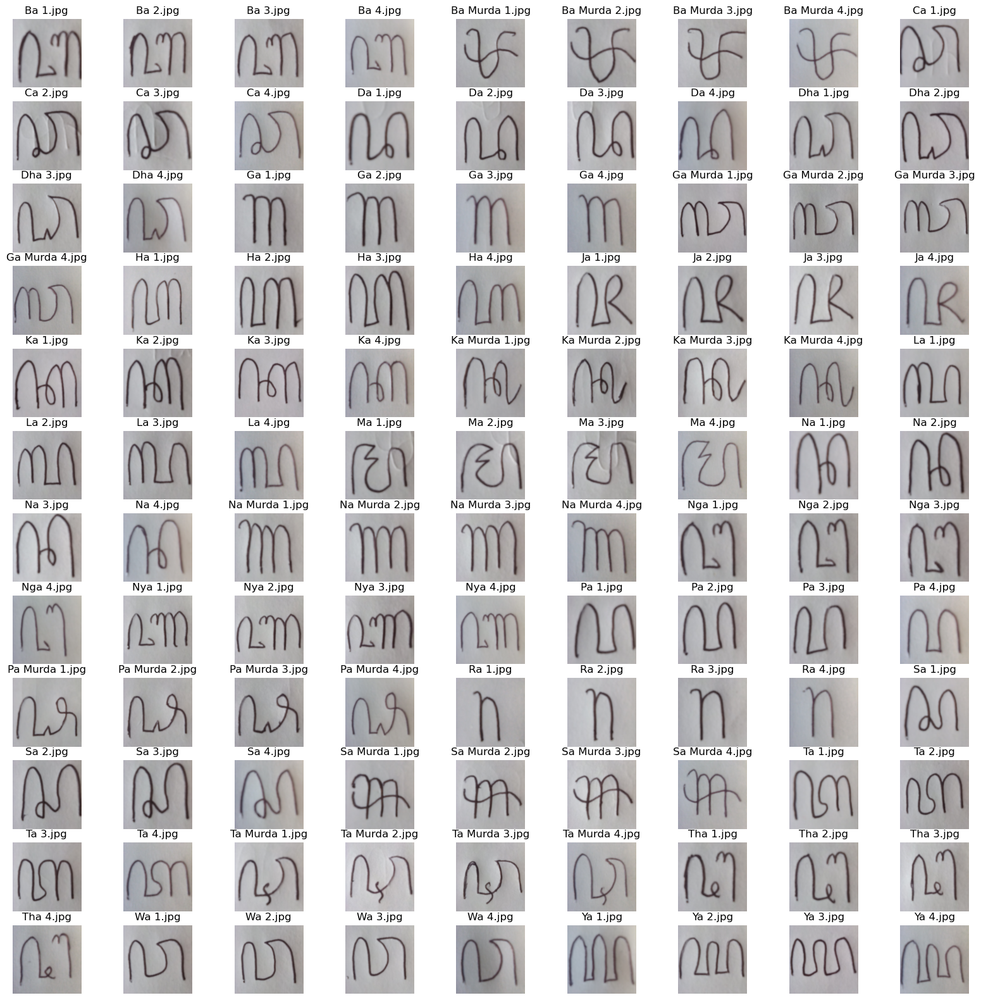

In [35]:
list_image = []
kelas_aktual_jenis = np.empty(108, dtype='object')
kelas_aktual_huruf = np.empty(108, dtype='object')
fig, axs = plt.subplots(nrows = 12, ncols = 9, figsize = (20,20))
axs = axs.flatten()

for i in range(108):
    filepath = os.path.join('Data Testing 3', os.listdir('Data Testing 3')[i])
    img = Image.open(filepath)
    list_image.append(img)
    axs [i].imshow(img)
    axs[i].axis('off')
    filename = os.listdir('Data Testing 3')[i]
    kelas_aktual_jenis[i] = filename
    kelas_aktual_huruf[i] = filename
    axs[i].set_title(filename)
plt.show()

In [36]:
for i in range(len(kelas_aktual_jenis)):
    
    if len(kelas_aktual_jenis[i]) > 9:
        kelas_aktual_jenis[i] = "Murda"
        kelas_aktual_huruf[i] = kelas_aktual_huruf[i][:8]
    elif len(kelas_aktual_jenis[i]) == 9 or len(kelas_aktual_jenis[i]) == 8:
        kelas_aktual_jenis[i] = "Ngelegena"
        if len(kelas_aktual_huruf[i]) == 8:
            kelas_aktual_huruf[i] = kelas_aktual_huruf[i][:2] 
        elif len(kelas_aktual_huruf[i]) == 9:
            kelas_aktual_huruf[i] = kelas_aktual_huruf[i][:3]
        
        
print(kelas_aktual_jenis)
print(kelas_aktual_huruf)

['Ngelegena' 'Ngelegena' 'Ngelegena' 'Ngelegena' 'Murda' 'Murda' 'Murda'
 'Murda' 'Ngelegena' 'Ngelegena' 'Ngelegena' 'Ngelegena' 'Ngelegena'
 'Ngelegena' 'Ngelegena' 'Ngelegena' 'Ngelegena' 'Ngelegena' 'Ngelegena'
 'Ngelegena' 'Ngelegena' 'Ngelegena' 'Ngelegena' 'Ngelegena' 'Murda'
 'Murda' 'Murda' 'Murda' 'Ngelegena' 'Ngelegena' 'Ngelegena' 'Ngelegena'
 'Ngelegena' 'Ngelegena' 'Ngelegena' 'Ngelegena' 'Ngelegena' 'Ngelegena'
 'Ngelegena' 'Ngelegena' 'Murda' 'Murda' 'Murda' 'Murda' 'Ngelegena'
 'Ngelegena' 'Ngelegena' 'Ngelegena' 'Ngelegena' 'Ngelegena' 'Ngelegena'
 'Ngelegena' 'Ngelegena' 'Ngelegena' 'Ngelegena' 'Ngelegena' 'Murda'
 'Murda' 'Murda' 'Murda' 'Ngelegena' 'Ngelegena' 'Ngelegena' 'Ngelegena'
 'Ngelegena' 'Ngelegena' 'Ngelegena' 'Ngelegena' 'Ngelegena' 'Ngelegena'
 'Ngelegena' 'Ngelegena' 'Murda' 'Murda' 'Murda' 'Murda' 'Ngelegena'
 'Ngelegena' 'Ngelegena' 'Ngelegena' 'Ngelegena' 'Ngelegena' 'Ngelegena'
 'Ngelegena' 'Murda' 'Murda' 'Murda' 'Murda' 'Ngelegena' 'Ngelegena'
 '

#### Resize Data

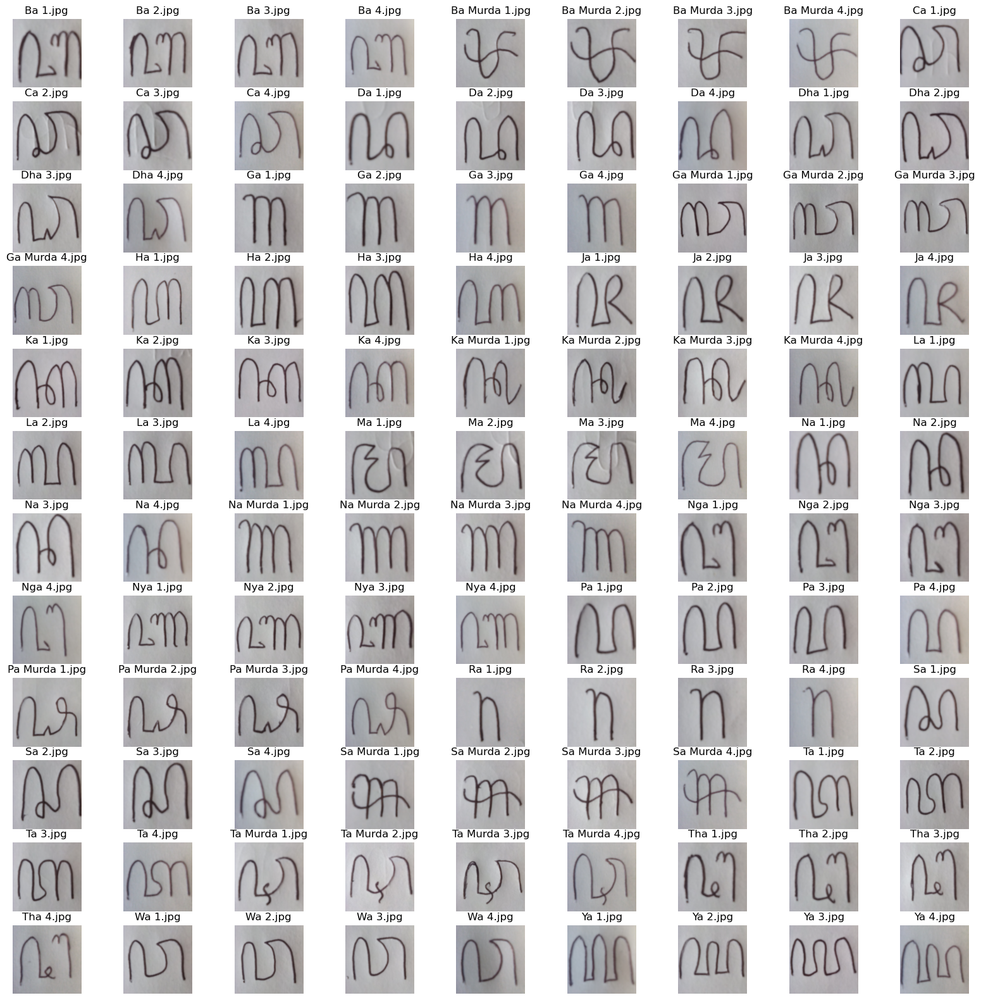

In [37]:
i = 0
resized_tests = []
fig, axs = plt.subplots(nrows = 12, ncols = 9, figsize = (20,20))
axs = axs.flatten()

for image in list_image:
    resized_test = image.resize((120, 120))
    resized_tests.append(resized_test)
    axs[i].imshow(image)
    axs[i].axis('off')
    axs[i].set_title(os.listdir('Data Testing 3')[i])
    i += 1

plt.show()

#### Grayscale Data

In [38]:
grayscale_tests = []
for image in resized_tests:
    width, height = image.size
    grayscale_test = Image.new("L", (width, height))
        
    for x in range(width):
            
        for y in range(height):
            r, g, b = image.getpixel((x, y))
            brightness = int(0.2989 * r + 0.5870 * g + 0.1140 * b)
            grayscale_test.putpixel((x, y), brightness)
            
    grayscale_tests.append(grayscale_test)

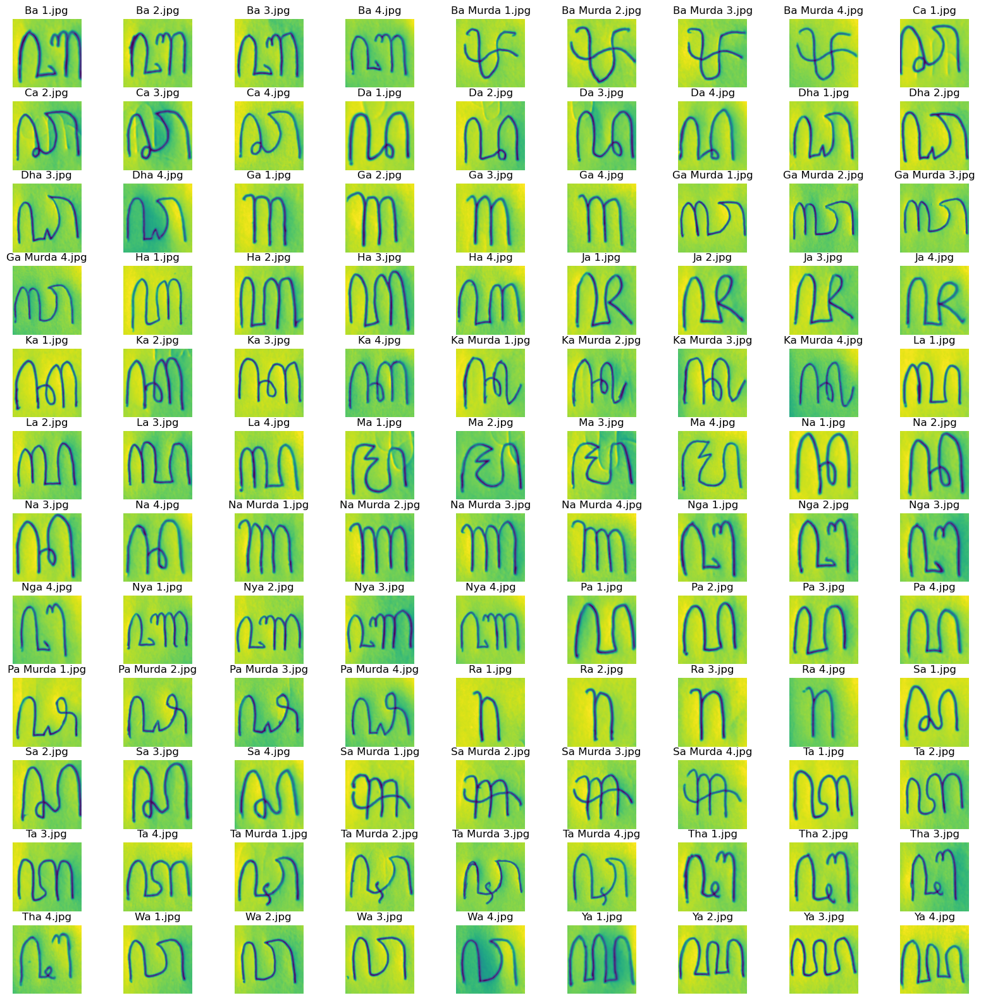

In [39]:
i = 0
fig, axs = plt.subplots(nrows = 12, ncols = 9, figsize = (20,20))
axs = axs.flatten()

for image in grayscale_tests:
    axs[i].imshow(image)
    axs[i].axis('off')
    axs[i].set_title(os.listdir('Data Testing 3')[i])
    i += 1
    
plt.show()

#### Sauvola Threshold Data

In [40]:
k = 0.2
R = 128
threshold_tests = []

for image in grayscale_tests:
    image = image.rotate(270)
    image = image.transpose(method=Image.FLIP_LEFT_RIGHT)
    img_array = np.array(image)
    width, height = image.size
    binary_img = Image.new("1", (width, height))
        
    for x in range(width):
            
        for y in range(height):
            window = img_array[max(x-15, 0):min(x+15, width), max(y-15, 0):min(y+15, height)]
            mean = np.mean(window)
            stddev = np.std(window)
            threshold = mean * (1 + k * ((stddev / R) - 1))
                
            if img_array[x, y] > threshold:
                binary_img.putpixel((x, y), 0)
            else:
                binary_img.putpixel((x, y), 255)
    
    threshold_tests.append(binary_img)

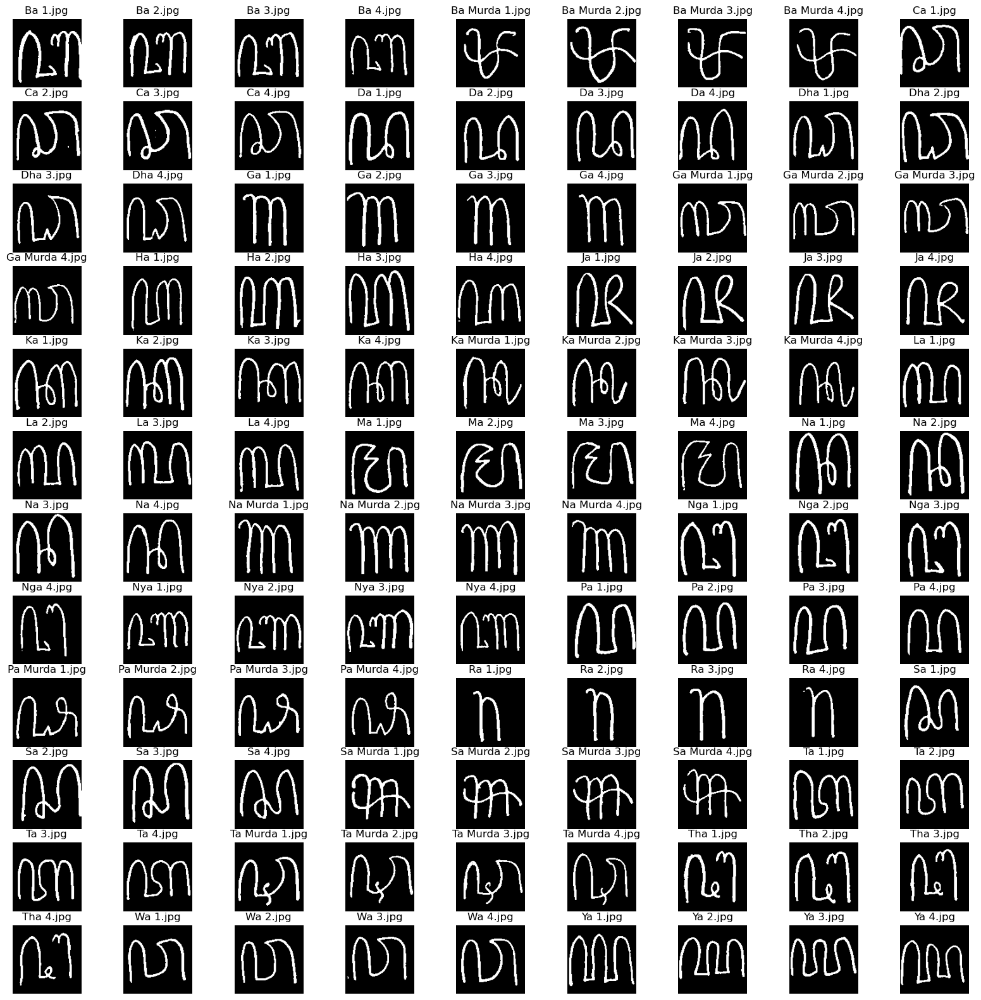

In [41]:
i = 0
fig, axs = plt.subplots(nrows = 12, ncols = 9, figsize = (20,20))
axs = axs.flatten()

for image in threshold_tests:
    axs[i].imshow(image)
    axs[i].axis('off')
    axs[i].set_title(os.listdir('Data Testing 3')[i])
    i += 1
    
plt.show()

### Ekstraksi Zoning ICZ dan ZCZ

#### Ekstraksi Zoning

In [42]:
i = 0
array_tests = np.zeros((len(threshold_tests), 6))
centroid = np.zeros((len(threshold_tests), 8))

for image in threshold_tests:
    width, height = image.size
    zone_height = height // 3
    zone1 = image.crop((0, 0, width, zone_height))
    zone2 = image.crop((0, zone_height, width, zone_height * 2))
    zone3 = image.crop((0, zone_height * 2, width, height))
    
    img_array = np.array(image)
    img_zone1 = np.array(zone1)
    img_zone2 = np.array(zone2)
    img_zone3 = np.array(zone3)
    total_pixel = np.sum(img_array)
    total_zone1 = np.sum(img_zone1)
    total_zone2 = np.sum(img_zone2)
    total_zone3 = np.sum(img_zone3)
    
    kolom = 0
    baris = 0
    kolom_zone1 = 0
    kolom_zone2 = 0
    kolom_zone3 = 0
    baris_zone1 = 0
    baris_zone2 = 0
    baris_zone3 = 0
    sum_kolom = 0
    sum_baris = 0
    sumkolom_zone1 = 0
    sumkolom_zone2 = 0
    sumkolom_zone3 = 0
    sumbaris_zone1 = 0
    sumbaris_zone2 = 0
    sumbaris_zone3 = 0
    sumiczzone1 = 0
    sumiczzone2 = 0
    sumiczzone3 = 0
    sumzczzone1 = 0
    sumzczzone2 = 0
    sumzczzone3 = 0
    
    for x in range(width):
    
        for y in range(height):
            kolom += img_array[y][x]
            baris += img_array[x][y]
    
        sum_kolom += kolom * (x + 1)  
        sum_baris += baris * (x + 1)
            
        kolom = 0
        baris = 0
        
    for x in range(len(img_zone1)):
            
        for y in range(len(img_zone1[x])):
            baris_zone1 += img_zone1[x][y]
            baris_zone2 += img_zone2[x][y]
            baris_zone3 += img_zone3[x][y]

        sumbaris_zone1 += baris_zone1 * (x + 1)
        sumbaris_zone2 += baris_zone2 * (x + 1)
        sumbaris_zone3 += baris_zone3 * (x + 1)

        baris_zone1 = 0
        baris_zone2 = 0
        baris_zone3 = 0
            
    for x in range(len(img_zone1[0])):
            
        for y in range(len(img_zone1)):
            kolom_zone1 += img_zone1[y][x]
            kolom_zone2 += img_zone2[y][x]    
            kolom_zone3 += img_zone3[y][x]
                
        sumkolom_zone1 += kolom_zone1 * (x + 1)  
        sumkolom_zone2 += kolom_zone2 * (x + 1)  
        sumkolom_zone3 += kolom_zone3 * (x + 1)  
            
        kolom_zone1 = 0
        kolom_zone2 = 0
        kolom_zone3 = 0
            
    centroid_x = sum_kolom / total_pixel
    centroid_y = sum_baris / total_pixel
        
    centroidx_zone1 = sumkolom_zone1 / total_zone1
    centroidx_zone2 = sumkolom_zone2 / total_zone2
    centroidx_zone3 = sumkolom_zone3 / total_zone3
        
    centroidy_zone1 = sumbaris_zone1 / total_zone1
    centroidy_zone2 = sumbaris_zone2 / total_zone2
    centroidy_zone3 = sumbaris_zone3 / total_zone3
    
    if math.isnan(centroidx_zone1) and math.isnan(centroidy_zone1):
        centroidx_zone1 = 0
        centroidy_zone1 = 0
        
    if math.isnan(centroidx_zone2) and math.isnan(centroidy_zone2):
        centroidx_zone2 = 0
        centroidy_zone2 = 0
        
    if math.isnan(centroidx_zone3) and math.isnan(centroidy_zone3):
        centroidx_zone3 = 0
        centroidy_zone3 = 0
        
    centroid[i] = [centroid_x, centroid_y, centroidx_zone1, centroidx_zone2, centroidx_zone3, centroidy_zone1, centroidy_zone2, centroidy_zone3]
        
    for x in range(len(img_zone1)):
            
        for y in range(len(img_zone1[0])):
            if img_zone1[x][y] == True:
                sumiczzone1 += math.sqrt(pow(((y+1) - centroid_x), 2) + pow(((x+1) - centroid_y), 2))
                sumzczzone1 += math.sqrt(pow(((y+1) - centroidx_zone1), 2) + pow(((x+1) - centroidy_zone1), 2))
                
            if img_zone2[x][y] == True:
                sumiczzone2 += math.sqrt(pow(((y+1) - centroid_x), 2) + pow(((x+1) - centroid_y), 2))
                sumzczzone2 += math.sqrt(pow(((y+1) - centroidx_zone2), 2) + pow(((x+1) - centroidy_zone2), 2))
                
            if img_zone3[x][y] == True:
                sumiczzone3 += math.sqrt(pow(((y+1) - centroid_x), 2) + pow(((x+1) - centroid_y), 2))
                sumzczzone3 += math.sqrt(pow(((y+1) - centroidx_zone3), 2) + pow(((x+1) - centroidy_zone3), 2))
                    
    iczzone1 = sumiczzone1 / total_zone1
    iczzone2 = sumiczzone2 / total_zone2
    iczzone3 = sumiczzone3 / total_zone3
        
    zczzone1 = sumzczzone1 / total_zone1
    zczzone2 = sumzczzone2 / total_zone2
    zczzone3 = sumzczzone3 / total_zone3
    
    if math.isnan(iczzone1) and math.isnan(zczzone1):
        iczzone1 = 0
        zczzone1 = 0
        
    if math.isnan(iczzone2) and math.isnan(zczzone2):
        iczzone2 = 0
        zczzone2 = 0    
     
    if math.isnan(iczzone3) and math.isnan(zczzone3):
        iczzone3 = 0
        zczzone3 = 0
        
    array_tests[i] = [iczzone1, iczzone2, iczzone3, zczzone1, zczzone2, zczzone3]
             
    print("Nama File : ", os.listdir('Data Testing 3')[i])
    print("Centroid Citra: ({}, {})".format(centroid_x, centroid_y))
    print("Centroid Zona 1: ({}, {})".format(centroidx_zone1, centroidy_zone1))
    print("Centroid Zona 2: ({}, {})".format(centroidx_zone2, centroidy_zone2))
    print("Centroid Zona 3: ({}, {})".format(centroidx_zone3, centroidy_zone3))
    print("Ekstraksi ICZ: ({}, {}, {})".format(iczzone1, iczzone2, iczzone3))
    print("Ekstraksi ZCZ: ({}, {}, {})".format(zczzone1, zczzone2, zczzone3))
    print("\n")
        
    i += 1
    
df = pd.DataFrame(array_tests)
df.to_excel('Test 3 Zona(3).xlsx', index=False)

Nama File :  Ba 1.jpg
Centroid Citra: (66.13593481989709, 62.66552315608919)
Centroid Zona 1: (69.55555555555556, 31.574603174603176)
Centroid Zona 2: (65.99896587383661, 19.23578076525336)
Centroid Zona 3: (63.38503401360544, 13.827210884353741)
Ekstraksi ICZ: (44.46321800160618, 58.201249744555824, 60.049525338902846)
Ekstraksi ZCZ: (29.761168231241292, 38.16049066731456, 31.522639440677043)


Nama File :  Ba 2.jpg
Centroid Citra: (60.167735042735046, 60.05181623931624)
Centroid Zona 1: (62.861480075901326, 32.51043643263757)
Centroid Zona 2: (59.79526627218935, 19.536094674556214)
Centroid Zona 3: (57.958, 9.952)
Ekstraksi ICZ: (39.55583707693717, 53.92442603716294, 57.91883502786189)
Ekstraksi ZCZ: (26.2334021952886, 35.66062261984113, 25.859871397315125)


Nama File :  Ba 3.jpg
Centroid Citra: (60.684770436730126, 63.629339305711085)
Centroid Zona 1: (65.88305489260144, 33.64916467780429)
Centroid Zona 2: (59.22738693467337, 19.355527638190956)
Centroid Zona 3: (58.90192644483363,

Nama File :  Ga 2.jpg
Centroid Citra: (54.48765432098765, 58.65246913580247)
Centroid Zona 1: (46.9926873857404, 28.179159049360145)
Centroid Zona 2: (59.35443037974684, 20.537974683544302)
Centroid Zona 3: (56.80952380952381, 13.748299319727892)
Ekstraksi ICZ: (38.37941965113363, 44.38093277448732, 50.17084971850886)
Ekstraksi ZCZ: (21.48738058288243, 22.879773262249074, 21.525107398942865)


Nama File :  Ga 3.jpg
Centroid Citra: (59.31335740072202, 62.29747292418772)
Centroid Zona 1: (54.27835051546392, 31.028350515463917)
Centroid Zona 2: (60.51126516464471, 20.357019064124785)
Centroid Zona 3: (62.319047619047616, 13.85)
Ekstraksi ICZ: (36.65356929393834, 47.7743374810366, 53.96454175509706)
Ekstraksi ZCZ: (17.64490286711705, 23.19590904541083, 22.334473593281025)


Nama File :  Ga 4.jpg
Centroid Citra: (62.447452229299365, 59.265127388535035)
Centroid Zona 1: (55.27272727272727, 30.6010101010101)
Centroid Zona 2: (63.82656826568266, 20.555350553505534)
Centroid Zona 3: (69.0314465

Nama File :  Ka Murda 3.jpg
Centroid Citra: (57.88691533451747, 58.48134991119005)
Centroid Zona 1: (51.043577981651374, 28.05045871559633)
Centroid Zona 2: (60.05071664829107, 21.950385887541344)
Centroid Zona 3: (60.83815028901734, 7.734104046242774)
Ekstraksi ICZ: (39.737359919510816, 47.856184212470566, 59.877828185211094)
Ekstraksi ZCZ: (24.07116888356053, 29.13781007934893, 28.679763300061197)


Nama File :  Ka Murda 4.jpg
Centroid Citra: (62.547746371275785, 65.0061115355233)
Centroid Zona 1: (57.067796610169495, 32.51271186440678)
Centroid Zona 2: (60.31616595135908, 22.705293276108726)
Centroid Zona 3: (70.17647058823529, 9.810160427807487)
Ekstraksi ICZ: (39.63540026348929, 49.7709667250486, 63.40552322636077)
Ekstraksi ZCZ: (21.71443605920513, 24.912356887248585, 26.901897567271046)


Nama File :  La 1.jpg
Centroid Citra: (53.092696629213485, 62.9561797752809)
Centroid Zona 1: (52.10761154855643, 33.3989501312336)
Centroid Zona 2: (52.91475409836065, 20.908196721311477)
Cent

Nama File :  Nga 4.jpg
Centroid Citra: (55.45960034752389, 58.7619461337967)
Centroid Zona 1: (55.75935828877005, 27.16042780748663)
Centroid Zona 2: (51.013824884792626, 20.352534562211982)
Centroid Zona 3: (60.75801749271137, 11.206997084548105)
Ekstraksi ICZ: (39.75311328476447, 49.75519732003218, 53.952547404874316)
Ekstraksi ZCZ: (22.92583406597373, 30.783537062667403, 22.112613967468167)


Nama File :  Nya 1.jpg
Centroid Citra: (63.13656957928803, 60.353398058252424)
Centroid Zona 1: (70.8810975609756, 35.61585365853659)
Centroid Zona 2: (63.23240223463687, 20.12513966480447)
Centroid Zona 3: (54.98136645962733, 6.186335403726708)
Ekstraksi ICZ: (35.393830791056075, 52.77571351639297, 63.6770304329498)
Ekstraksi ZCZ: (21.404977908253585, 33.484727831017175, 29.179999169840364)


Nama File :  Nya 2.jpg
Centroid Citra: (61.446163366336634, 65.04146039603961)
Centroid Zona 1: (70.08496732026144, 38.150326797385624)
Centroid Zona 2: (63.00597609561753, 18.301792828685258)
Centroid Zo

Nama File :  Sa Murda 1.jpg
Centroid Citra: (55.666111111111114, 61.27)
Centroid Zona 1: (46.481572481572485, 33.96805896805897)
Centroid Zona 2: (59.1897738446411, 22.23795476892822)
Centroid Zona 3: (56.077127659574465, 8.204787234042554)
Ekstraksi ICZ: (35.65374815160704, 48.48982148952914, 58.601768033530206)
Ekstraksi ZCZ: (19.521599277798085, 27.82565319370063, 23.562504543647034)


Nama File :  Sa Murda 2.jpg
Centroid Citra: (58.72287662740236, 61.799752014879104)
Centroid Zona 1: (48.694545454545455, 35.10181818181818)
Centroid Zona 2: (61.21563088512241, 21.336158192090394)
Centroid Zona 3: (59.1231884057971, 10.184782608695652)
Ekstraksi ICZ: (35.13669571715056, 49.416427202863936, 56.41128824258659)
Ekstraksi ZCZ: (19.91574030440478, 27.190239008020633, 20.91238399787658)


Nama File :  Sa Murda 3.jpg
Centroid Citra: (59.752919483712354, 60.499078057775044)
Centroid Zona 1: (54.35294117647059, 33.40896358543417)
Centroid Zona 2: (62.18541033434651, 21.470111448834853)
Centro

Nama File :  Ya 2.jpg
Centroid Citra: (58.932967032967035, 58.614285714285714)
Centroid Zona 1: (59.459276018099544, 32.50678733031674)
Centroid Zona 2: (60.18415841584159, 20.285148514851485)
Centroid Zona 3: (54.86684782608695, 5.385869565217392)
Ekstraksi ICZ: (40.43074025698557, 51.340651497778445, 62.94576751281756)
Ekstraksi ZCZ: (29.08831636944135, 32.875472556111546, 28.92435546187283)


Nama File :  Ya 3.jpg
Centroid Citra: (56.7416162726773, 56.89939527212754)
Centroid Zona 1: (58.300601202404806, 31.705410821643287)
Centroid Zona 2: (57.11044776119403, 20.555223880597016)
Centroid Zona 3: (53.095238095238095, 5.146031746031746)
Ekstraksi ICZ: (39.74063625557144, 50.416870203830975, 58.987057131274106)
Ekstraksi ZCZ: (28.75945684095653, 33.754474618174, 25.09863803109599)


Nama File :  Ya 4.jpg
Centroid Citra: (53.20096269554753, 67.91516245487365)
Centroid Zona 1: (43.73913043478261, 35.76328502415459)
Centroid Zona 2: (55.48202247191011, 20.660674157303372)
Centroid Zona 3

In [43]:
df_test = pd.read_excel("Test 3 Zona(3).xlsx")
df_test

,0,1,2,3,4,5
0,44.463218,58.201250,60.049525,29.761168,38.160491,31.522639
1,39.555837,53.924426,57.918835,26.233402,35.660623,25.859871
2,41.058747,57.499638,60.986443,24.844732,35.901379,28.225631
3,36.716254,52.525630,61.812727,22.052490,34.822678,27.830910
4,42.207835,44.568540,46.520512,27.981004,24.652573,12.128369
...,...,...,...,...,...,...
103,40.951688,54.337728,60.198281,23.779687,33.682992,27.541388
104,44.293913,52.813731,60.544427,27.569343,31.550186,31.178615
105,40.430740,51.340651,62.945768,29.088316,32.875473,28.924355
106,39.740636,50.416870,58.987057,28.759457,33.754475,25.098638


### Testing SVM

#### Kernel RBF untuk Binary

In [44]:
sigma = 2.1

def kernel_rbf(array_tests):
    array_rbf = np.zeros((len(array_ekstraksi), len(array_tests)))
    for i in range (len(array_tests)):
        for j in range (len(array_ekstraksi)):
            array_rbf[j, i] = math.exp(-(pow((array_tests[i][0] - array_ekstraksi[j][0]), 2)
                                        + pow((array_tests[i][1] - array_ekstraksi[j][1]), 2)
                                        + pow((array_tests[i][2] - array_ekstraksi[j][2]), 2)
                                        + pow((array_tests[i][3] - array_ekstraksi[j][3]), 2)
                                        + pow((array_tests[i][4] - array_ekstraksi[j][4]), 2)
                                        + pow((array_tests[i][5] - array_ekstraksi[j][5]), 2)) / (2 * pow(sigma, 2)))
    return array_rbf

rbf_tests = kernel_rbf(array_tests)
print(rbf_tests)

[[9.03303566e-05 1.20644463e-03 5.45753486e-05 ... 9.68747624e-03
  6.63572156e-03 2.82694829e-06]
 [1.80936194e-14 1.48643530e-06 1.68222577e-10 ... 3.83533467e-08
  1.91858753e-05 4.52604741e-13]
 [5.87351572e-08 3.87783139e-04 8.98798571e-06 ... 1.25276775e-04
  8.87585250e-04 6.91920629e-07]
 ...
 [1.58995962e-37 6.20914721e-23 1.23501628e-32 ... 5.43341353e-30
  5.08572501e-20 9.52062695e-39]
 [9.22166220e-41 7.42807367e-25 4.19182468e-36 ... 1.11421997e-32
  2.48073319e-21 5.58292231e-44]
 [2.09244079e-39 3.58534719e-26 4.03753864e-37 ... 8.91232391e-34
  8.12218060e-23 7.58585869e-45]]


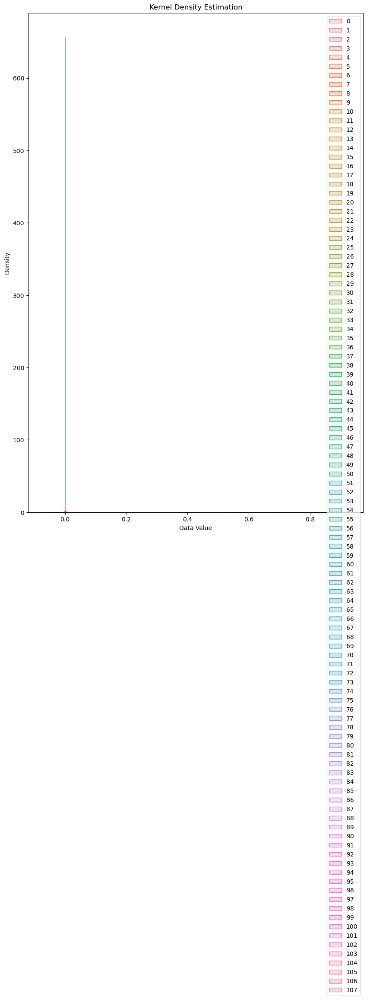

In [45]:
plt.figure(figsize=(10, 15))
sns.kdeplot(rbf_tests, fill=True)
plt.title('Kernel Density Estimation')
plt.xlabel('Data Value')
plt.ylabel('Density')
plt.show()

#### Klasifikasi Binary, Kernel RBF Multiclass dan Klasifikasi Multiclass 

In [46]:
matriks_bobot = np.zeros((len(array_ekstraksi)))
matriks_bobot_ha = np.zeros((len(array_ngelegena)))
matriks_bobot_na = np.zeros((len(array_ngelegena)))
matriks_bobot_ca = np.zeros((len(array_ngelegena)))
matriks_bobot_ra = np.zeros((len(array_ngelegena)))
matriks_bobot_ka = np.zeros((len(array_ngelegena)))
matriks_bobot_da = np.zeros((len(array_ngelegena)))
matriks_bobot_ta = np.zeros((len(array_ngelegena)))
matriks_bobot_sa = np.zeros((len(array_ngelegena)))
matriks_bobot_wa = np.zeros((len(array_ngelegena)))
matriks_bobot_la = np.zeros((len(array_ngelegena)))
matriks_bobot_pa = np.zeros((len(array_ngelegena)))
matriks_bobot_dha = np.zeros((len(array_ngelegena)))
matriks_bobot_ja = np.zeros((len(array_ngelegena)))
matriks_bobot_ya = np.zeros((len(array_ngelegena)))
matriks_bobot_nya = np.zeros((len(array_ngelegena)))
matriks_bobot_ma = np.zeros((len(array_ngelegena)))
matriks_bobot_ga = np.zeros((len(array_ngelegena)))
matriks_bobot_ba = np.zeros((len(array_ngelegena)))
matriks_bobot_tha = np.zeros((len(array_ngelegena)))
matriks_bobot_nga = np.zeros((len(array_ngelegena)))
matriks_bobot_namurda = np.zeros((len(array_murda)))
matriks_bobot_kamurda = np.zeros((len(array_murda)))
matriks_bobot_tamurda = np.zeros((len(array_murda)))
matriks_bobot_samurda = np.zeros((len(array_murda)))
matriks_bobot_pamurda = np.zeros((len(array_murda)))
matriks_bobot_gamurda = np.zeros((len(array_murda)))
matriks_bobot_bamurda = np.zeros((len(array_murda)))

In [47]:
kelas_prediksi = np.empty(108, dtype='object')
kelas_prediksi_huruf = np.empty(108, dtype='object')
array_rbf_murda = np.zeros((len(array_murda), 1))
array_rbf_ngelegena = np.zeros((len(array_ngelegena), 1))
tabel_hasil = np.zeros((len(array_tests), 2))
tabel_hasil_ngelegena = np.zeros((len(array_tests), 2))
tabel_hasil_murda = np.zeros((len(array_tests), 2))
sigma_huruf = 2
sigma_murda = 3
a = 0

for i in range(rbf_tests.shape[1]):
    for j in range(rbf_tests.shape[0]):
        matriks_bobot[j] = alpha[j] * model[j][6] * rbf_tests[j, i]
    total_bobot_jenis = np.sum(matriks_bobot)
    hasil_klasifikasi = total_bobot_jenis + bias
    if hasil_klasifikasi > 0:
        kelas_prediksi[i] = "Ngelegena"
        for k in range (1):
            for l in range (len(array_ngelegena)):
                array_rbf_ngelegena[l, k] = math.exp(-(pow((array_tests[a][0] - array_ngelegena[l][0]), 2)
                                                    + pow((array_tests[a][1] - array_ngelegena[l][1]), 2)
                                                    + pow((array_tests[a][2] - array_ngelegena[l][2]), 2)
                                                    + pow((array_tests[a][3] - array_ngelegena[l][3]), 2)
                                                    + pow((array_tests[a][4] - array_ngelegena[l][4]), 2)
                                                    + pow((array_tests[a][5] - array_ngelegena[l][5]), 2)) / (2 * pow(sigma_huruf, 2)))
        a += 1
        for k in range(21):
            if k == 0:
                for m in range(array_rbf_ngelegena.shape[0]):
                    matriks_bobot_ha[m] = alpha_ha[m] * model_ha[m][6] * array_rbf_ngelegena[m, 0]
                total_bobot = np.sum(matriks_bobot_ha)
                hasil_klasifikasi_huruf = total_bobot + bias_ha
                if hasil_klasifikasi_huruf > 0:
                    kelas_prediksi_huruf[i] = "Ha"
                    print(i, kelas_prediksi[i], kelas_prediksi_huruf[i])
                    break
            elif k == 1:
                for m in range(array_rbf_ngelegena.shape[0]):
                    matriks_bobot_na[m] = alpha_na[m] * model_na[m][6] * array_rbf_ngelegena[m, 0]
                total_bobot = np.sum(matriks_bobot_na)
                hasil_klasifikasi_huruf = total_bobot + bias_na
                if hasil_klasifikasi_huruf > 0:
                    kelas_prediksi_huruf[i] = "Na"
                    print(i, kelas_prediksi[i], kelas_prediksi_huruf[i])
                    break
            elif k == 2:
                for m in range(array_rbf_ngelegena.shape[0]):
                    matriks_bobot_ca[m] = alpha_ca[m] * model_ca[m][6] * array_rbf_ngelegena[m, 0]
                total_bobot = np.sum(matriks_bobot_ca)
                hasil_klasifikasi_huruf = total_bobot + bias_ca
                if hasil_klasifikasi_huruf > 0:
                    kelas_prediksi_huruf[i] = "Ca"
                    print(i, kelas_prediksi[i], kelas_prediksi_huruf[i])
                    break
            elif k == 3:
                for m in range(array_rbf_ngelegena.shape[0]):
                    matriks_bobot_ra[m] = alpha_ra[m] * model_ra[m][6] * array_rbf_ngelegena[m, 0]
                total_bobot = np.sum(matriks_bobot_ra)
                hasil_klasifikasi_huruf = total_bobot + bias_ra
                if hasil_klasifikasi_huruf > 0:
                    kelas_prediksi_huruf[i] = "Ra"
                    print(i, kelas_prediksi[i], kelas_prediksi_huruf[i])
                    break
            elif k == 4:
                for m in range(array_rbf_ngelegena.shape[0]):
                    matriks_bobot_ka[m] = alpha_ka[m] * model_ka[m][6] * array_rbf_ngelegena[m, 0]
                total_bobot = np.sum(matriks_bobot_ka)
                hasil_klasifikasi_huruf = total_bobot + bias_ka
                if hasil_klasifikasi_huruf > 0:
                    kelas_prediksi_huruf[i] = "Ka"
                    print(i, kelas_prediksi[i], kelas_prediksi_huruf[i])
                    break
            elif k == 5:
                for m in range(array_rbf_ngelegena.shape[0]):
                    matriks_bobot_da[m] = alpha_da[m] * model_da[m][6] * array_rbf_ngelegena[m, 0]
                total_bobot = np.sum(matriks_bobot_da)
                hasil_klasifikasi_huruf = total_bobot + bias_da
                if hasil_klasifikasi_huruf > 0:
                    kelas_prediksi_huruf[i] = "Da"
                    print(i, kelas_prediksi[i], kelas_prediksi_huruf[i])
                    break
            elif k == 6:
                for m in range(array_rbf_ngelegena.shape[0]):
                    matriks_bobot_ta[m] = alpha_ta[m] * model_ta[m][6] * array_rbf_ngelegena[m, 0]
                total_bobot = np.sum(matriks_bobot_ta)
                hasil_klasifikasi_huruf = total_bobot + bias_ta
                if hasil_klasifikasi_huruf > 0:
                    kelas_prediksi_huruf[i] = "Ta"
                    print(i, kelas_prediksi[i], kelas_prediksi_huruf[i])
                    break
            elif k == 7:
                for m in range(array_rbf_ngelegena.shape[0]):
                    matriks_bobot_sa[m] = alpha_sa[m] * model_sa[m][6] * array_rbf_ngelegena[m, 0]
                total_bobot = np.sum(matriks_bobot_sa)
                hasil_klasifikasi_huruf = total_bobot + bias_sa
                if hasil_klasifikasi_huruf > 0:
                    kelas_prediksi_huruf[i] = "Sa"
                    print(i, kelas_prediksi[i], kelas_prediksi_huruf[i])
                    break
            elif k == 8:
                for m in range(array_rbf_ngelegena.shape[0]):
                    matriks_bobot_wa[m] = alpha_wa[m] * model_wa[m][6] * array_rbf_ngelegena[m, 0]
                total_bobot = np.sum(matriks_bobot_wa)
                hasil_klasifikasi_huruf = total_bobot + bias_wa
                if hasil_klasifikasi_huruf > 0:
                    kelas_prediksi_huruf[i] = "Wa"
                    print(i, kelas_prediksi[i], kelas_prediksi_huruf[i])
                    break
            elif k == 9:
                for m in range(array_rbf_ngelegena.shape[0]):
                    matriks_bobot_la[m] = alpha_la[m] * model_la[m][6] * array_rbf_ngelegena[m, 0]
                total_bobot = np.sum(matriks_bobot_la)
                hasil_klasifikasi_huruf = total_bobot + bias_la
                if hasil_klasifikasi_huruf > 0:
                    kelas_prediksi_huruf[i] = "La"
                    print(i, kelas_prediksi[i], kelas_prediksi_huruf[i])
                    break
            elif k == 10:
                for m in range(array_rbf_ngelegena.shape[0]):
                    matriks_bobot_pa[m] = alpha_pa[m] * model_pa[m][6] * array_rbf_ngelegena[m, 0]
                total_bobot = np.sum(matriks_bobot_pa)
                hasil_klasifikasi_huruf = total_bobot + bias_pa
                if hasil_klasifikasi_huruf > 0:
                    kelas_prediksi_huruf[i] = "Pa"
                    print(i, kelas_prediksi[i], kelas_prediksi_huruf[i])
                    break
            elif k == 11:
                for m in range(array_rbf_ngelegena.shape[0]):
                    matriks_bobot_dha[m] = alpha_dha[m] * model_dha[m][6] * array_rbf_ngelegena[m, 0]
                total_bobot = np.sum(matriks_bobot_dha)
                hasil_klasifikasi_huruf = total_bobot + bias_dha
                if hasil_klasifikasi_huruf > 0:
                    kelas_prediksi_huruf[i] = "Dha"
                    print(i, kelas_prediksi[i], kelas_prediksi_huruf[i])
                    break
            elif k == 12:
                for m in range(array_rbf_ngelegena.shape[0]):
                    matriks_bobot_ja[m] = alpha_ja[m] * model_ja[m][6] * array_rbf_ngelegena[m, 0]
                total_bobot = np.sum(matriks_bobot_ja)
                hasil_klasifikasi_huruf = total_bobot + bias_ja
                if hasil_klasifikasi_huruf > 0:
                    kelas_prediksi_huruf[i] = "Ja"
                    print(i, kelas_prediksi[i], kelas_prediksi_huruf[i])
                    break
            elif k == 13:
                for m in range(array_rbf_ngelegena.shape[0]):
                    matriks_bobot_ya[m] = alpha_ya[m] * model_ya[m][6] * array_rbf_ngelegena[m, 0]
                total_bobot = np.sum(matriks_bobot_ya)
                hasil_klasifikasi_huruf = total_bobot + bias_ya
                if hasil_klasifikasi_huruf > 0:
                    kelas_prediksi_huruf[i] = "Ya"
                    print(i, kelas_prediksi[i], kelas_prediksi_huruf[i])
                    break
            elif k == 14:
                for m in range(array_rbf_ngelegena.shape[0]):
                    matriks_bobot_nya[m] = alpha_nya[m] * model_nya[m][6] * array_rbf_ngelegena[m, 0]
                total_bobot = np.sum(matriks_bobot_nya)
                hasil_klasifikasi_huruf = total_bobot + bias_nya
                if hasil_klasifikasi_huruf > 0:
                    kelas_prediksi_huruf[i] = "Nya"
                    print(i, kelas_prediksi[i], kelas_prediksi_huruf[i])
                    break
            elif k == 15:
                for m in range(array_rbf_ngelegena.shape[0]):
                    matriks_bobot_ma[m] = alpha_ma[m] * model_ma[m][6] * array_rbf_ngelegena[m, 0]
                total_bobot = np.sum(matriks_bobot_ma)
                hasil_klasifikasi_huruf = total_bobot + bias_ma
                if hasil_klasifikasi_huruf > 0:
                    kelas_prediksi_huruf[i] = "Ma"
                    print(i, kelas_prediksi[i], kelas_prediksi_huruf[i])
                    break
            elif k == 16:
                for m in range(array_rbf_ngelegena.shape[0]):
                    matriks_bobot_ga[m] = alpha_ga[m] * model_ga[m][6] * array_rbf_ngelegena[m, 0]
                total_bobot = np.sum(matriks_bobot_ga)
                hasil_klasifikasi_huruf = total_bobot + bias_ga
                if hasil_klasifikasi_huruf > 0:
                    kelas_prediksi_huruf[i] = "Ga"
                    print(i, kelas_prediksi[i], kelas_prediksi_huruf[i])
                    break
            elif k == 17:
                for m in range(array_rbf_ngelegena.shape[0]):
                    matriks_bobot_ba[m] = alpha_ba[m] * model_ba[m][6] * array_rbf_ngelegena[m, 0]
                total_bobot = np.sum(matriks_bobot_ba)
                hasil_klasifikasi_huruf = total_bobot + bias_ba
                if hasil_klasifikasi_huruf > 0:
                    kelas_prediksi_huruf[i] = "Ba"
                    print(i, kelas_prediksi[i], kelas_prediksi_huruf[i])
                    break
            elif k == 18:
                for m in range(array_rbf_ngelegena.shape[0]):
                    matriks_bobot_tha[m] = alpha_tha[m] * model_tha[m][6] * array_rbf_ngelegena[m, 0]
                total_bobot = np.sum(matriks_bobot_tha)
                hasil_klasifikasi_huruf = total_bobot + bias_tha
                if hasil_klasifikasi_huruf > 0:
                    kelas_prediksi_huruf[i] = "Tha"
                    print(i, kelas_prediksi[i], kelas_prediksi_huruf[i])
                    break
            elif k == 19:
                for m in range(array_rbf_ngelegena.shape[0]):
                    matriks_bobot_nga[m] = alpha_nga[m] * model_nga[m][6] * array_rbf_ngelegena[m, 0]
                total_bobot = np.sum(matriks_bobot_ha)
                hasil_klasifikasi_huruf = total_bobot + bias_nga
                if hasil_klasifikasi_huruf > 0:
                    kelas_prediksi_huruf[i] = "Nga"
                    print(i, kelas_prediksi[i], kelas_prediksi_huruf[i])
                    break
            else:
                kelas_prediksi_huruf[i] = "Tak Terdefinisi"
                print(i, kelas_prediksi[i], kelas_prediksi_huruf[i])
                
        tabel_hasil_ngelegena[i] = [total_bobot, hasil_klasifikasi_huruf]
    else:
        kelas_prediksi[i] = "Murda"
        for k in range (1):
            for l in range (len(array_murda)):
                array_rbf_murda[l, k] = math.exp(-(pow((array_tests[a][0] - array_murda[l][0]), 2)
                                                    + pow((array_tests[a][1] - array_murda[l][1]), 2)
                                                    + pow((array_tests[a][2] - array_murda[l][2]), 2)
                                                    + pow((array_tests[a][3] - array_murda[l][3]), 2)
                                                    + pow((array_tests[a][4] - array_murda[l][4]), 2)
                                                    + pow((array_tests[a][5] - array_murda[l][5]), 2)) / (2 * pow(sigma_murda, 2)))
        a += 1
        for k in range(8):
            if k == 0:
                for m in range(array_rbf_murda.shape[0]):
                    matriks_bobot_namurda[m] = alpha_namurda[m] * model_namurda[m][6] * array_rbf_murda[m, 0]
                total_bobot_murda = np.sum(matriks_bobot_namurda)
                hasil_klasifikasi_murda = total_bobot_murda + bias_namurda
                if hasil_klasifikasi_murda > 0:
                    kelas_prediksi_huruf[i] = "Na Murda"
                    print(i, kelas_prediksi[i], kelas_prediksi_huruf[i])
                    break
            elif k == 1:
                for m in range(array_rbf_murda.shape[0]):
                    matriks_bobot_kamurda[m] = alpha_kamurda[m] * model_kamurda[m][6] * array_rbf_murda[m, 0]
                total_bobot_murda = np.sum(matriks_bobot_kamurda)
                hasil_klasifikasi_murda = total_bobot_murda + bias_kamurda
                if hasil_klasifikasi_murda > 0:
                    kelas_prediksi_huruf[i] = "Ka Murda"
                    print(i, kelas_prediksi[i], kelas_prediksi_huruf[i])
                    break
            elif k == 2:
                for m in range(array_rbf_murda.shape[0]):
                    matriks_bobot_tamurda[m] = alpha_tamurda[m] * model_tamurda[m][6] * array_rbf_murda[m, 0]
                total_bobot_murda = np.sum(matriks_bobot_tamurda)
                hasil_klasifikasi_murda = total_bobot_murda + bias_tamurda
                if hasil_klasifikasi_murda > 0:
                    kelas_prediksi_huruf[i] = "Ta Murda"
                    print(i, kelas_prediksi[i], kelas_prediksi_huruf[i])
                    break
            elif k == 3:
                for m in range(array_rbf_murda.shape[0]):
                    matriks_bobot_samurda[m] = alpha_samurda[m] * model_samurda[m][6] * array_rbf_murda[m, 0]
                total_bobot_murda = np.sum(matriks_bobot_samurda)
                hasil_klasifikasi_murda = total_bobot_murda + bias_samurda
                if hasil_klasifikasi_murda > 0:
                    kelas_prediksi_huruf[i] = "Sa Murda"
                    print(i, kelas_prediksi[i], kelas_prediksi_huruf[i])
                    break
            elif k == 4:
                for m in range(array_rbf_murda.shape[0]):
                    matriks_bobot_pamurda[m] = alpha_pamurda[m] * model_pamurda[m][6] * array_rbf_murda[m, 0]
                total_bobot_murda = np.sum(matriks_bobot_pamurda)
                hasil_klasifikasi_murda = total_bobot_murda + bias_pamurda
                if hasil_klasifikasi_murda > 0:
                    kelas_prediksi_huruf[i] = "Pa Murda"
                    print(i, kelas_prediksi[i], kelas_prediksi_huruf[i])
                    break
            elif k == 5:
                for m in range(array_rbf_murda.shape[0]):
                    matriks_bobot_gamurda[m] = alpha_gamurda[m] * model_gamurda[m][6] * array_rbf_murda[m, 0]
                total_bobot_murda = np.sum(matriks_bobot_gamurda)
                hasil_klasifikasi_murda = total_bobot_murda + bias_gamurda
                if hasil_klasifikasi_murda > 0:
                    kelas_prediksi_huruf[i] = "Ga Murda"
                    print(i, kelas_prediksi[i], kelas_prediksi_huruf[i])
                    break
            elif k == 6:
                for m in range(array_rbf_murda.shape[0]):
                    matriks_bobot_bamurda[m] = alpha_bamurda[m] * model_bamurda[m][6] * array_rbf_murda[m, 0]
                total_bobot_murda = np.sum(matriks_bobot_bamurda)
                hasil_klasifikasi_murda = total_bobot_murda + bias_bamurda
                if hasil_klasifikasi_murda > 0:
                    kelas_prediksi_huruf[i] = "Ba Murda"
                    print(i, kelas_prediksi[i], kelas_prediksi_huruf[i])
                    break
            else:
                kelas_prediksi_huruf[i] = "Tak Terdefinisi"
                print(i, kelas_prediksi[i], kelas_prediksi_huruf[i])
                
        tabel_hasil_murda[i] = [total_bobot_murda, hasil_klasifikasi_murda]
                
    tabel_hasil[i] = [total_bobot_jenis, hasil_klasifikasi]
    
# df1 =  pd.DataFrame(tabel_hasil)
# df2 =  pd.DataFrame(tabel_hasil_murda)
# df3 =  pd.DataFrame(tabel_hasil_ngelegena)

# df1.to_excel('Tabel Hasil Jenis Aksara 3 Zona(3).xlsx', index=False)
# df3.to_excel('Tabel Hasil Aksara Ngelegena 3 Zona(3).xlsx', index=False)
# df2.to_excel('Tabel Hasil Aksara Murda 3 Zona(3).xlsx', index=False)

0 Ngelegena Dha
1 Ngelegena Wa
2 Ngelegena Nya
3 Ngelegena Ba
4 Murda Ba Murda
5 Murda Ba Murda
6 Murda Ba Murda
7 Murda Ba Murda
8 Ngelegena Tak Terdefinisi
9 Ngelegena Ca
10 Ngelegena Ca
11 Ngelegena Tak Terdefinisi
12 Ngelegena Da
13 Ngelegena Tak Terdefinisi
14 Ngelegena Da
15 Ngelegena Da
16 Ngelegena Ca
17 Ngelegena Dha
18 Ngelegena Tak Terdefinisi
19 Ngelegena Ca
20 Ngelegena Ga
21 Ngelegena Ga
22 Murda Sa Murda
23 Ngelegena Ga
24 Murda Ga Murda
25 Murda Ga Murda
26 Murda Ga Murda
27 Ngelegena Tak Terdefinisi
28 Ngelegena Pa
29 Ngelegena Ha
30 Ngelegena Ha
31 Ngelegena Da
32 Ngelegena Ha
33 Ngelegena Na
34 Ngelegena Ha
35 Ngelegena Ja
36 Ngelegena Ka
37 Ngelegena Ha
38 Ngelegena Ka
39 Ngelegena Ka
40 Murda Ka Murda
41 Murda Ka Murda
42 Murda Ka Murda
43 Murda Ka Murda
44 Ngelegena Ha
45 Ngelegena Ta
46 Ngelegena La
47 Ngelegena Tak Terdefinisi
48 Ngelegena Tak Terdefinisi
49 Ngelegena Ta
50 Ngelegena Ta
51 Ngelegena Ha
52 Ngelegena Tak Terdefinisi
53 Ngelegena Na
54 Ngelegena Na

In [48]:
for i in range(108):
    if kelas_prediksi[i] == "Ngelegena":
        kelas_prediksi[i] = 1
    elif kelas_prediksi[i] == "Murda":
        kelas_prediksi[i] = 2
        
for i in range(108):
    if kelas_aktual_jenis[i] == "Ngelegena":
        kelas_aktual_jenis[i] = 1
    elif kelas_aktual_jenis[i] == "Murda":
        kelas_aktual_jenis[i] = 2

In [49]:
for i in range(len(kelas_prediksi_huruf)):
    if kelas_prediksi_huruf[i] == "Ha":
        kelas_prediksi_huruf[i] = 1
    elif kelas_prediksi_huruf[i] == "Na":
        kelas_prediksi_huruf[i] = 2
    elif kelas_prediksi_huruf[i] == "Ca":
        kelas_prediksi_huruf[i] = 3
    elif kelas_prediksi_huruf[i] == "Ra":
        kelas_prediksi_huruf[i] = 4
    elif kelas_prediksi_huruf[i] == "Ka":
        kelas_prediksi_huruf[i] = 5
    elif kelas_prediksi_huruf[i] == "Da":
        kelas_prediksi_huruf[i] = 6
    elif kelas_prediksi_huruf[i] == "Ta":
        kelas_prediksi_huruf[i] = 7
    elif kelas_prediksi_huruf[i] == "Sa":
        kelas_prediksi_huruf[i] = 8
    elif kelas_prediksi_huruf[i] == "Wa":
        kelas_prediksi_huruf[i] = 9
    elif kelas_prediksi_huruf[i] == "La":
        kelas_prediksi_huruf[i] = 10
    elif kelas_prediksi_huruf[i] == "Pa":
        kelas_prediksi_huruf[i] = 11
    elif kelas_prediksi_huruf[i] == "Dha":
        kelas_prediksi_huruf[i] = 12
    elif kelas_prediksi_huruf[i] == "Ja":
        kelas_prediksi_huruf[i] = 13
    elif kelas_prediksi_huruf[i] == "Ya":
        kelas_prediksi_huruf[i] = 14
    elif kelas_prediksi_huruf[i] == "Nya":
        kelas_prediksi_huruf[i] = 15
    elif kelas_prediksi_huruf[i] == "Ma":
        kelas_prediksi_huruf[i] = 16
    elif kelas_prediksi_huruf[i] == "Ga":
        kelas_prediksi_huruf[i] = 17
    elif kelas_prediksi_huruf[i] == "Ba":
        kelas_prediksi_huruf[i] = 18
    elif kelas_prediksi_huruf[i] == "Tha":
        kelas_prediksi_huruf[i] = 19
    elif kelas_prediksi_huruf[i] == "Nga":
        kelas_prediksi_huruf[i] = 20
    elif kelas_prediksi_huruf[i] == "Na Murda":
        kelas_prediksi_huruf[i] = 21
    elif kelas_prediksi_huruf[i] == "Ka Murda":
        kelas_prediksi_huruf[i] = 22
    elif kelas_prediksi_huruf[i] == "Ta Murda":
        kelas_prediksi_huruf[i] = 23
    elif kelas_prediksi_huruf[i] == "Sa Murda":
        kelas_prediksi_huruf[i] = 24
    elif kelas_prediksi_huruf[i] == "Pa Murda":
        kelas_prediksi_huruf[i] = 25
    elif kelas_prediksi_huruf[i] == "Ga Murda":
        kelas_prediksi_huruf[i] = 26
    elif kelas_prediksi_huruf[i] == "Ba Murda":
        kelas_prediksi_huruf[i] = 27
    elif kelas_prediksi_huruf[i] == "Tak Terdefinisi":
        kelas_prediksi_huruf[i] = 28

In [50]:
for i in range(len(kelas_aktual_huruf)):
    if kelas_aktual_huruf[i] == "Ha":
        kelas_aktual_huruf[i] = 1
    elif kelas_aktual_huruf[i] == "Na":
        kelas_aktual_huruf[i] = 2
    elif kelas_aktual_huruf[i] == "Ca":
        kelas_aktual_huruf[i] = 3
    elif kelas_aktual_huruf[i] == "Ra":
        kelas_aktual_huruf[i] = 4
    elif kelas_aktual_huruf[i] == "Ka":
        kelas_aktual_huruf[i] = 5
    elif kelas_aktual_huruf[i] == "Da":
        kelas_aktual_huruf[i] = 6
    elif kelas_aktual_huruf[i] == "Ta":
        kelas_aktual_huruf[i] = 7
    elif kelas_aktual_huruf[i] == "Sa":
        kelas_aktual_huruf[i] = 8
    elif kelas_aktual_huruf[i] == "Wa":
        kelas_aktual_huruf[i] = 9
    elif kelas_aktual_huruf[i] == "La":
        kelas_aktual_huruf[i] = 10
    elif kelas_aktual_huruf[i] == "Pa":
        kelas_aktual_huruf[i] = 11
    elif kelas_aktual_huruf[i] == "Dha":
        kelas_aktual_huruf[i] = 12
    elif kelas_aktual_huruf[i] == "Ja":
        kelas_aktual_huruf[i] = 13
    elif kelas_aktual_huruf[i] == "Ya":
        kelas_aktual_huruf[i] = 14
    elif kelas_aktual_huruf[i] == "Nya":
        kelas_aktual_huruf[i] = 15
    elif kelas_aktual_huruf[i] == "Ma":
        kelas_aktual_huruf[i] = 16
    elif kelas_aktual_huruf[i] == "Ga":
        kelas_aktual_huruf[i] = 17
    elif kelas_aktual_huruf[i] == "Ba":
        kelas_aktual_huruf[i] = 18
    elif kelas_aktual_huruf[i] == "Tha":
        kelas_aktual_huruf[i] = 19
    elif kelas_aktual_huruf[i] == "Nga":
        kelas_aktual_huruf[i] = 20
    elif kelas_aktual_huruf[i] == "Na Murda":
        kelas_aktual_huruf[i] = 21
    elif kelas_aktual_huruf[i] == "Ka Murda":
        kelas_aktual_huruf[i] = 22
    elif kelas_aktual_huruf[i] == "Ta Murda":
        kelas_aktual_huruf[i] = 23
    elif kelas_aktual_huruf[i] == "Sa Murda":
        kelas_aktual_huruf[i] = 24
    elif kelas_aktual_huruf[i] == "Pa Murda":
        kelas_aktual_huruf[i] = 25
    elif kelas_aktual_huruf[i] == "Ga Murda":
        kelas_aktual_huruf[i] = 26
    elif kelas_aktual_huruf[i] == "Ba Murda":
        kelas_aktual_huruf[i] = 27

In [51]:
print("No", "KA", "KP", "KAH", "KPH", "  NF")
for i in range(108):
    filename = os.listdir('Data Testing 3')[i]
    print(i, kelas_aktual_jenis[i], " ", kelas_prediksi[i], " ", kelas_aktual_huruf[i], " ", kelas_prediksi_huruf[i], " ", filename)

No KA KP KAH KPH   NF
0 1   1   18   12   Ba 1.jpg
1 1   1   18   9   Ba 2.jpg
2 1   1   18   15   Ba 3.jpg
3 1   1   18   18   Ba 4.jpg
4 2   2   27   27   Ba Murda 1.jpg
5 2   2   27   27   Ba Murda 2.jpg
6 2   2   27   27   Ba Murda 3.jpg
7 2   2   27   27   Ba Murda 4.jpg
8 1   1   3   28   Ca 1.jpg
9 1   1   3   3   Ca 2.jpg
10 1   1   3   3   Ca 3.jpg
11 1   1   3   28   Ca 4.jpg
12 1   1   6   6   Da 1.jpg
13 1   1   6   28   Da 2.jpg
14 1   1   6   6   Da 3.jpg
15 1   1   6   6   Da 4.jpg
16 1   1   12   3   Dha 1.jpg
17 1   1   12   12   Dha 2.jpg
18 1   1   12   28   Dha 3.jpg
19 1   1   12   3   Dha 4.jpg
20 1   1   17   17   Ga 1.jpg
21 1   1   17   17   Ga 2.jpg
22 1   2   17   24   Ga 3.jpg
23 1   1   17   17   Ga 4.jpg
24 2   2   26   26   Ga Murda 1.jpg
25 2   2   26   26   Ga Murda 2.jpg
26 2   2   26   26   Ga Murda 3.jpg
27 2   1   26   28   Ga Murda 4.jpg
28 1   1   1   11   Ha 1.jpg
29 1   1   1   1   Ha 2.jpg
30 1   1   1   1   Ha 3.jpg
31 1   1   1   6   Ha 4.jpg

### Confusion Matriks

#### Mencari TP, TN, FP dan FN

In [52]:
confussion_matriks = [[0,0],[0,0]]

confussion_matriks_ha = [[0,0],[0,0]]
confussion_matriks_na = [[0,0],[0,0]]
confussion_matriks_ca = [[0,0],[0,0]]
confussion_matriks_ra = [[0,0],[0,0]]
confussion_matriks_ka = [[0,0],[0,0]]
confussion_matriks_da = [[0,0],[0,0]]
confussion_matriks_ta = [[0,0],[0,0]]
confussion_matriks_sa = [[0,0],[0,0]]
confussion_matriks_wa = [[0,0],[0,0]]
confussion_matriks_la = [[0,0],[0,0]]
confussion_matriks_pa = [[0,0],[0,0]]
confussion_matriks_dha = [[0,0],[0,0]]
confussion_matriks_ja = [[0,0],[0,0]]
confussion_matriks_ya = [[0,0],[0,0]]
confussion_matriks_nya = [[0,0],[0,0]]
confussion_matriks_ma = [[0,0],[0,0]]
confussion_matriks_ga = [[0,0],[0,0]]
confussion_matriks_ba = [[0,0],[0,0]]
confussion_matriks_tha = [[0,0],[0,0]]
confussion_matriks_nga = [[0,0],[0,0]]

confussion_matriks_namurda = [[0,0],[0,0]]
confussion_matriks_kamurda = [[0,0],[0,0]]
confussion_matriks_tamurda = [[0,0],[0,0]]
confussion_matriks_samurda = [[0,0],[0,0]]
confussion_matriks_pamurda = [[0,0],[0,0]]
confussion_matriks_gamurda = [[0,0],[0,0]]
confussion_matriks_bamurda = [[0,0],[0,0]]

for i in range(len(kelas_aktual_jenis)):
    if kelas_aktual_jenis[i] == 1 and kelas_prediksi[i] == 1:
        confussion_matriks[1][1] += 1
    elif kelas_aktual_jenis[i] == 1 and kelas_prediksi[i] == 2:
        confussion_matriks[1][0] += 1
    elif kelas_aktual_jenis[i] == 2 and kelas_prediksi[i] == 1:
        confussion_matriks[0][1] += 1
    elif kelas_aktual_jenis[i] == 2 and kelas_prediksi[i] == 2:
        confussion_matriks[0][0] += 1

In [53]:
for i in range(len(kelas_aktual_huruf)):
    if kelas_aktual_huruf[i] == 1 and kelas_prediksi_huruf[i] == 1:
        confussion_matriks_ha[1][1] += 1
    elif kelas_aktual_huruf[i] == 1 and kelas_prediksi_huruf[i] != 1:
        confussion_matriks_ha[1][0] += 1
    elif kelas_aktual_huruf[i] != 1 and kelas_prediksi_huruf[i] == 1:
        confussion_matriks_ha[0][1] += 1
    elif kelas_aktual_huruf[i] != 1 and kelas_prediksi_huruf[i] != 1:
        confussion_matriks_ha[0][0] += 1
        
for i in range(len(kelas_aktual_huruf)):
    if kelas_aktual_huruf[i] == 2 and kelas_prediksi_huruf[i] == 2:
        confussion_matriks_na[1][1] += 1
    elif kelas_aktual_huruf[i] == 2 and kelas_prediksi_huruf[i] != 2:
        confussion_matriks_na[1][0] += 1
    elif kelas_aktual_huruf[i] != 2 and kelas_prediksi_huruf[i] == 2:
        confussion_matriks_na[0][1] += 1
    elif kelas_aktual_huruf[i] != 2 and kelas_prediksi_huruf[i] != 2:
        confussion_matriks_na[0][0] += 1
        
for i in range(len(kelas_aktual_huruf)):
    if kelas_aktual_huruf[i] == 3 and kelas_prediksi_huruf[i] == 3:
        confussion_matriks_ca[1][1] += 1
    elif kelas_aktual_huruf[i] == 3 and kelas_prediksi_huruf[i] != 3:
        confussion_matriks_ca[1][0] += 1
    elif kelas_aktual_huruf[i] != 3 and kelas_prediksi_huruf[i] == 3:
        confussion_matriks_ca[0][1] += 1
    elif kelas_aktual_huruf[i] != 3 and kelas_prediksi_huruf[i] != 3:
        confussion_matriks_ca[0][0] += 1
        
for i in range(len(kelas_aktual_huruf)):
    if kelas_aktual_huruf[i] == 4 and kelas_prediksi_huruf[i] == 4:
        confussion_matriks_ra[1][1] += 1
    elif kelas_aktual_huruf[i] == 4 and kelas_prediksi_huruf[i] != 4:
        confussion_matriks_ra[1][0] += 1
    elif kelas_aktual_huruf[i] != 4 and kelas_prediksi_huruf[i] == 4:
        confussion_matriks_ra[0][1] += 1
    elif kelas_aktual_huruf[i] != 4 and kelas_prediksi_huruf[i] != 4:
        confussion_matriks_ra[0][0] += 1
        
for i in range(len(kelas_aktual_huruf)):
    if kelas_aktual_huruf[i] == 5 and kelas_prediksi_huruf[i] == 5:
        confussion_matriks_ka[1][1] += 1
    elif kelas_aktual_huruf[i] == 5 and kelas_prediksi_huruf[i] != 5:
        confussion_matriks_ka[1][0] += 1
    elif kelas_aktual_huruf[i] != 5 and kelas_prediksi_huruf[i] == 5:
        confussion_matriks_ka[0][1] += 1
    elif kelas_aktual_huruf[i] != 5 and kelas_prediksi_huruf[i] != 5:
        confussion_matriks_ka[0][0] += 1
    
for i in range(len(kelas_aktual_huruf)):
    if kelas_aktual_huruf[i] == 6 and kelas_prediksi_huruf[i] == 6:
        confussion_matriks_da[1][1] += 1
    elif kelas_aktual_huruf[i] == 6 and kelas_prediksi_huruf[i] != 6:
        confussion_matriks_da[1][0] += 1
    elif kelas_aktual_huruf[i] != 6 and kelas_prediksi_huruf[i] == 6:
        confussion_matriks_da[0][1] += 1
    elif kelas_aktual_huruf[i] != 6 and kelas_prediksi_huruf[i] != 6:
        confussion_matriks_da[0][0] += 1
        
for i in range(len(kelas_aktual_huruf)):
    if kelas_aktual_huruf[i] == 7 and kelas_prediksi_huruf[i] == 7:
        confussion_matriks_ta[1][1] += 1
    elif kelas_aktual_huruf[i] == 7 and kelas_prediksi_huruf[i] != 7:
        confussion_matriks_ta[1][0] += 1
    elif kelas_aktual_huruf[i] != 7 and kelas_prediksi_huruf[i] == 7:
        confussion_matriks_ta[0][1] += 1
    elif kelas_aktual_huruf[i] != 7 and kelas_prediksi_huruf[i] != 7:
        confussion_matriks_ta[0][0] += 1
        
for i in range(len(kelas_aktual_huruf)):
    if kelas_aktual_huruf[i] == 8 and kelas_prediksi_huruf[i] == 8:
        confussion_matriks_sa[1][1] += 1
    elif kelas_aktual_huruf[i] == 8 and kelas_prediksi_huruf[i] != 8:
        confussion_matriks_sa[1][0] += 1
    elif kelas_aktual_huruf[i] != 8 and kelas_prediksi_huruf[i] == 8:
        confussion_matriks_sa[0][1] += 1
    elif kelas_aktual_huruf[i] != 8 and kelas_prediksi_huruf[i] != 8:
        confussion_matriks_sa[0][0] += 1
        
for i in range(len(kelas_aktual_huruf)):
    if kelas_aktual_huruf[i] == 9 and kelas_prediksi_huruf[i] == 9:
        confussion_matriks_wa[1][1] += 1
    elif kelas_aktual_huruf[i] == 9 and kelas_prediksi_huruf[i] != 9:
        confussion_matriks_wa[1][0] += 1
    elif kelas_aktual_huruf[i] != 9 and kelas_prediksi_huruf[i] == 9:
        confussion_matriks_wa[0][1] += 1
    elif kelas_aktual_huruf[i] != 9 and kelas_prediksi_huruf[i] != 9:
        confussion_matriks_wa[0][0] += 1
        
for i in range(len(kelas_aktual_huruf)):
    if kelas_aktual_huruf[i] == 10 and kelas_prediksi_huruf[i] == 10:
        confussion_matriks_la[1][1] += 1
    elif kelas_aktual_huruf[i] == 10 and kelas_prediksi_huruf[i] != 10:
        confussion_matriks_la[1][0] += 1
    elif kelas_aktual_huruf[i] != 10 and kelas_prediksi_huruf[i] == 10:
        confussion_matriks_la[0][1] += 1
    elif kelas_aktual_huruf[i] != 10 and kelas_prediksi_huruf[i] != 10:
        confussion_matriks_la[0][0] += 1

In [54]:
for i in range(len(kelas_aktual_huruf)):
    if kelas_aktual_huruf[i] == 11 and kelas_prediksi_huruf[i] == 11:
        confussion_matriks_pa[1][1] += 1
    elif kelas_aktual_huruf[i] == 11 and kelas_prediksi_huruf[i] != 11:
        confussion_matriks_pa[1][0] += 1
    elif kelas_aktual_huruf[i] != 11 and kelas_prediksi_huruf[i] == 11:
        confussion_matriks_pa[0][1] += 1
    elif kelas_aktual_huruf[i] != 11 and kelas_prediksi_huruf[i] != 11:
        confussion_matriks_pa[0][0] += 1
        
for i in range(len(kelas_aktual_huruf)):
    if kelas_aktual_huruf[i] == 12 and kelas_prediksi_huruf[i] == 12:
        confussion_matriks_dha[1][1] += 1
    elif kelas_aktual_huruf[i] == 12 and kelas_prediksi_huruf[i] != 12:
        confussion_matriks_dha[1][0] += 1
    elif kelas_aktual_huruf[i] != 12 and kelas_prediksi_huruf[i] == 12:
        confussion_matriks_dha[0][1] += 1
    elif kelas_aktual_huruf[i] != 12 and kelas_prediksi_huruf[i] != 12:
        confussion_matriks_dha[0][0] += 1
        
for i in range(len(kelas_aktual_huruf)):
    if kelas_aktual_huruf[i] == 13 and kelas_prediksi_huruf[i] == 13:
        confussion_matriks_ja[1][1] += 1
    elif kelas_aktual_huruf[i] == 13 and kelas_prediksi_huruf[i] != 13:
        confussion_matriks_ja[1][0] += 1
    elif kelas_aktual_huruf[i] != 13 and kelas_prediksi_huruf[i] == 13:
        confussion_matriks_ja[0][1] += 1
    elif kelas_aktual_huruf[i] != 13 and kelas_prediksi_huruf[i] != 13:
        confussion_matriks_ja[0][0] += 1
        
for i in range(len(kelas_aktual_huruf)):
    if kelas_aktual_huruf[i] == 14 and kelas_prediksi_huruf[i] == 14:
        confussion_matriks_ya[1][1] += 1
    elif kelas_aktual_huruf[i] == 14 and kelas_prediksi_huruf[i] != 14:
        confussion_matriks_ya[1][0] += 1
    elif kelas_aktual_huruf[i] != 14 and kelas_prediksi_huruf[i] == 14:
        confussion_matriks_ya[0][1] += 1
    elif kelas_aktual_huruf[i] != 14 and kelas_prediksi_huruf[i] != 14:
        confussion_matriks_ya[0][0] += 1
        
for i in range(len(kelas_aktual_huruf)):
    if kelas_aktual_huruf[i] == 15 and kelas_prediksi_huruf[i] == 15:
        confussion_matriks_nya[1][1] += 1
    elif kelas_aktual_huruf[i] == 15 and kelas_prediksi_huruf[i] != 15:
        confussion_matriks_nya[1][0] += 1
    elif kelas_aktual_huruf[i] != 15 and kelas_prediksi_huruf[i] == 15:
        confussion_matriks_nya[0][1] += 1
    elif kelas_aktual_huruf[i] != 15 and kelas_prediksi_huruf[i] != 15:
        confussion_matriks_nya[0][0] += 1
    
for i in range(len(kelas_aktual_huruf)):
    if kelas_aktual_huruf[i] == 16 and kelas_prediksi_huruf[i] == 16:
        confussion_matriks_ma[1][1] += 1
    elif kelas_aktual_huruf[i] == 16 and kelas_prediksi_huruf[i] != 16:
        confussion_matriks_ma[1][0] += 1
    elif kelas_aktual_huruf[i] != 16 and kelas_prediksi_huruf[i] == 16:
        confussion_matriks_ma[0][1] += 1
    elif kelas_aktual_huruf[i] != 16 and kelas_prediksi_huruf[i] != 16:
        confussion_matriks_ma[0][0] += 1
        
for i in range(len(kelas_aktual_huruf)):
    if kelas_aktual_huruf[i] == 17 and kelas_prediksi_huruf[i] == 17:
        confussion_matriks_ga[1][1] += 1
    elif kelas_aktual_huruf[i] == 17 and kelas_prediksi_huruf[i] != 17:
        confussion_matriks_ga[1][0] += 1
    elif kelas_aktual_huruf[i] != 17 and kelas_prediksi_huruf[i] == 17:
        confussion_matriks_ga[0][1] += 1
    elif kelas_aktual_huruf[i] != 17 and kelas_prediksi_huruf[i] != 17:
        confussion_matriks_ga[0][0] += 1
        
for i in range(len(kelas_aktual_huruf)):
    if kelas_aktual_huruf[i] == 18 and kelas_prediksi_huruf[i] == 18:
        confussion_matriks_ba[1][1] += 1
    elif kelas_aktual_huruf[i] == 18 and kelas_prediksi_huruf[i] != 18:
        confussion_matriks_ba[1][0] += 1
    elif kelas_aktual_huruf[i] != 18 and kelas_prediksi_huruf[i] == 18:
        confussion_matriks_ba[0][1] += 1
    elif kelas_aktual_huruf[i] != 18 and kelas_prediksi_huruf[i] != 18:
        confussion_matriks_ba[0][0] += 1
        
for i in range(len(kelas_aktual_huruf)):
    if kelas_aktual_huruf[i] == 19 and kelas_prediksi_huruf[i] == 19:
        confussion_matriks_tha[1][1] += 1
    elif kelas_aktual_huruf[i] == 19 and kelas_prediksi_huruf[i] != 19:
        confussion_matriks_tha[1][0] += 1
    elif kelas_aktual_huruf[i] != 19 and kelas_prediksi_huruf[i] == 19:
        confussion_matriks_tha[0][1] += 1
    elif kelas_aktual_huruf[i] != 19 and kelas_prediksi_huruf[i] != 19:
        confussion_matriks_tha[0][0] += 1
        
for i in range(len(kelas_aktual_huruf)):
    if kelas_aktual_huruf[i] == 20 and kelas_prediksi_huruf[i] == 20:
        confussion_matriks_nga[1][1] += 1
    elif kelas_aktual_huruf[i] == 20 and kelas_prediksi_huruf[i] != 20:
        confussion_matriks_nga[1][0] += 1
    elif kelas_aktual_huruf[i] != 20 and kelas_prediksi_huruf[i] == 20:
        confussion_matriks_nga[0][1] += 1
    elif kelas_aktual_huruf[i] != 20 and kelas_prediksi_huruf[i] != 20:
        confussion_matriks_nga[0][0] += 1

In [55]:
for i in range(len(kelas_aktual_huruf)):
    if kelas_aktual_huruf[i] == 21 and kelas_prediksi_huruf[i] == 21:
        confussion_matriks_namurda[1][1] += 1
    elif kelas_aktual_huruf[i] == 21 and kelas_prediksi_huruf[i] != 21:
        confussion_matriks_namurda[1][0] += 1
    elif kelas_aktual_huruf[i] != 21 and kelas_prediksi_huruf[i] == 21:
        confussion_matriks_namurda[0][1] += 1
    elif kelas_aktual_huruf[i] != 21 and kelas_prediksi_huruf[i] != 21:
        confussion_matriks_namurda[0][0] += 1
        
for i in range(len(kelas_aktual_huruf)):
    if kelas_aktual_huruf[i] == 22 and kelas_prediksi_huruf[i] == 22:
        confussion_matriks_kamurda[1][1] += 1
    elif kelas_aktual_huruf[i] == 22 and kelas_prediksi_huruf[i] != 22:
        confussion_matriks_kamurda[1][0] += 1
    elif kelas_aktual_huruf[i] != 22 and kelas_prediksi_huruf[i] == 22:
        confussion_matriks_kamurda[0][1] += 1
    elif kelas_aktual_huruf[i] != 22 and kelas_prediksi_huruf[i] != 22:
        confussion_matriks_kamurda[0][0] += 1
        
for i in range(len(kelas_aktual_huruf)):
    if kelas_aktual_huruf[i] == 23 and kelas_prediksi_huruf[i] == 23:
        confussion_matriks_tamurda[1][1] += 1
    elif kelas_aktual_huruf[i] == 23 and kelas_prediksi_huruf[i] != 23:
        confussion_matriks_tamurda[1][0] += 1
    elif kelas_aktual_huruf[i] != 23 and kelas_prediksi_huruf[i] == 23:
        confussion_matriks_tamurda[0][1] += 1
    elif kelas_aktual_huruf[i] != 23 and kelas_prediksi_huruf[i] != 23:
        confussion_matriks_tamurda[0][0] += 1
        
for i in range(len(kelas_aktual_huruf)):
    if kelas_aktual_huruf[i] == 24 and kelas_prediksi_huruf[i] == 24:
        confussion_matriks_samurda[1][1] += 1
    elif kelas_aktual_huruf[i] == 24 and kelas_prediksi_huruf[i] != 24:
        confussion_matriks_samurda[1][0] += 1
    elif kelas_aktual_huruf[i] != 24 and kelas_prediksi_huruf[i] == 24:
        confussion_matriks_samurda[0][1] += 1
    elif kelas_aktual_huruf[i] != 24 and kelas_prediksi_huruf[i] != 24:
        confussion_matriks_samurda[0][0] += 1
        
for i in range(len(kelas_aktual_huruf)):
    if kelas_aktual_huruf[i] == 25 and kelas_prediksi_huruf[i] == 25:
        confussion_matriks_pamurda[1][1] += 1
    elif kelas_aktual_huruf[i] == 25 and kelas_prediksi_huruf[i] != 25:
        confussion_matriks_pamurda[1][0] += 1
    elif kelas_aktual_huruf[i] != 25 and kelas_prediksi_huruf[i] == 25:
        confussion_matriks_pamurda[0][1] += 1
    elif kelas_aktual_huruf[i] != 25 and kelas_prediksi_huruf[i] != 25:
        confussion_matriks_pamurda[0][0] += 1

for i in range(len(kelas_aktual_huruf)):
    if kelas_aktual_huruf[i] == 26 and kelas_prediksi_huruf[i] == 26:
        confussion_matriks_gamurda[1][1] += 1
    elif kelas_aktual_huruf[i] == 26 and kelas_prediksi_huruf[i] != 26:
        confussion_matriks_gamurda[1][0] += 1
    elif kelas_aktual_huruf[i] != 26 and kelas_prediksi_huruf[i] == 26:
        confussion_matriks_gamurda[0][1] += 1
    elif kelas_aktual_huruf[i] != 26 and kelas_prediksi_huruf[i] != 26:
        confussion_matriks_gamurda[0][0] += 1
        
for i in range(len(kelas_aktual_huruf)):
    if kelas_aktual_huruf[i] == 27 and kelas_prediksi_huruf[i] == 27:
        confussion_matriks_bamurda[1][1] += 1
    elif kelas_aktual_huruf[i] == 27 and kelas_prediksi_huruf[i] != 27:
        confussion_matriks_bamurda[1][0] += 1
    elif kelas_aktual_huruf[i] != 27 and kelas_prediksi_huruf[i] == 27:
        confussion_matriks_bamurda[0][1] += 1
    elif kelas_aktual_huruf[i] != 27 and kelas_prediksi_huruf[i] != 27:
        confussion_matriks_bamurda[0][0] += 1

In [56]:
tn = confussion_matriks[0][0]
fn = confussion_matriks[1][0]
fp = confussion_matriks[0][1]
tp = confussion_matriks[1][1]

print(tn, fn, fp, tp)

27 2 1 78


In [57]:
tn_ha = confussion_matriks_ha[0][0]
fn_ha = confussion_matriks_ha[1][0]
fp_ha = confussion_matriks_ha[0][1]
tp_ha = confussion_matriks_ha[1][1]

tn_na = confussion_matriks_na[0][0]
fn_na = confussion_matriks_na[1][0]
fp_na = confussion_matriks_na[0][1]
tp_na = confussion_matriks_na[1][1]

tn_ca = confussion_matriks_ca[0][0]
fn_ca = confussion_matriks_ca[1][0]
fp_ca = confussion_matriks_ca[0][1]
tp_ca = confussion_matriks_ca[1][1]

tn_ra = confussion_matriks_ra[0][0]
fn_ra = confussion_matriks_ra[1][0]
fp_ra = confussion_matriks_ra[0][1]
tp_ra = confussion_matriks_ra[1][1]

tn_ka = confussion_matriks_ka[0][0]
fn_ka = confussion_matriks_ka[1][0]
fp_ka = confussion_matriks_ka[0][1]
tp_ka = confussion_matriks_ka[1][1]

tn_da = confussion_matriks_da[0][0]
fn_da = confussion_matriks_da[1][0]
fp_da = confussion_matriks_da[0][1]
tp_da = confussion_matriks_da[1][1]

tn_ta = confussion_matriks_ta[0][0]
fn_ta = confussion_matriks_ta[1][0]
fp_ta = confussion_matriks_ta[0][1]
tp_ta = confussion_matriks_ta[1][1]

tn_sa = confussion_matriks_sa[0][0]
fn_sa = confussion_matriks_sa[1][0]
fp_sa = confussion_matriks_sa[0][1]
tp_sa = confussion_matriks_sa[1][1]

tn_wa = confussion_matriks_wa[0][0]
fn_wa = confussion_matriks_wa[1][0]
fp_wa = confussion_matriks_wa[0][1]
tp_wa = confussion_matriks_wa[1][1]

tn_la = confussion_matriks_la[0][0]
fn_la = confussion_matriks_la[1][0]
fp_la = confussion_matriks_la[0][1]
tp_la = confussion_matriks_la[1][1]

print("Ha : ", tn_ha, fn_ha, fp_ha, tp_ha)
print("Na : ", tn_na, fn_na, fp_na, tp_na)
print("Ca : ", tn_ca, fn_ca, fp_ca, tp_ca)
print("Ra : ", tn_ra, fn_ra, fp_ra, tp_ra)
print("Ka : ", tn_ka, fn_ka, fp_ka, tp_ka)
print("Da : ", tn_da, fn_da, fp_da, tp_da)
print("Ta : ", tn_ta, fn_ta, fp_ta, tp_ta)
print("Sa : ", tn_sa, fn_sa, fp_sa, tp_sa)
print("Wa : ", tn_wa, fn_wa, fp_wa, tp_wa)
print("La : ", tn_la, fn_la, fp_la, tp_la)

Ha :  92 2 12 2
Na :  103 1 1 3
Ca :  99 2 5 2
Ra :  104 1 0 3
Ka :  103 1 1 3
Da :  101 1 3 3
Ta :  100 3 4 1
Sa :  102 3 2 1
Wa :  103 2 1 2
La :  103 3 1 1


In [58]:
tn_pa = confussion_matriks_pa[0][0]
fn_pa = confussion_matriks_pa[1][0]
fp_pa = confussion_matriks_pa[0][1]
tp_pa = confussion_matriks_pa[1][1]

tn_dha = confussion_matriks_dha[0][0]
fn_dha = confussion_matriks_dha[1][0]
fp_dha = confussion_matriks_dha[0][1]
tp_dha = confussion_matriks_dha[1][1]

tn_ja = confussion_matriks_ja[0][0]
fn_ja = confussion_matriks_ja[1][0]
fp_ja = confussion_matriks_ja[0][1]
tp_ja = confussion_matriks_ja[1][1]

tn_ya = confussion_matriks_ya[0][0]
fn_ya = confussion_matriks_ya[1][0]
fp_ya = confussion_matriks_ya[0][1]
tp_ya = confussion_matriks_ya[1][1]

tn_nya = confussion_matriks_nya[0][0]
fn_nya = confussion_matriks_nya[1][0]
fp_nya = confussion_matriks_nya[0][1]
tp_nya = confussion_matriks_nya[1][1]

tn_ma = confussion_matriks_ma[0][0]
fn_ma = confussion_matriks_ma[1][0]
fp_ma = confussion_matriks_ma[0][1]
tp_ma = confussion_matriks_ma[1][1]

tn_ga = confussion_matriks_ga[0][0]
fn_ga = confussion_matriks_ga[1][0]
fp_ga = confussion_matriks_ga[0][1]
tp_ga = confussion_matriks_ga[1][1]

tn_ba = confussion_matriks_ba[0][0]
fn_ba = confussion_matriks_ba[1][0]
fp_ba = confussion_matriks_ba[0][1]
tp_ba = confussion_matriks_ba[1][1]

tn_tha = confussion_matriks_tha[0][0]
fn_tha = confussion_matriks_tha[1][0]
fp_tha = confussion_matriks_tha[0][1]
tp_tha = confussion_matriks_tha[1][1]

tn_nga = confussion_matriks_nga[0][0]
fn_nga = confussion_matriks_nga[1][0]
fp_nga = confussion_matriks_nga[0][1]
tp_nga = confussion_matriks_nga[1][1]

print("Pa : ", tn_pa, fn_pa, fp_pa, tp_pa)
print("Dha : ", tn_dha, fn_dha, fp_dha, tp_dha)
print("Ja : ", tn_ja, fn_ja, fp_ja, tp_ja)
print("Ya : ", tn_ya, fn_ya, fp_ya, tp_ya)
print("Nya : ", tn_nya, fn_nya, fp_nya, tp_nya)
print("Ma : ", tn_ma, fn_ma, fp_ma, tp_ma)
print("Ga : ", tn_ga, fn_ga, fp_ga, tp_ga)
print("Ba : ", tn_ba, fn_ba, fp_ba, tp_ba)
print("Tha : ", tn_tha, fn_tha, fp_tha, tp_tha)
print("Nga : ", tn_nga, fn_nga, fp_nga, tp_nga)

Pa :  103 4 1 0
Dha :  103 3 1 1
Ja :  104 3 0 1
Ya :  104 4 0 0
Nya :  102 2 2 2
Ma :  104 4 0 0
Ga :  104 1 0 3
Ba :  103 3 1 1
Tha :  102 3 2 1
Nga :  104 4 0 0


In [59]:
tn_namurda = confussion_matriks_namurda[0][0]
fn_namurda = confussion_matriks_namurda[1][0]
fp_namurda = confussion_matriks_namurda[0][1]
tp_namurda = confussion_matriks_namurda[1][1]

tn_kamurda = confussion_matriks_kamurda[0][0]
fn_kamurda = confussion_matriks_kamurda[1][0]
fp_kamurda = confussion_matriks_kamurda[0][1]
tp_kamurda = confussion_matriks_kamurda[1][1]

tn_tamurda = confussion_matriks_tamurda[0][0]
fn_tamurda = confussion_matriks_tamurda[1][0]
fp_tamurda = confussion_matriks_tamurda[0][1]
tp_tamurda = confussion_matriks_tamurda[1][1]

tn_samurda = confussion_matriks_samurda[0][0]
fn_samurda = confussion_matriks_samurda[1][0]
fp_samurda = confussion_matriks_samurda[0][1]
tp_samurda = confussion_matriks_samurda[1][1]

tn_pamurda = confussion_matriks_pamurda[0][0]
fn_pamurda = confussion_matriks_pamurda[1][0]
fp_pamurda = confussion_matriks_pamurda[0][1]
tp_pamurda = confussion_matriks_pamurda[1][1]

tn_gamurda = confussion_matriks_gamurda[0][0]
fn_gamurda = confussion_matriks_gamurda[1][0]
fp_gamurda = confussion_matriks_gamurda[0][1]
tp_gamurda = confussion_matriks_gamurda[1][1]

tn_bamurda = confussion_matriks_bamurda[0][0]
fn_bamurda = confussion_matriks_bamurda[1][0]
fp_bamurda = confussion_matriks_bamurda[0][1]
tp_bamurda = confussion_matriks_bamurda[1][1]

print("Na Murda : ", tn_namurda, fn_namurda, fp_namurda, tp_namurda)
print("Ka Murda : ", tn_kamurda, fn_kamurda, fp_kamurda, tp_kamurda)
print("Ta Murda : ", tn_tamurda, fn_tamurda, fp_tamurda, tp_tamurda)
print("Sa Murda : ", tn_samurda, fn_samurda, fp_samurda, tp_samurda)
print("Pa Murda : ", tn_pamurda, fn_pamurda, fp_pamurda, tp_pamurda)
print("Ga Murda : ", tn_gamurda, fn_gamurda, fp_gamurda, tp_gamurda)
print("Ba Murda : ", tn_bamurda, fn_bamurda, fp_bamurda, tp_bamurda)

Na Murda :  104 0 0 4
Ka Murda :  104 0 0 4
Ta Murda :  104 1 0 3
Sa Murda :  103 1 1 3
Pa Murda :  103 3 1 1
Ga Murda :  104 1 0 3
Ba Murda :  104 0 0 4


#### Menghitung Accuracy, Misclassification, Precision, Recall dan F1-Score 

In [60]:
accuracy_ha = (tp_ha + tn_ha) / (tp_ha + fp_ha + fn_ha + tn_ha) * 100
misclassification_rate_ha = (fp_ha + fn_ha) / (tp_ha + fp_ha + fn_ha + tn_ha) * 100
if tp_ha != 0:
    precision_ha = tp_ha / (tp_ha + fp_ha) * 100
    recall_ha = tp_ha / (tp_ha + fn_ha) * 100
    f1_score_ha = (2 * precision_ha * recall_ha) / (precision_ha + recall_ha)
else:
    precision_ha = 0
    recall_ha = 0
    f1_score_ha = 0

accuracy_na = (tp_na + tn_na) / (tp_na + fp_na + fn_na + tn_na) * 100
misclassification_rate_na = (fp_na + fn_na) / (tp_na + fp_na + fn_na + tn_na) * 100
if tp_na != 0:
    precision_na = tp_na / (tp_na + fp_na) * 100
    recall_na = tp_na / (tp_na + fn_na) * 100
    f1_score_na = (2 * precision_na * recall_na) / (precision_na + recall_na)
else:
    precision_na = 0
    recall_na = 0
    f1_score_na = 0
    
accuracy_ca = (tp_ca + tn_ca) / (tp_ca + fp_ca + fn_ca + tn_ca) * 100
misclassification_rate_ca = (fp_ca + fn_ca) / (tp_ca + fp_ca + fn_ca + tn_ca) * 100
if tp_ca != 0:
    precision_ca = tp_ca / (tp_ca + fp_ca) * 100
    recall_ca = tp_ca / (tp_ca + fn_ca) * 100
    f1_score_ca = (2 * precision_ca * recall_ca) / (precision_ca + recall_ca)
else:
    precision_ca = 0
    recall_ca = 0
    f1_score_ca = 0

accuracy_ra = (tp_ra + tn_ra) / (tp_ra + fp_ra + fn_ra + tn_ra) * 100
misclassification_rate_ra = (fp_ra + fn_ra) / (tp_ra + fp_ra + fn_ra + tn_ra) * 100
if tp_ra != 0:
    precision_ra = tp_ra / (tp_ra + fp_ra) * 100
    recall_ra = tp_ra / (tp_ra + fn_ra) * 100
    f1_score_ra = (2 * precision_ra * recall_ra) / (precision_ra + recall_ra)
else:
    precision_ra = 0
    recall_ra = 0
    f1_score_ra = 0

accuracy_ka = (tp_ka + tn_ka) / (tp_ka + fp_ka + fn_ka + tn_ka) * 100
misclassification_rate_ka = (fp_ka + fn_ka) / (tp_ka + fp_ka + fn_ka + tn_ka) * 100
if tp_ka != 0:
    precision_ka = tp_ka / (tp_ka + fp_ka) * 100
    recall_ka = tp_ka / (tp_ka + fn_ka) * 100
    f1_score_ka = (2 * precision_ka * recall_ka) / (precision_ka + recall_ka)
else:
    precision_ka = 0
    recall_ka = 0
    f1_score_ka = 0

accuracy_da = (tp_da + tn_da) / (tp_da + fp_da + fn_da + tn_da) * 100
misclassification_rate_da = (fp_da + fn_da) / (tp_da + fp_da + fn_da + tn_da) * 100
if tp_da != 0:
    precision_da = tp_da / (tp_da + fp_da) * 100
    recall_da = tp_da / (tp_da + fn_da) * 100
    f1_score_da = (2 * precision_da * recall_da) / (precision_da + recall_da)
else:
    precision_da = 0
    recall_da = 0
    f1_score_da = 0

accuracy_ta = (tp_ta + tn_ta) / (tp_ta + fp_ta + fn_ta + tn_ta) * 100
misclassification_rate_ta = (fp_ta + fn_ta) / (tp_ta + fp_ta + fn_ta + tn_ta) * 100
if tp_ta != 0:
    precision_ta = tp_ta / (tp_ta + fp_ta) * 100
    recall_ta = tp_ta / (tp_ta + fn_ta) * 100
    f1_score_ta = (2 * precision_ta * recall_ta) / (precision_ta + recall_ta)
else:
    precision_ta = 0
    recall_ta = 0
    f1_score_ta = 0

accuracy_sa = (tp_sa + tn_sa) / (tp_sa + fp_sa + fn_sa + tn_sa) * 100
misclassification_rate_sa = (fp_sa + fn_sa) / (tp_sa + fp_sa + fn_sa + tn_sa) * 100
if tp_sa != 0:
    precision_sa = tp_sa / (tp_sa + fp_sa) * 100
    recall_sa = tp_sa / (tp_sa + fn_sa) * 100
    f1_score_sa = (2 * precision_sa * recall_sa) / (precision_sa + recall_sa)
else:
    precision_sa = 0
    recall_sa = 0
    f1_score_sa = 0

accuracy_wa = (tp_wa + tn_wa) / (tp_wa + fp_wa + fn_wa + tn_wa) * 100
misclassification_rate_wa = (fp_wa + fn_wa) / (tp_wa + fp_wa + fn_wa + tn_wa) * 100
if tp_wa != 0:
    precision_wa = tp_wa / (tp_wa + fp_wa) * 100
    recall_wa = tp_wa / (tp_wa + fn_wa) * 100
    f1_score_wa = (2 * precision_wa * recall_wa) / (precision_wa + recall_wa)
else:
    precision_wa = 0
    recall_wa = 0
    f1_score_wa = 0

accuracy_la = (tp_la + tn_la) / (tp_la + fp_la + fn_la + tn_la) * 100
misclassification_rate_la = (fp_la + fn_la) / (tp_la + fp_la + fn_la + tn_la) * 100
if tp_la != 0:
    precision_la = tp_la / (tp_la + fp_la) * 100
    recall_la = tp_la / (tp_la + fn_la) * 100
    f1_score_la = (2 * precision_la * recall_la) / (precision_la + recall_la)
else:
    precision_la = 0
    recall_la = 0
    f1_score_la = 0

print("Ha : ", accuracy_ha, misclassification_rate_ha, precision_ha, recall_ha, f1_score_ha)
print("Na : ", accuracy_na, misclassification_rate_na, precision_na, recall_na, f1_score_na)
print("Ca : ", accuracy_ca, misclassification_rate_ca, precision_ca, recall_ca, f1_score_ca)
print("Ra : ", accuracy_ra, misclassification_rate_ra, precision_ra, recall_ra, f1_score_ra)
print("Ka : ", accuracy_ka, misclassification_rate_ka, precision_ka, recall_ka, f1_score_ka)
print("Da : ", accuracy_da, misclassification_rate_da, precision_da, recall_da, f1_score_da)
print("Ta : ", accuracy_ta, misclassification_rate_ta, precision_ta, recall_ta, f1_score_ta)
print("Sa : ", accuracy_sa, misclassification_rate_sa, precision_sa, recall_sa, f1_score_sa)
print("Wa : ", accuracy_wa, misclassification_rate_wa, precision_wa, recall_wa, f1_score_wa)
print("La : ", accuracy_la, misclassification_rate_la, precision_la, recall_la, f1_score_la)

Ha :  87.03703703703704 12.962962962962962 14.285714285714285 50.0 22.22222222222222
Na :  98.14814814814815 1.8518518518518516 75.0 75.0 75.0
Ca :  93.51851851851852 6.481481481481481 28.57142857142857 50.0 36.36363636363636
Ra :  99.07407407407408 0.9259259259259258 100.0 75.0 85.71428571428571
Ka :  98.14814814814815 1.8518518518518516 75.0 75.0 75.0
Da :  96.29629629629629 3.7037037037037033 50.0 75.0 60.0
Ta :  93.51851851851852 6.481481481481481 20.0 25.0 22.22222222222222
Sa :  95.37037037037037 4.62962962962963 33.33333333333333 25.0 28.57142857142857
Wa :  97.22222222222221 2.7777777777777777 66.66666666666666 50.0 57.14285714285714
La :  96.29629629629629 3.7037037037037033 50.0 25.0 33.333333333333336


In [61]:
accuracy_pa = (tp_pa + tn_pa) / (tp_pa + fp_pa + fn_pa + tn_pa) * 100
misclassification_rate_pa = (fp_pa + fn_pa) / (tp_pa + fp_pa + fn_pa + tn_pa) * 100
if tp_pa != 0:
    precision_pa = tp_pa / (tp_pa + fp_pa) * 100
    recall_pa = tp_pa / (tp_pa + fn_pa) * 100
    f1_score_pa = (2 * precision_pa * recall_pa) / (precision_pa + recall_pa)
else:
    precision_pa = 0
    recall_pa = 0
    f1_score_pa = 0

accuracy_dha = (tp_dha + tn_dha) / (tp_dha + fp_dha + fn_dha + tn_dha) * 100
misclassification_rate_dha = (fp_dha + fn_dha) / (tp_dha + fp_dha + fn_dha + tn_dha) * 100
if tp_dha != 0:
    precision_dha = tp_dha / (tp_dha + fp_dha) * 100
    recall_dha = tp_dha / (tp_dha + fn_dha) * 100
    f1_score_dha = (2 * precision_dha * recall_dha) / (precision_dha + recall_dha)
else:
    precision_dha = 0
    recall_dha = 0
    f1_score_dha = 0

accuracy_ja = (tp_ja + tn_ja) / (tp_ja + fp_ja + fn_ja + tn_ja) * 100
misclassification_rate_ja = (fp_ja + fn_ja) / (tp_ja + fp_ja + fn_ja + tn_ja) * 100
if tp_ja != 0:
    precision_ja = tp_ja / (tp_ja + fp_ja) * 100
    recall_ja = tp_ja / (tp_ja + fn_ja) * 100
    f1_score_ja = (2 * precision_ja * recall_ja) / (precision_ja + recall_ja)
else:
    precision_ja = 0
    recall_ja = 0
    f1_score_ja = 0

accuracy_ya = (tp_ya + tn_ya) / (tp_ya + fp_ya + fn_ya + tn_ya) * 100
misclassification_rate_ya = (fp_ya + fn_ya) / (tp_ya + fp_ya + fn_ya + tn_ya) * 100
if tp_ya != 0:
    precision_ya = tp_ya / (tp_ya + fp_ya) * 100
    recall_ya = tp_ya / (tp_ya + fn_ya) * 100
    f1_score_ya = (2 * precision_ya * recall_ya) / (precision_ya + recall_ya)
else:
    precision_ya = 0
    recall_ya = 0
    f1_score_ya = 0

accuracy_nya = (tp_nya + tn_nya) / (tp_nya + fp_nya + fn_nya + tn_nya) * 100
misclassification_rate_nya = (fp_nya + fn_nya) / (tp_sa + fp_nya + fn_nya + tn_nya) * 100
if tp_nya != 0:
    precision_nya = tp_nya / (tp_nya + fp_nya) * 100
    recall_nya = tp_nya / (tp_nya + fn_nya) * 100
    f1_score_nya = (2 * precision_nya * recall_nya) / (precision_nya + recall_nya)
else:
    precision_nya = 0
    recall_nya = 0
    f1_score_nya = 0

accuracy_ma = (tp_ma + tn_ma) / (tp_ma + fp_ma + fn_ma + tn_ma) * 100
misclassification_rate_ma = (fp_ma + fn_ma) / (tp_ma + fp_ma + fn_ma + tn_ma) * 100
if tp_ma != 0:
    precision_ma = tp_ma / (tp_ma + fp_ma) * 100
    recall_ma = tp_ma / (tp_ma + fn_ma) * 100
    f1_score_ma = (2 * precision_ma * recall_ma) / (precision_ma + recall_ma)
else:
    precision_ma = 0
    recall_ma = 0
    f1_score_ma = 0

accuracy_ga = (tp_ga + tn_ga) / (tp_ga + fp_ga + fn_ga + tn_ga) * 100
misclassification_rate_ga = (fp_ga + fn_ga) / (tp_ga + fp_ga + fn_ga + tn_ga) * 100
if tp_ga != 0:
    precision_ga = tp_ga / (tp_ga + fp_ga) * 100
    recall_ga = tp_ga / (tp_ga + fn_ga) * 100
    f1_score_ga = (2 * precision_ga * recall_ga) / (precision_ga + recall_ga)
else:
    precision_ga = 0
    recall_ga = 0
    f1_score_ga = 0

accuracy_ba = (tp_ba + tn_ba) / (tp_ba + fp_ba + fn_ba + tn_ba) * 100
misclassification_rate_ba = (fp_ba + fn_ba) / (tp_ba + fp_ba + fn_ba + tn_ba) * 100
if tp_ba != 0:
    precision_ba = tp_ba / (tp_ba + fp_ba) * 100
    recall_ba = tp_ba / (tp_ba + fn_ba) * 100
    f1_score_ba = (2 * precision_ba * recall_ba) / (precision_ba + recall_ba)
else:
    precision_ba = 0
    recall_ba = 0
    f1_score_ba = 0

accuracy_tha = (tp_tha + tn_tha) / (tp_tha + fp_tha + fn_tha + tn_tha) * 100
misclassification_rate_tha = (fp_tha + fn_tha) / (tp_tha + fp_tha + fn_tha + tn_tha) * 100
if tp_tha != 0:
    precision_tha = tp_tha / (tp_tha + fp_tha) * 100
    recall_tha = tp_tha / (tp_tha + fn_tha) * 100
    f1_score_tha = (2 * precision_tha * recall_tha) / (precision_tha + recall_tha)
else:
    precision_tha = 0
    recall_tha = 0
    f1_score_tha = 0

accuracy_nga = (tp_nga + tn_nga) / (tp_nga + fp_nga + fn_nga + tn_nga) * 100
misclassification_rate_nga = (fp_nga + fn_nga) / (tp_nga + fp_nga + fn_nga + tn_nga) * 100
if tp_nga != 0:
    precision_nga = tp_nga / (tp_nga + fp_nga) * 100
    recall_nga = tp_nga / (tp_nga + fn_nga) * 100
    f1_score_nga = (2 * precision_nga * recall_nga) / (precision_nga + recall_nga)
else:
    precision_nga = 0
    recall_nga = 0
    f1_score_nga = 0
    
print("Pa : ", accuracy_pa, misclassification_rate_pa, precision_pa, recall_pa, f1_score_pa)
print("Dha : ", accuracy_dha, misclassification_rate_dha, precision_dha, recall_dha, f1_score_dha)
print("Ja : ", accuracy_ja, misclassification_rate_ja, precision_ja, recall_ja, f1_score_ja)
print("Ya : ", accuracy_ya, misclassification_rate_ya, precision_ya, recall_ya, f1_score_ya)
print("Nya : ", accuracy_nya, misclassification_rate_nya, precision_nya, recall_nya, f1_score_nya)
print("Ma : ", accuracy_ma, misclassification_rate_ma, precision_ma, recall_ma, f1_score_ma)
print("Ga : ", accuracy_ga, misclassification_rate_ga, precision_ga, recall_ga, f1_score_ga)
print("Ba : ", accuracy_ba, misclassification_rate_ba, precision_ba, recall_ba, f1_score_ba)
print("Tha : ", accuracy_tha, misclassification_rate_tha, precision_tha, recall_tha, f1_score_tha)
print("Nga : ", accuracy_nga, misclassification_rate_nga, precision_nga, recall_nga, f1_score_nga)

Pa :  95.37037037037037 4.62962962962963 0 0 0
Dha :  96.29629629629629 3.7037037037037033 50.0 25.0 33.333333333333336
Ja :  97.22222222222221 2.7777777777777777 100.0 25.0 40.0
Ya :  96.29629629629629 3.7037037037037033 0 0 0
Nya :  96.29629629629629 3.7383177570093453 50.0 50.0 50.0
Ma :  96.29629629629629 3.7037037037037033 0 0 0
Ga :  99.07407407407408 0.9259259259259258 100.0 75.0 85.71428571428571
Ba :  96.29629629629629 3.7037037037037033 50.0 25.0 33.333333333333336
Tha :  95.37037037037037 4.62962962962963 33.33333333333333 25.0 28.57142857142857
Nga :  96.29629629629629 3.7037037037037033 0 0 0


In [62]:
accuracy_namurda = (tp_namurda + tn_namurda) / (tp_namurda + fp_namurda + fn_namurda + tn_namurda) * 100
misclassification_rate_namurda = (fp_namurda + fn_namurda) / (tp_namurda + fp_namurda + fn_namurda + tn_namurda) * 100
if tp_namurda != 0:
    precision_namurda = tp_namurda / (tp_namurda + fp_namurda) * 100
    recall_namurda = tp_namurda / (tp_namurda + fn_namurda) * 100
    f1_score_namurda = 2 * (precision_namurda * recall_namurda) / (precision_namurda + recall_namurda)
else:
    precision_namurda = 0
    recall_namurda = 0
    f1_score_namurda = 0
    
accuracy_kamurda = (tp_kamurda + tn_kamurda) / (tp_kamurda + fp_kamurda + fn_kamurda + tn_kamurda) * 100
misclassification_rate_kamurda = (fp_kamurda + fn_kamurda) / (tp_kamurda + fp_kamurda + fn_kamurda + tn_kamurda) * 100
if tp_kamurda != 0:
    precision_kamurda = tp_kamurda / (tp_kamurda + fp_kamurda) * 100
    recall_kamurda = tp_kamurda / (tp_kamurda + fn_kamurda) * 100
    f1_score_kamurda = 2 * (precision_kamurda * recall_kamurda) / (precision_kamurda + recall_kamurda)
else:
    precision_kamurda = 0
    recall_kamurda = 0
    f1_score_kamurda = 0

accuracy_tamurda = (tp_tamurda + tn_tamurda) / (tp_tamurda + fp_tamurda + fn_tamurda + tn_tamurda) * 100
misclassification_rate_tamurda = (fp_tamurda + fn_tamurda) / (tp_tamurda + fp_tamurda + fn_tamurda + tn_tamurda) * 100
if tp_tamurda != 0:
    precision_tamurda = tp_tamurda / (tp_tamurda + fp_tamurda) * 100
    recall_tamurda = tp_tamurda / (tp_tamurda + fn_tamurda) * 100
    f1_score_tamurda = 2 * (precision_tamurda * recall_tamurda) / (precision_tamurda + recall_tamurda)
else:
    precision_tamurda = 0
    recall_tamurda = 0
    f1_score_tamurda = 0

accuracy_samurda = (tp_samurda + tn_samurda) / (tp_samurda + fp_samurda + fn_samurda + tn_samurda) * 100
misclassification_rate_samurda = (fp_samurda + fn_samurda) / (tp_samurda + fp_samurda + fn_samurda + tn_samurda) * 100
if tp_samurda != 0:
    precision_samurda = tp_samurda / (tp_samurda + fp_samurda) * 100
    recall_samurda = tp_samurda / (tp_samurda + fn_samurda) * 100
    f1_score_samurda = 2 * (precision_samurda * recall_samurda) / (precision_samurda + recall_samurda)
else:
    precision_samurda = 0
    recall_samurda = 0
    f1_score_samurda = 0

accuracy_pamurda = (tp_pamurda + tn_pamurda) / (tp_pamurda + fp_pamurda + fn_pamurda + tn_pamurda) * 100
misclassification_rate_pamurda = (fp_pamurda + fn_pamurda) / (tp_pamurda + fp_pamurda + fn_pamurda + tn_pamurda) * 100
if tp_pamurda != 0:
    precision_pamurda = tp_pamurda / (tp_pamurda + fp_pamurda) * 100
    recall_pamurda = tp_pamurda / (tp_pamurda + fn_pamurda) * 100
    f1_score_pamurda = 2 * (precision_pamurda * recall_pamurda) / (precision_pamurda + recall_pamurda)
else:
    precision_pamurda = 0
    recall_pamurda = 0
    f1_score_pamurda = 0

accuracy_gamurda = (tp_gamurda + tn_gamurda) / (tp_gamurda + fp_gamurda + fn_gamurda + tn_gamurda) * 100
misclassification_rate_gamurda = (fp_gamurda + fn_gamurda) / (tp_gamurda + fp_gamurda + fn_gamurda + tn_gamurda) * 100
if tp_gamurda != 0:
    precision_gamurda = tp_gamurda / (tp_gamurda + fp_gamurda) * 100
    recall_gamurda = tp_gamurda / (tp_gamurda + fn_gamurda) * 100
    f1_score_gamurda = 2 * (precision_gamurda * recall_gamurda) / (precision_gamurda + recall_gamurda)
else:
    precision_gamurda = 0
    recall_gamurda = 0
    f1_score_gamurda = 0

accuracy_bamurda = (tp_bamurda + tn_bamurda) / (tp_bamurda + fp_bamurda + fn_bamurda + tn_bamurda) * 100
misclassification_rate_bamurda = (fp_bamurda + fn_bamurda) / (tp_bamurda + fp_bamurda + fn_bamurda + tn_bamurda) * 100
if tp_bamurda != 0:
    precision_bamurda = tp_bamurda / (tp_bamurda + fp_bamurda) * 100
    recall_bamurda = tp_bamurda / (tp_bamurda + fn_bamurda) * 100
    f1_score_bamurda = 2 * (precision_bamurda * recall_bamurda) / (precision_bamurda + recall_bamurda)
else:
    precision_bamurda = 0
    recall_bamurda = 0
    f1_score_bamurda = 0

print("Na Murda : ", accuracy_namurda, misclassification_rate_namurda, precision_namurda, recall_namurda, f1_score_namurda)
print("Ka Murda : ", accuracy_kamurda, misclassification_rate_kamurda, precision_kamurda, recall_kamurda, f1_score_kamurda)
print("Ta Murda : ", accuracy_tamurda, misclassification_rate_tamurda, precision_tamurda, recall_tamurda, f1_score_tamurda)
print("Sa Murda : ", accuracy_samurda, misclassification_rate_samurda, precision_samurda, recall_samurda, f1_score_samurda)
print("Pa Murda : ", accuracy_pamurda, misclassification_rate_pamurda, precision_pamurda, recall_pamurda, f1_score_pamurda)
print("Ga Murda : ", accuracy_gamurda, misclassification_rate_gamurda, precision_gamurda, recall_gamurda, f1_score_gamurda)
print("Ba Murda : ", accuracy_bamurda, misclassification_rate_bamurda, precision_bamurda, recall_bamurda, f1_score_bamurda)

Na Murda :  100.0 0.0 100.0 100.0 100.0
Ka Murda :  100.0 0.0 100.0 100.0 100.0
Ta Murda :  99.07407407407408 0.9259259259259258 100.0 75.0 85.71428571428571
Sa Murda :  98.14814814814815 1.8518518518518516 75.0 75.0 75.0
Pa Murda :  96.29629629629629 3.7037037037037033 50.0 25.0 33.333333333333336
Ga Murda :  99.07407407407408 0.9259259259259258 100.0 75.0 85.71428571428571
Ba Murda :  100.0 0.0 100.0 100.0 100.0


In [63]:
accuracy = (tp + tn) / (tp + fp + fn + tn) * 100
misclassification_rate = (fp + fn) / (tp + fp + fn + tn) * 100
precision = tp / (tp + fp) * 100
recall = tp / (tp + fn) * 100
f1_score = 2 * (precision * recall) / (precision + recall)

print(accuracy, "%")
print(misclassification_rate, "%")
print(precision, "%")
print(recall, "%")
print(f1_score, "%")

97.22222222222221 %
2.7777777777777777 %
98.73417721518987 %
97.5 %
98.11320754716982 %


In [64]:
total_accuracy_ngelegena = (accuracy_ha + accuracy_na + accuracy_ca + accuracy_ra + accuracy_ka
                            + accuracy_da + accuracy_ta + accuracy_sa + accuracy_wa + accuracy_la
                            + accuracy_pa + accuracy_dha + accuracy_ja + accuracy_ya + accuracy_nya 
                            + accuracy_ma + accuracy_ga + accuracy_ba + accuracy_tha + accuracy_nga) / 20

total_misclassification_rate_ngelegena = (misclassification_rate_ha + misclassification_rate_na + misclassification_rate_ca
                                        + misclassification_rate_ra + misclassification_rate_ka + misclassification_rate_da
                                        + misclassification_rate_ta + misclassification_rate_sa + misclassification_rate_wa
                                        + misclassification_rate_la + misclassification_rate_pa + misclassification_rate_dha
                                        + misclassification_rate_ja + misclassification_rate_ya + misclassification_rate_nya
                                        + misclassification_rate_ma + misclassification_rate_ga + misclassification_rate_ba
                                        + misclassification_rate_tha + misclassification_rate_nga) / 20

total_precision_ngelegena = (precision_ha + precision_na + precision_ca + precision_ra + precision_ka
                           + precision_da + precision_ta + precision_sa + precision_wa + precision_la
                           + precision_pa + precision_dha + precision_ja + precision_ya + precision_nya
                           + precision_ma + precision_ga + precision_ba + precision_tha + precision_nga) / 20

total_recall_ngelegena = (recall_ha + recall_na + recall_ca + recall_ra + recall_ka
                        + recall_da + recall_ta + recall_sa + recall_wa + recall_la
                        + recall_pa + recall_dha + recall_ja + recall_ya + recall_nya
                        + recall_ma + recall_ga + recall_ba + recall_tha + recall_nga) / 20

total_f1_score_ngelegena = (f1_score_ha + f1_score_na + f1_score_ca + f1_score_ra + f1_score_ka
                          + f1_score_da + f1_score_ta + f1_score_sa + f1_score_wa + f1_score_la
                          + f1_score_pa + f1_score_dha + f1_score_ja + f1_score_ya + f1_score_nya
                          + f1_score_ma + f1_score_ga + f1_score_ba + f1_score_tha + f1_score_nga) / 20

print(total_accuracy_ngelegena, "%")
print(total_misclassification_rate_ngelegena, "%")
print(total_precision_ngelegena, "%")
print(total_recall_ngelegena, "%")
print(total_f1_score_ngelegena, "%")

95.97222222222221 %
4.029508480443061 %
44.80952380952381 %
37.5 %
38.326118326118326 %


In [65]:
total_accuracy_murda = (accuracy_namurda + accuracy_kamurda + accuracy_tamurda + accuracy_samurda + accuracy_pamurda 
                        + accuracy_gamurda + accuracy_bamurda) / 7

total_misclassification_rate_murda = (misclassification_rate_namurda + misclassification_rate_kamurda + misclassification_rate_tamurda
                                    + misclassification_rate_samurda + misclassification_rate_pamurda + misclassification_rate_gamurda
                                    + misclassification_rate_bamurda) / 7

total_precision_murda = (precision_namurda + precision_kamurda + precision_tamurda + precision_samurda + precision_pamurda
                        + precision_gamurda + precision_bamurda) / 7

total_recall_murda = (recall_namurda + recall_kamurda + recall_tamurda + recall_samurda + recall_pamurda
                    + recall_gamurda + recall_bamurda) / 7

total_f1_score_murda = (f1_score_namurda + f1_score_kamurda + f1_score_tamurda + f1_score_samurda + f1_score_pamurda
                      + f1_score_gamurda + f1_score_bamurda) / 7

print(total_accuracy_murda, "%")
print(total_misclassification_rate_murda, "%")
print(total_precision_murda, "%")
print(total_recall_murda, "%")
print(total_f1_score_murda, "%")

98.94179894179895 %
1.0582010582010581 %
89.28571428571429 %
78.57142857142857 %
82.82312925170069 %
